<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_3_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [ ]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [ ]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [ ]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [ ]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [ ]:
%cd '/dataset unzipped'

/dataset unzipped


In [ ]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [ ]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [ ]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [ ]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [ ]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [ ]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [ ]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [ ]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [ ]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [ ]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(3):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [ ]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [ ]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [ ]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [ ]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode='max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [ ]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [ ]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 30.2022 - IoU: 0.0820
Epoch 1: val_IoU improved from -inf to 0.01201, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 30ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


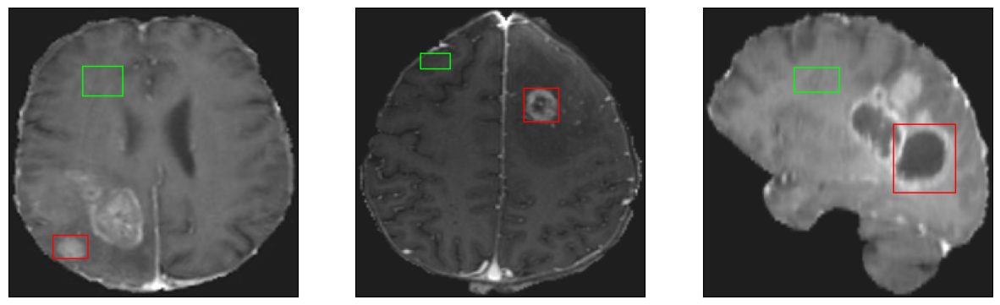

26/26 [==============================] - 18s 237ms/step - loss: 30.0588 - IoU: 0.0821 - val_loss: 37.3145 - val_IoU: 0.0120
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 18.7019 - IoU: 0.1909
Epoch 2: val_IoU improved from 0.01201 to 0.01351, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


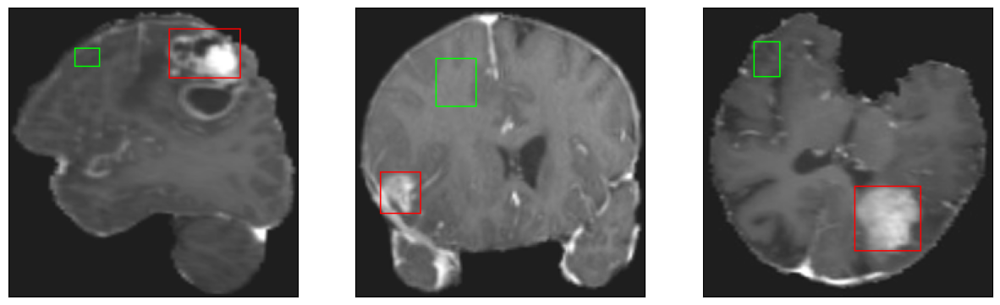

26/26 [==============================] - 2s 91ms/step - loss: 18.6079 - IoU: 0.1926 - val_loss: 34.6285 - val_IoU: 0.0135
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 15.6220 - IoU: 0.2395
Epoch 3: val_IoU did not improve from 0.01351
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4


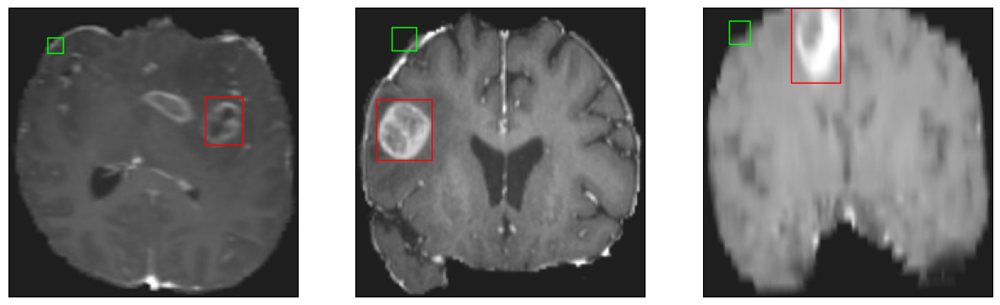

26/26 [==============================] - 2s 86ms/step - loss: 15.6220 - IoU: 0.2395 - val_loss: 49.7766 - val_IoU: 0.0000e+00
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 13.2217 - IoU: 0.3031
Epoch 4: val_IoU did not improve from 0.01351
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


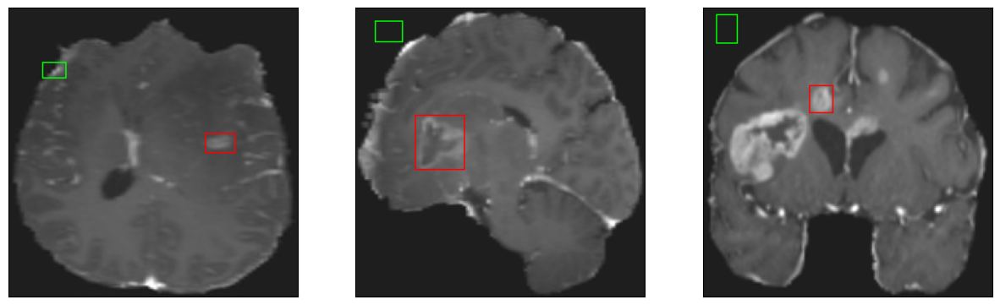

26/26 [==============================] - 2s 75ms/step - loss: 13.2217 - IoU: 0.3031 - val_loss: 46.9026 - val_IoU: 0.0000e+00
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 11.6288 - IoU: 0.3469
Epoch 5: val_IoU did not improve from 0.01351
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


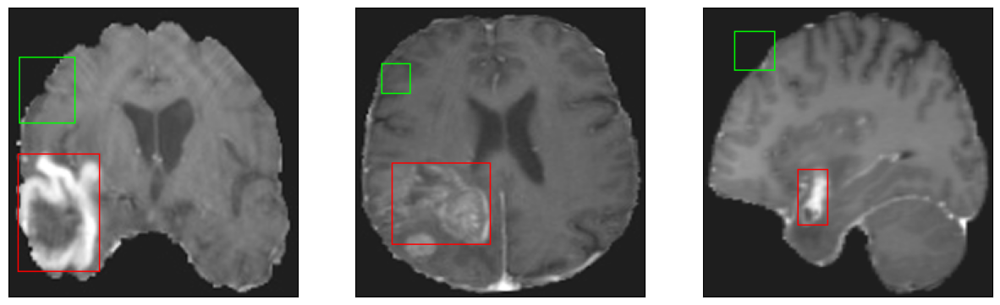

26/26 [==============================] - 2s 95ms/step - loss: 11.6873 - IoU: 0.3453 - val_loss: 40.7655 - val_IoU: 0.0010
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 11.2044 - IoU: 0.3541
Epoch 6: val_IoU improved from 0.01351 to 0.01491, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


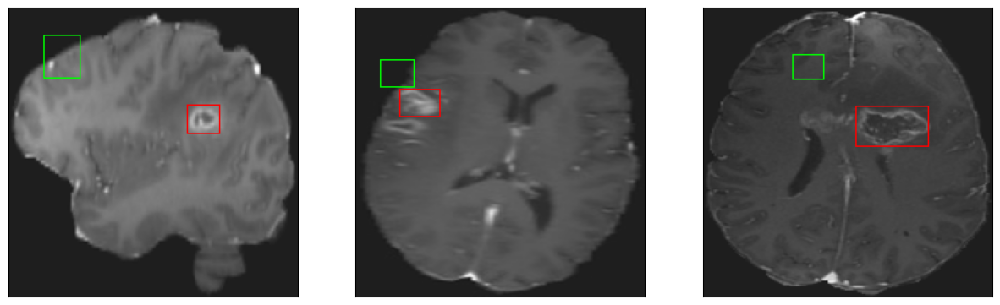

26/26 [==============================] - 3s 103ms/step - loss: 11.2377 - IoU: 0.3526 - val_loss: 33.6827 - val_IoU: 0.0149
Epoch 7/200
25/26 [===========================>..] - ETA: 0s - loss: 10.8591 - IoU: 0.3620
Epoch 7: val_IoU improved from 0.01491 to 0.01681, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


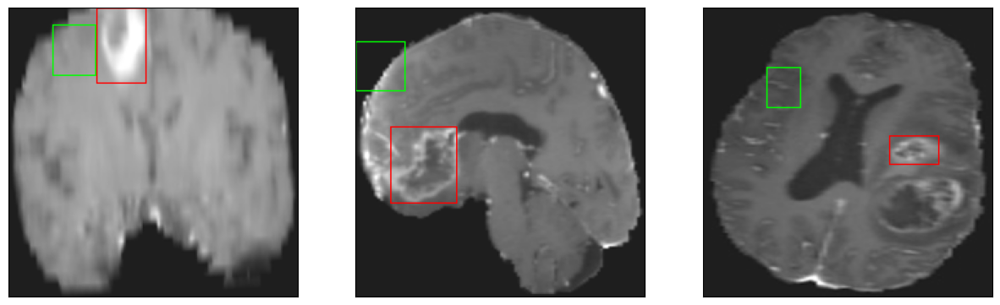

26/26 [==============================] - 3s 97ms/step - loss: 10.8893 - IoU: 0.3613 - val_loss: 33.2292 - val_IoU: 0.0168
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 9.5217 - IoU: 0.4009
Epoch 8: val_IoU improved from 0.01681 to 0.03836, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


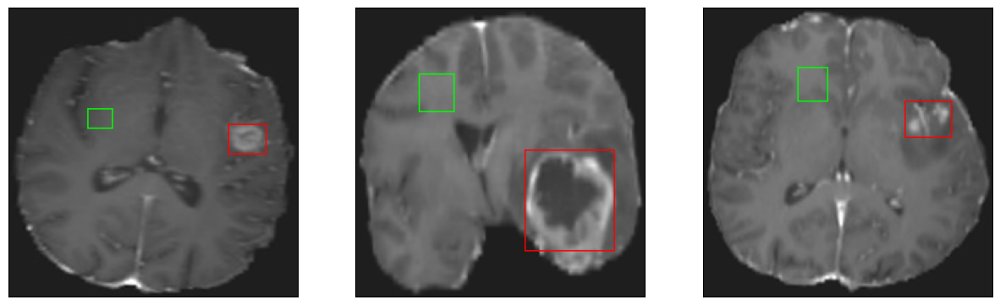

26/26 [==============================] - 5s 208ms/step - loss: 9.5217 - IoU: 0.4009 - val_loss: 28.6943 - val_IoU: 0.0384
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 9.6819 - IoU: 0.3935
Epoch 9: val_IoU improved from 0.03836 to 0.07805, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


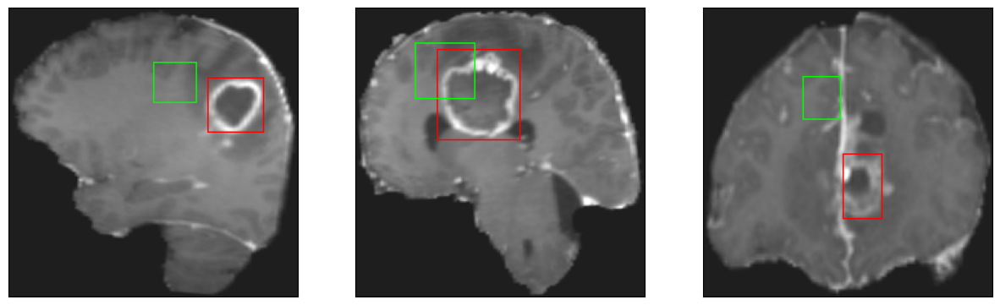

26/26 [==============================] - 3s 100ms/step - loss: 9.7124 - IoU: 0.3931 - val_loss: 24.0507 - val_IoU: 0.0781
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 9.0572 - IoU: 0.4213
Epoch 10: val_IoU did not improve from 0.07805
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


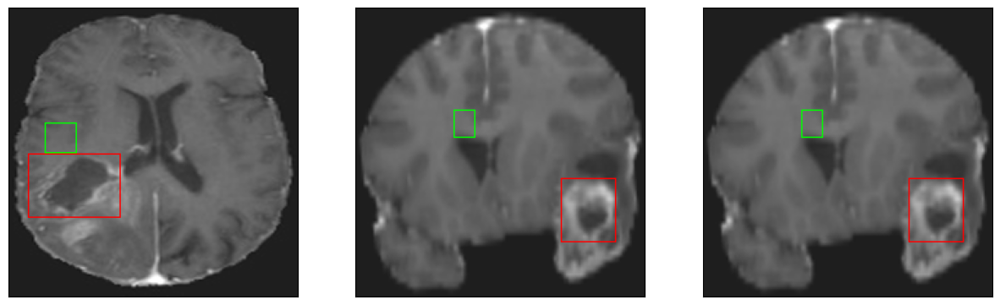

26/26 [==============================] - 2s 85ms/step - loss: 9.0564 - IoU: 0.4217 - val_loss: 30.2772 - val_IoU: 0.0267
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 8.7051 - IoU: 0.4359
Epoch 11: val_IoU did not improve from 0.07805
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


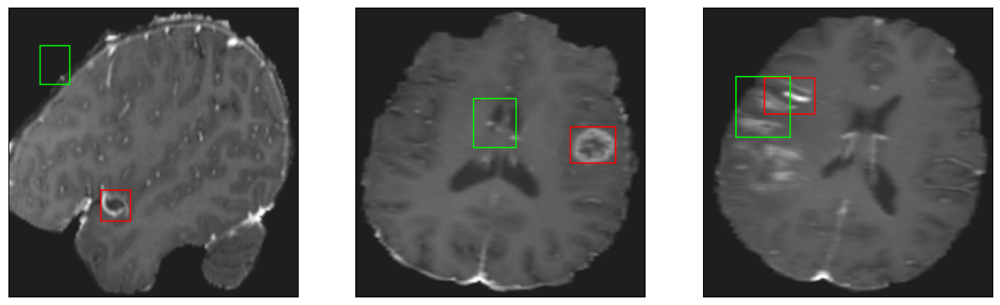

26/26 [==============================] - 3s 115ms/step - loss: 8.7051 - IoU: 0.4359 - val_loss: 25.2918 - val_IoU: 0.0683
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 8.0927 - IoU: 0.4506
Epoch 12: val_IoU improved from 0.07805 to 0.13324, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


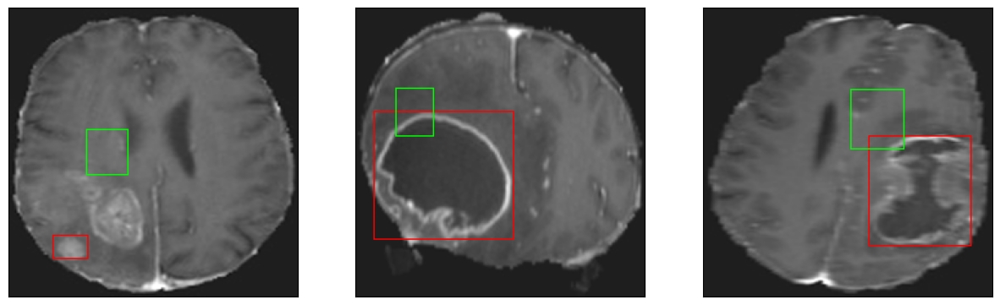

26/26 [==============================] - 3s 109ms/step - loss: 8.0927 - IoU: 0.4506 - val_loss: 20.5414 - val_IoU: 0.1332
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9537 - IoU: 0.4582
Epoch 13: val_IoU improved from 0.13324 to 0.22277, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


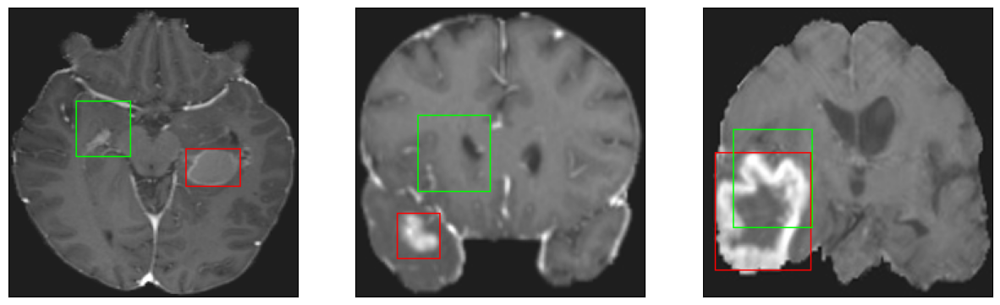

26/26 [==============================] - 3s 103ms/step - loss: 7.9572 - IoU: 0.4587 - val_loss: 16.8919 - val_IoU: 0.2228
Epoch 14/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9650 - IoU: 0.4629
Epoch 14: val_IoU did not improve from 0.22277
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


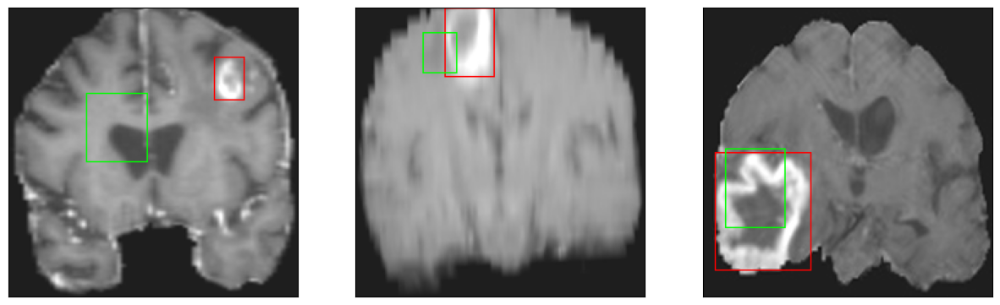

26/26 [==============================] - 2s 88ms/step - loss: 8.0076 - IoU: 0.4600 - val_loss: 18.9484 - val_IoU: 0.1549
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 7.6402 - IoU: 0.4698
Epoch 15: val_IoU improved from 0.22277 to 0.28679, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


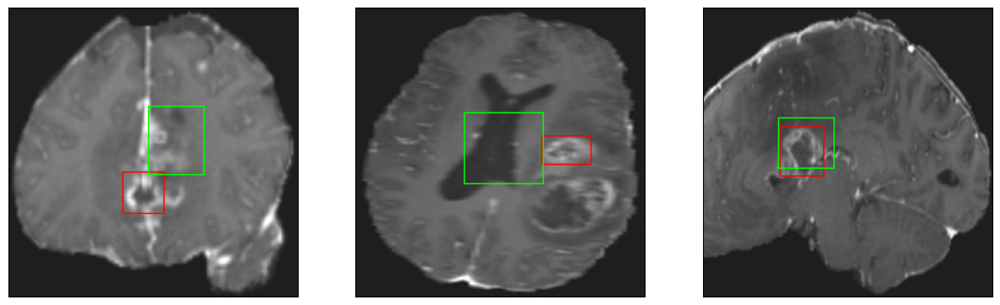

26/26 [==============================] - 3s 123ms/step - loss: 7.6402 - IoU: 0.4698 - val_loss: 15.4418 - val_IoU: 0.2868
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4304 - IoU: 0.4808
Epoch 16: val_IoU did not improve from 0.28679
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


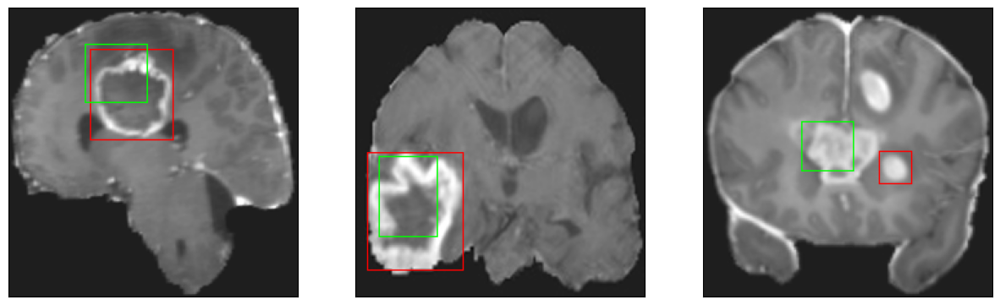

26/26 [==============================] - 3s 111ms/step - loss: 7.5135 - IoU: 0.4774 - val_loss: 15.0661 - val_IoU: 0.2681
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4210 - IoU: 0.4744
Epoch 17: val_IoU did not improve from 0.28679
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


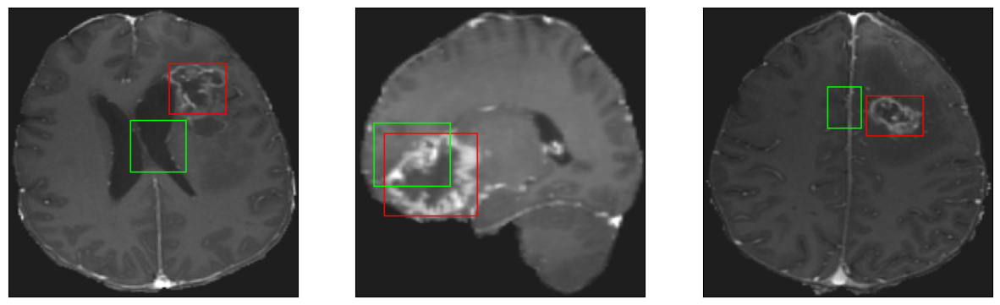

26/26 [==============================] - 2s 89ms/step - loss: 7.4331 - IoU: 0.4729 - val_loss: 15.5139 - val_IoU: 0.2485
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 7.1967 - IoU: 0.4822
Epoch 18: val_IoU improved from 0.28679 to 0.31128, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


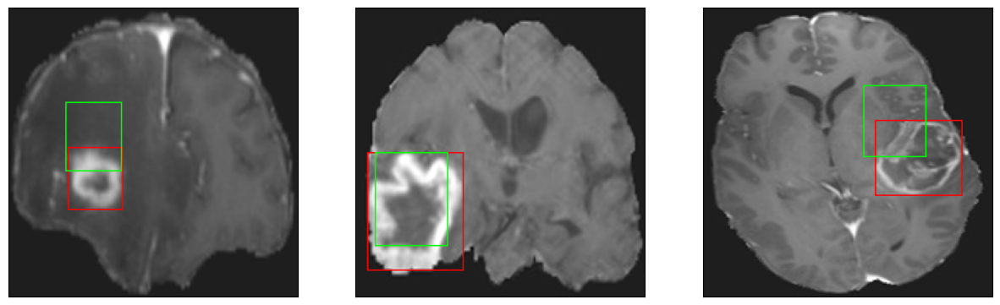

26/26 [==============================] - 3s 108ms/step - loss: 7.1967 - IoU: 0.4822 - val_loss: 14.1009 - val_IoU: 0.3113
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 7.8240 - IoU: 0.4611
Epoch 19: val_IoU did not improve from 0.31128
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


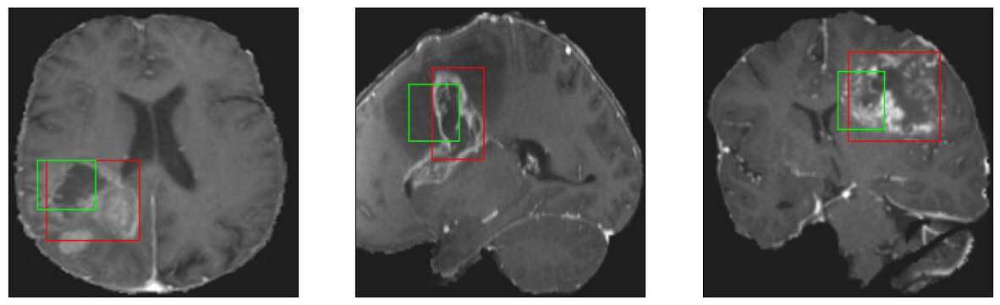

26/26 [==============================] - 2s 84ms/step - loss: 7.8124 - IoU: 0.4619 - val_loss: 15.0280 - val_IoU: 0.2723
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 7.0517 - IoU: 0.4967
Epoch 20: val_IoU improved from 0.31128 to 0.32044, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


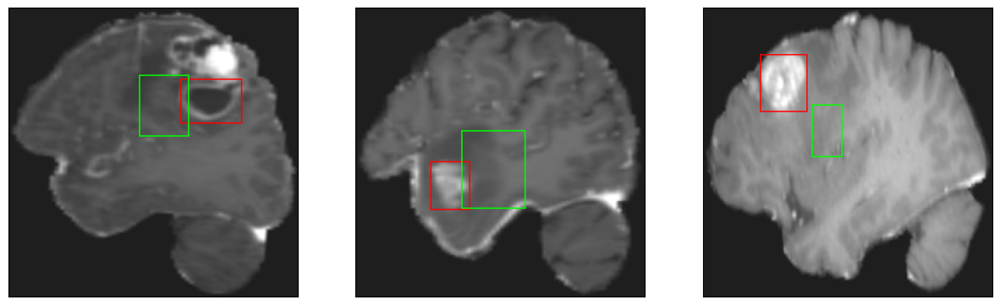

26/26 [==============================] - 3s 113ms/step - loss: 7.0517 - IoU: 0.4967 - val_loss: 13.5215 - val_IoU: 0.3204
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9297 - IoU: 0.4891
Epoch 21: val_IoU improved from 0.32044 to 0.32859, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


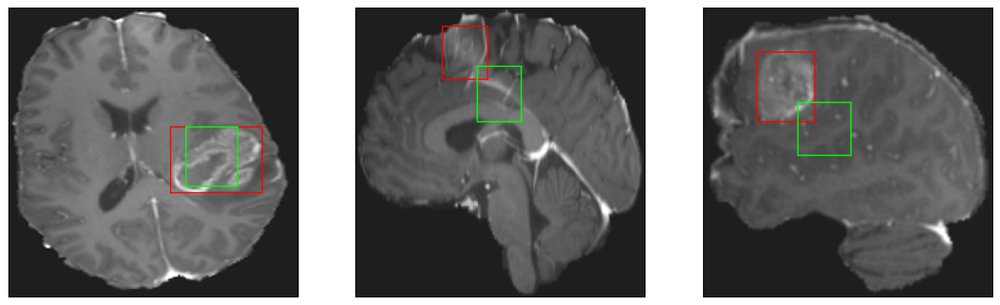

26/26 [==============================] - 4s 141ms/step - loss: 6.9760 - IoU: 0.4893 - val_loss: 13.6611 - val_IoU: 0.3286
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 6.9262 - IoU: 0.4997
Epoch 22: val_IoU did not improve from 0.32859
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


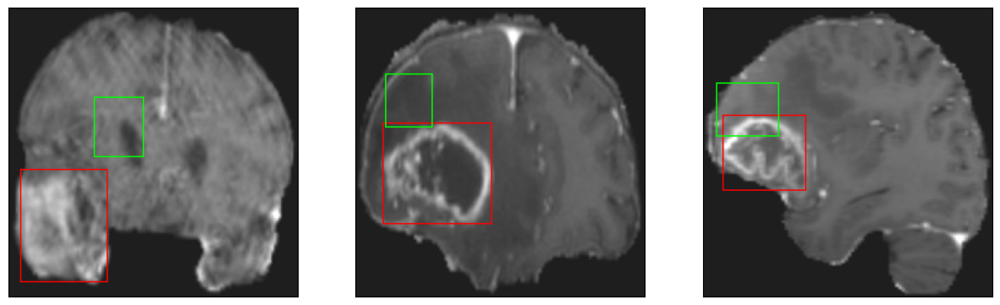

26/26 [==============================] - 3s 98ms/step - loss: 6.9262 - IoU: 0.4997 - val_loss: 18.7412 - val_IoU: 0.1595
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 6.7341 - IoU: 0.5073
Epoch 23: val_IoU did not improve from 0.32859
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


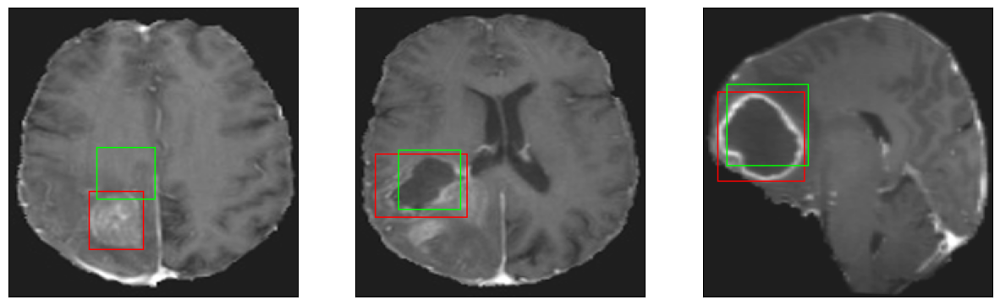

26/26 [==============================] - 2s 94ms/step - loss: 6.7341 - IoU: 0.5073 - val_loss: 15.3854 - val_IoU: 0.3100
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 6.5791 - IoU: 0.5201
Epoch 24: val_IoU did not improve from 0.32859
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


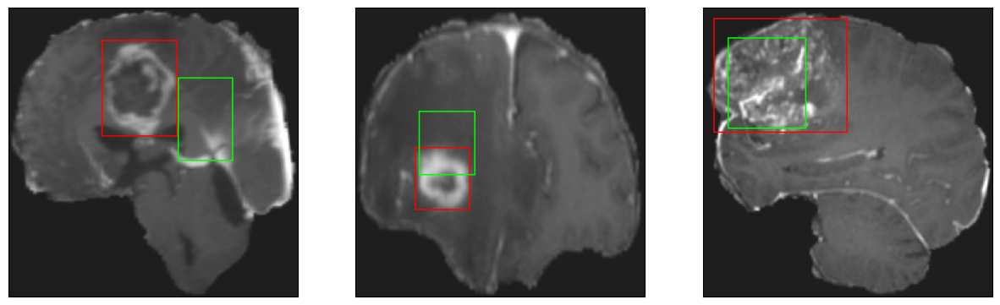

26/26 [==============================] - 2s 93ms/step - loss: 6.5791 - IoU: 0.5201 - val_loss: 13.9488 - val_IoU: 0.3167
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 6.4271 - IoU: 0.5233
Epoch 25: val_IoU did not improve from 0.32859
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


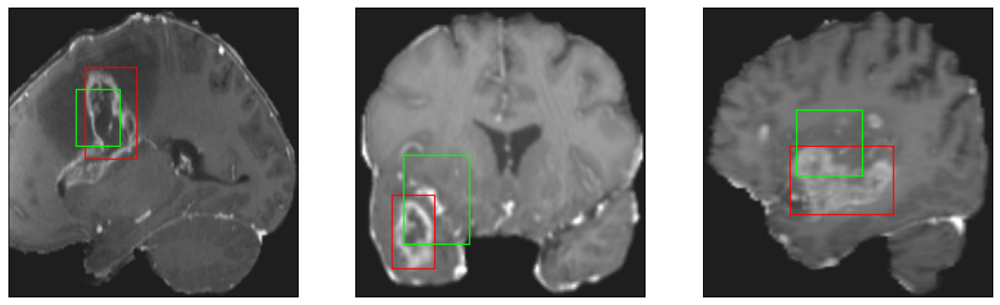

26/26 [==============================] - 2s 85ms/step - loss: 6.4271 - IoU: 0.5233 - val_loss: 15.5932 - val_IoU: 0.2487
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 6.2823 - IoU: 0.5306
Epoch 26: val_IoU improved from 0.32859 to 0.33980, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


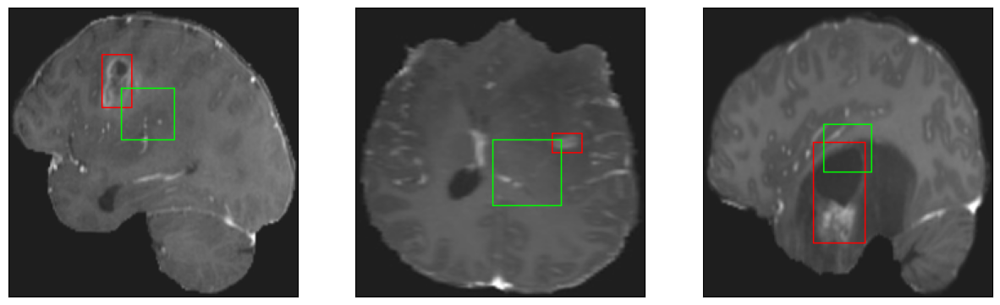

26/26 [==============================] - 4s 149ms/step - loss: 6.2823 - IoU: 0.5306 - val_loss: 13.3682 - val_IoU: 0.3398
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 6.4500 - IoU: 0.5194
Epoch 27: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


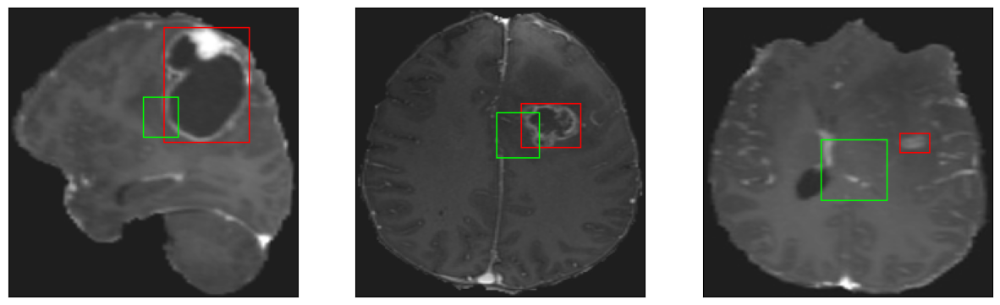

26/26 [==============================] - 2s 89ms/step - loss: 6.4500 - IoU: 0.5194 - val_loss: 14.0536 - val_IoU: 0.3100
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.5394 - IoU: 0.5133
Epoch 28: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


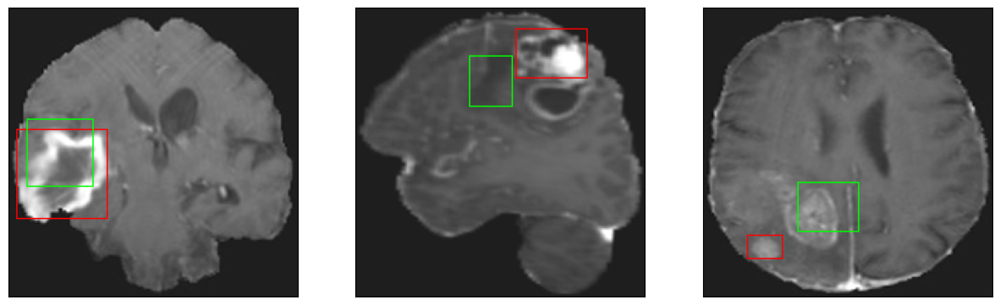

26/26 [==============================] - 2s 85ms/step - loss: 6.5394 - IoU: 0.5133 - val_loss: 13.9491 - val_IoU: 0.3263
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3595 - IoU: 0.5307
Epoch 29: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


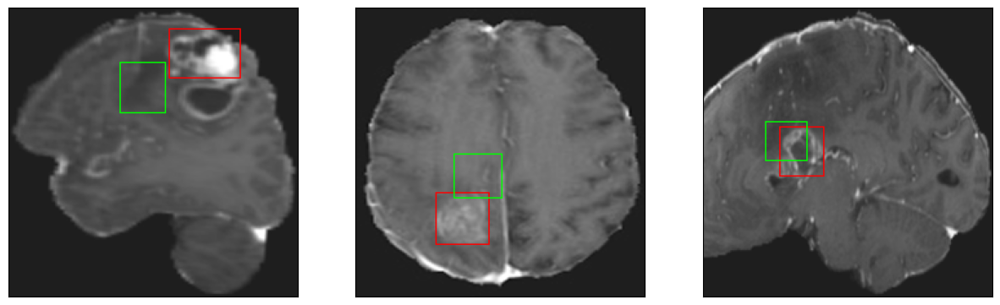

26/26 [==============================] - 2s 83ms/step - loss: 6.3867 - IoU: 0.5303 - val_loss: 14.5628 - val_IoU: 0.2702
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3038 - IoU: 0.5431
Epoch 30: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4


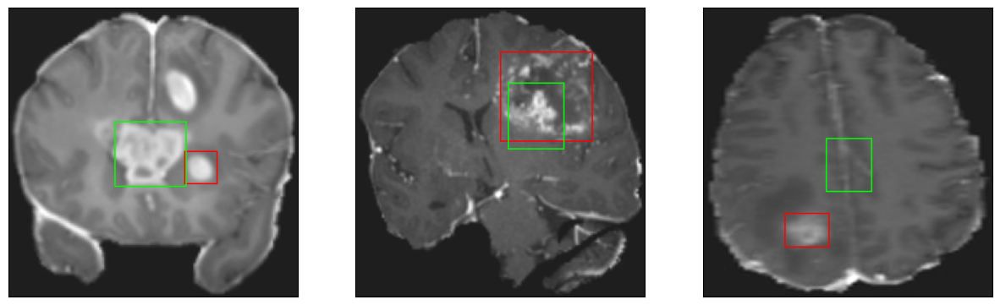

26/26 [==============================] - 3s 104ms/step - loss: 6.3461 - IoU: 0.5390 - val_loss: 13.7261 - val_IoU: 0.3247
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1371 - IoU: 0.5382
Epoch 31: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


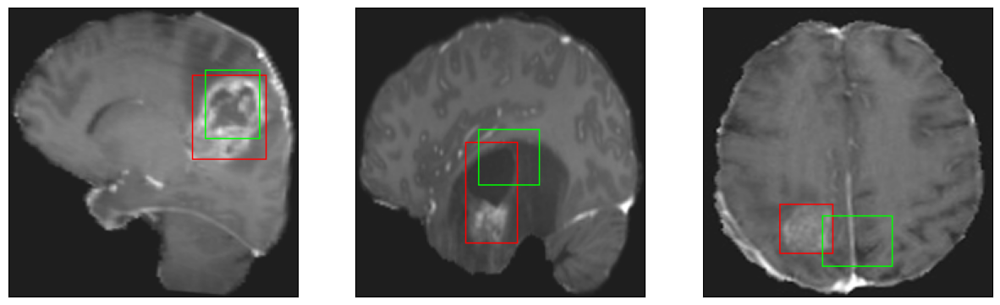

26/26 [==============================] - 2s 94ms/step - loss: 6.1211 - IoU: 0.5391 - val_loss: 13.7745 - val_IoU: 0.3118
Epoch 32/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0825 - IoU: 0.5347
Epoch 32: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


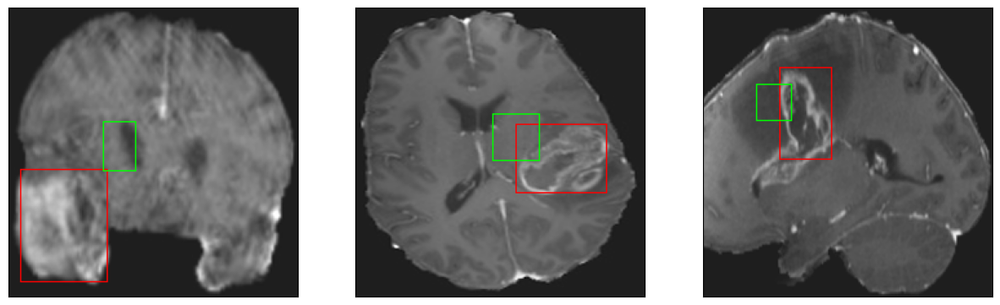

26/26 [==============================] - 2s 94ms/step - loss: 6.1013 - IoU: 0.5348 - val_loss: 19.9615 - val_IoU: 0.1421
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.0725 - IoU: 0.5452
Epoch 33: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


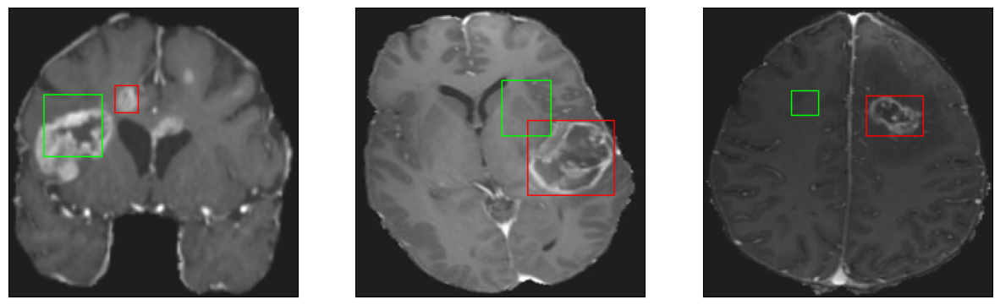

26/26 [==============================] - 3s 105ms/step - loss: 6.0725 - IoU: 0.5452 - val_loss: 16.5795 - val_IoU: 0.2220
Epoch 34/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0534 - IoU: 0.5531
Epoch 34: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


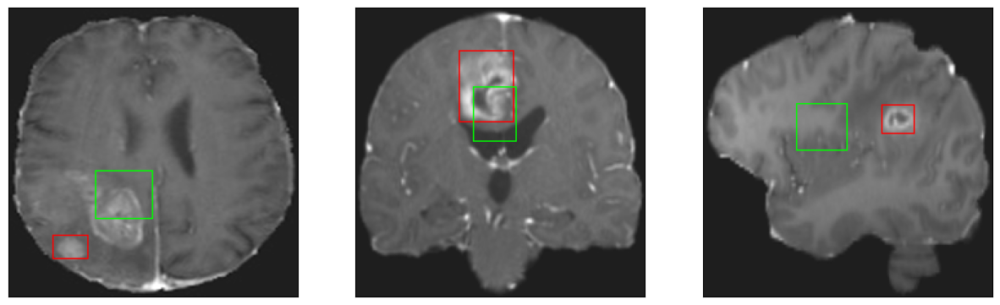

26/26 [==============================] - 3s 100ms/step - loss: 6.0191 - IoU: 0.5554 - val_loss: 14.3193 - val_IoU: 0.3019
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0300 - IoU: 0.5408
Epoch 35: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


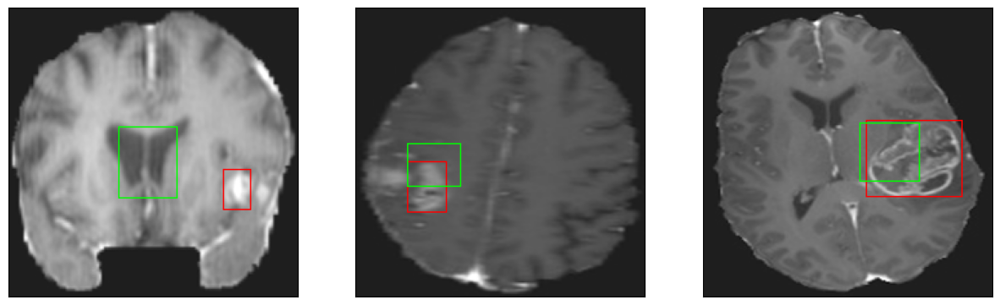

26/26 [==============================] - 3s 127ms/step - loss: 6.0729 - IoU: 0.5394 - val_loss: 14.6906 - val_IoU: 0.2873
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.4135 - IoU: 0.5256
Epoch 36: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


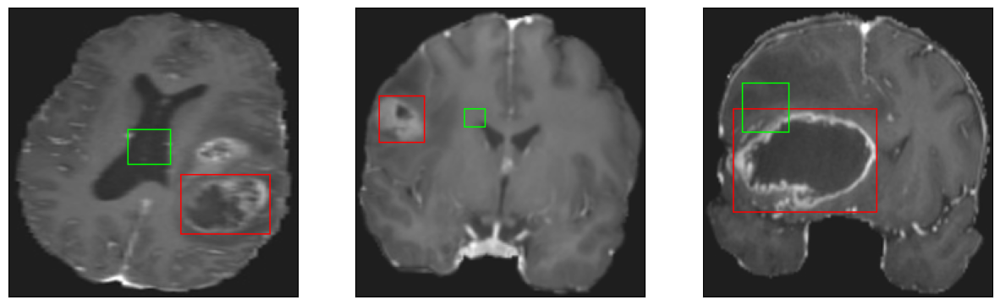

26/26 [==============================] - 3s 99ms/step - loss: 6.4135 - IoU: 0.5256 - val_loss: 22.0296 - val_IoU: 0.1071
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1369 - IoU: 0.5390
Epoch 37: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


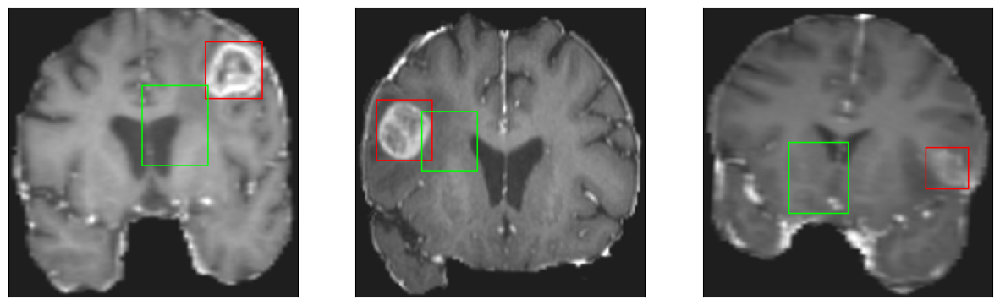

26/26 [==============================] - 2s 92ms/step - loss: 6.1406 - IoU: 0.5361 - val_loss: 14.4938 - val_IoU: 0.2985
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 5.9921 - IoU: 0.5529
Epoch 38: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


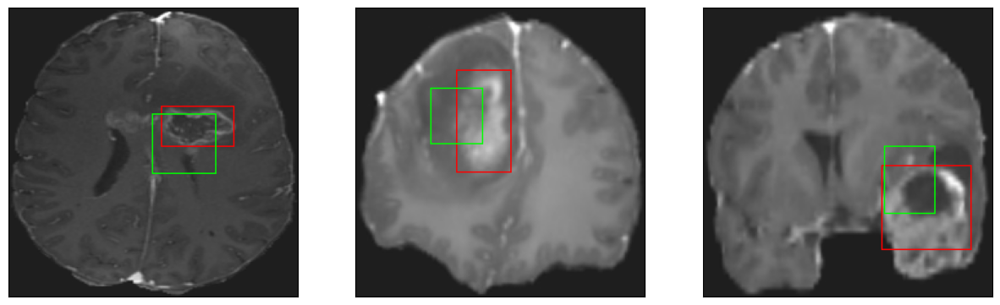

26/26 [==============================] - 3s 111ms/step - loss: 5.9921 - IoU: 0.5529 - val_loss: 13.8589 - val_IoU: 0.3207
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8928 - IoU: 0.5443
Epoch 39: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


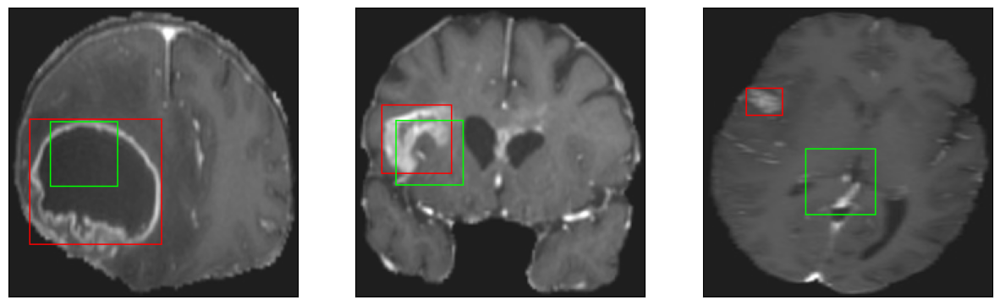

26/26 [==============================] - 3s 103ms/step - loss: 5.8958 - IoU: 0.5460 - val_loss: 13.4992 - val_IoU: 0.3273
Epoch 40/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7313 - IoU: 0.5593
Epoch 40: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


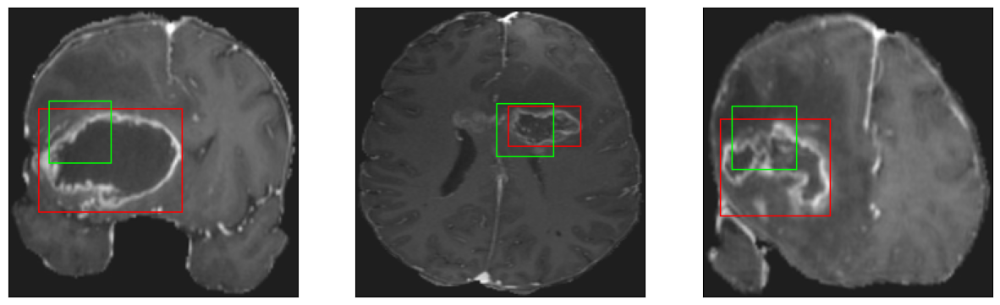

26/26 [==============================] - 3s 115ms/step - loss: 5.7197 - IoU: 0.5587 - val_loss: 13.4575 - val_IoU: 0.3202
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7314 - IoU: 0.5664
Epoch 41: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


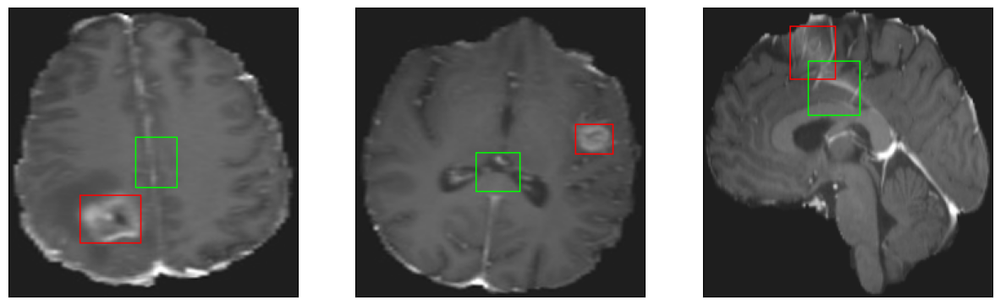

26/26 [==============================] - 2s 95ms/step - loss: 5.6948 - IoU: 0.5679 - val_loss: 14.7060 - val_IoU: 0.3027
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.6994 - IoU: 0.5622
Epoch 42: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


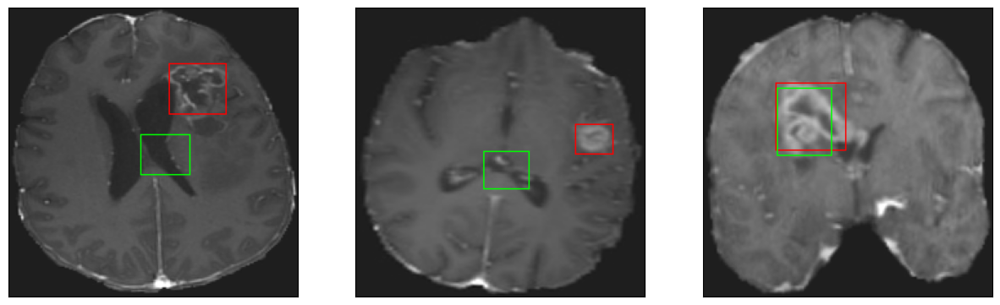

26/26 [==============================] - 3s 103ms/step - loss: 5.6994 - IoU: 0.5622 - val_loss: 13.2220 - val_IoU: 0.3330
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4575 - IoU: 0.5766
Epoch 43: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


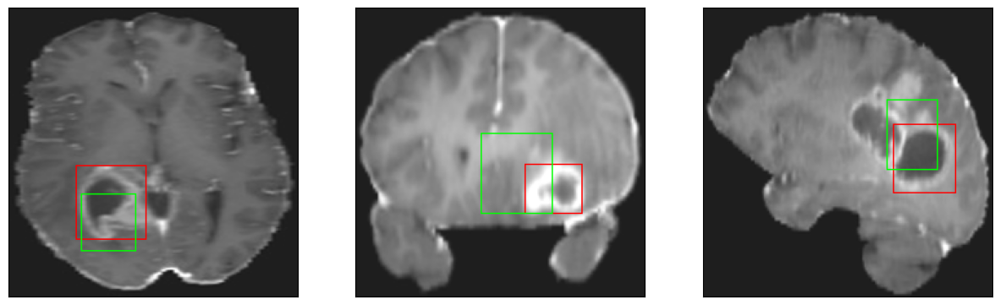

26/26 [==============================] - 2s 86ms/step - loss: 5.4757 - IoU: 0.5778 - val_loss: 13.4661 - val_IoU: 0.3113
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 5.8446 - IoU: 0.5513
Epoch 44: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


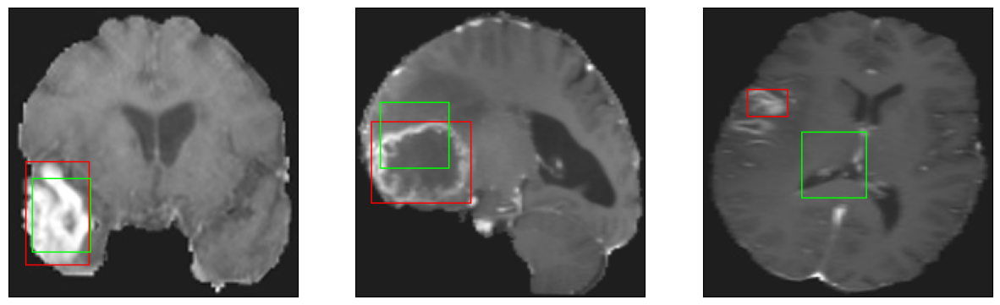

26/26 [==============================] - 2s 92ms/step - loss: 5.8446 - IoU: 0.5513 - val_loss: 13.8213 - val_IoU: 0.3314
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 5.4511 - IoU: 0.5739
Epoch 45: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


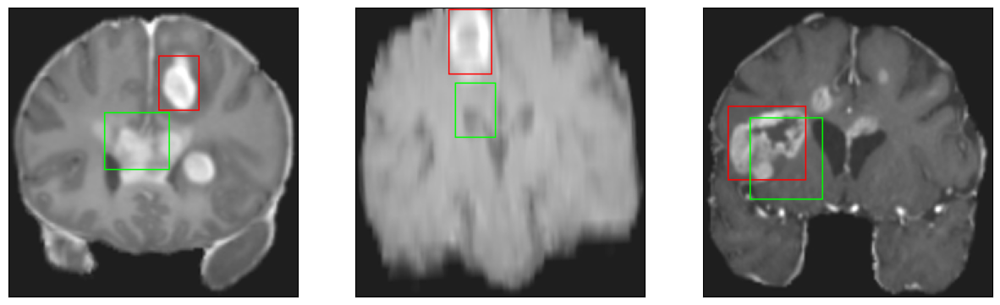

26/26 [==============================] - 3s 117ms/step - loss: 5.4511 - IoU: 0.5739 - val_loss: 13.2144 - val_IoU: 0.3396
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 5.5066 - IoU: 0.5758
Epoch 46: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


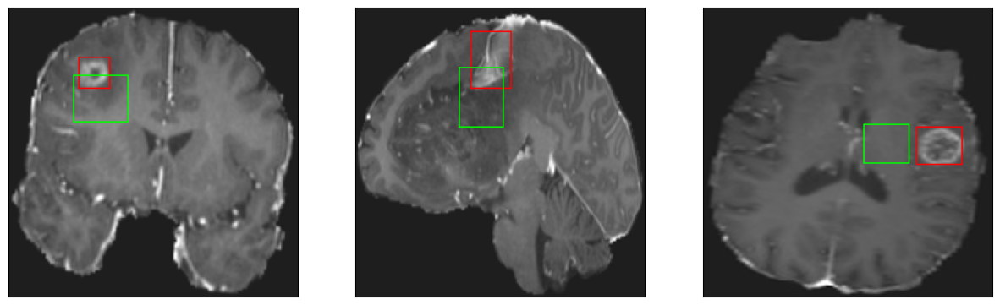

26/26 [==============================] - 3s 108ms/step - loss: 5.5066 - IoU: 0.5758 - val_loss: 17.4811 - val_IoU: 0.2016
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6575 - IoU: 0.5600
Epoch 47: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


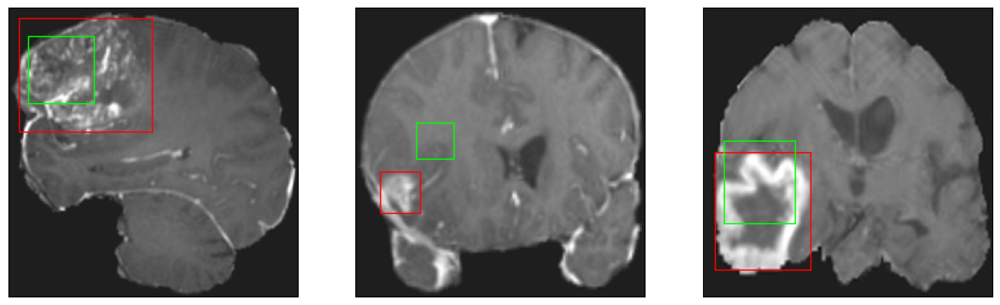

26/26 [==============================] - 2s 90ms/step - loss: 5.6436 - IoU: 0.5619 - val_loss: 17.6304 - val_IoU: 0.1812
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4602 - IoU: 0.5806
Epoch 48: val_IoU did not improve from 0.33980
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


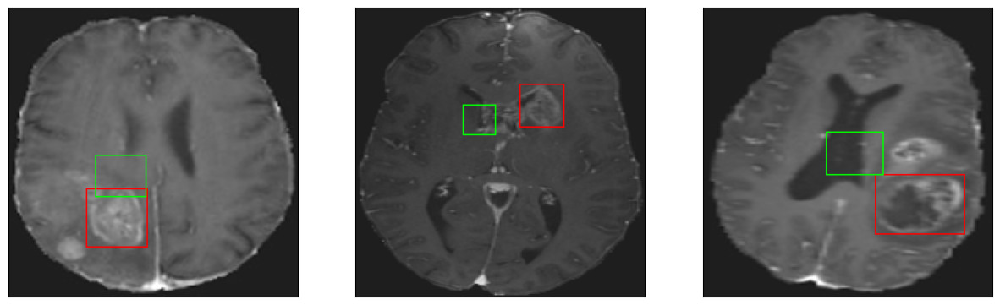

26/26 [==============================] - 2s 88ms/step - loss: 5.4007 - IoU: 0.5837 - val_loss: 17.3406 - val_IoU: 0.1833
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4285 - IoU: 0.5867
Epoch 49: val_IoU improved from 0.33980 to 0.34578, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


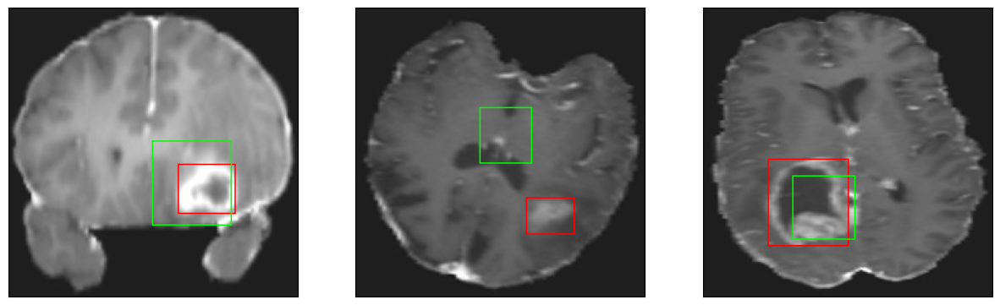

26/26 [==============================] - 4s 149ms/step - loss: 5.4850 - IoU: 0.5839 - val_loss: 13.2339 - val_IoU: 0.3458
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 5.2289 - IoU: 0.5876
Epoch 50: val_IoU improved from 0.34578 to 0.35371, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


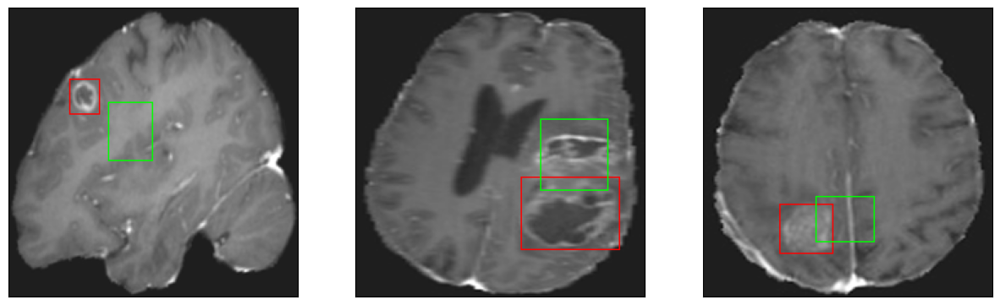

26/26 [==============================] - 4s 138ms/step - loss: 5.2289 - IoU: 0.5876 - val_loss: 12.8078 - val_IoU: 0.3537
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4099 - IoU: 0.5821
Epoch 51: val_IoU did not improve from 0.35371
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


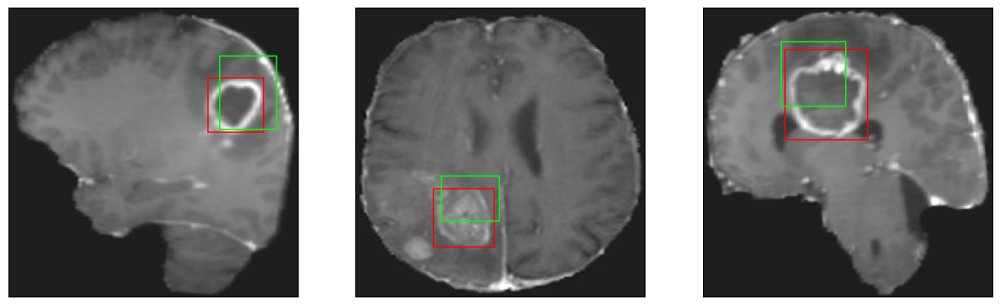

26/26 [==============================] - 2s 91ms/step - loss: 5.4152 - IoU: 0.5815 - val_loss: 13.2306 - val_IoU: 0.3351
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 5.3534 - IoU: 0.5836
Epoch 52: val_IoU did not improve from 0.35371
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


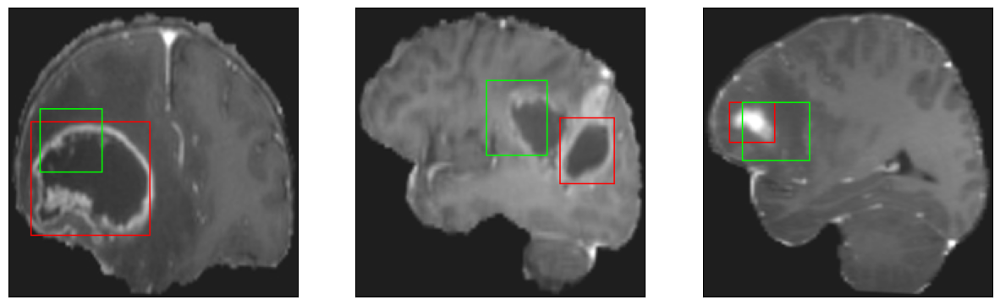

26/26 [==============================] - 2s 95ms/step - loss: 5.3534 - IoU: 0.5836 - val_loss: 13.7000 - val_IoU: 0.3101
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3299 - IoU: 0.5835
Epoch 53: val_IoU improved from 0.35371 to 0.36238, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


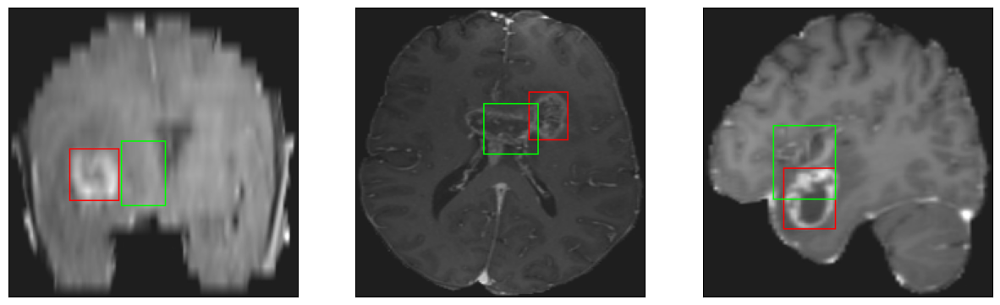

26/26 [==============================] - 3s 109ms/step - loss: 5.3687 - IoU: 0.5831 - val_loss: 13.0075 - val_IoU: 0.3624
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.3198 - IoU: 0.5861
Epoch 54: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


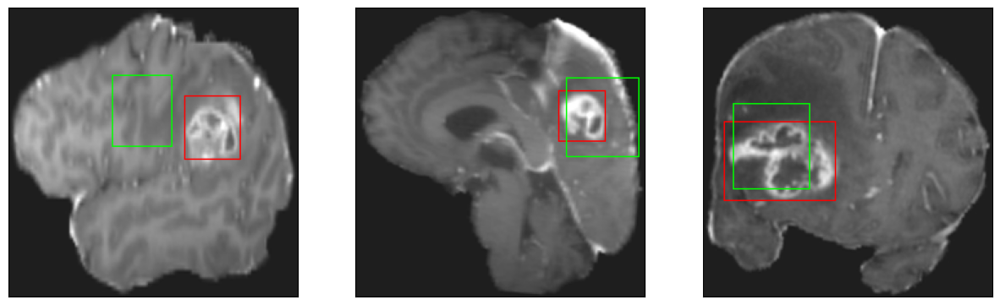

26/26 [==============================] - 3s 107ms/step - loss: 5.3198 - IoU: 0.5861 - val_loss: 13.3628 - val_IoU: 0.3527
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5916 - IoU: 0.5631
Epoch 55: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


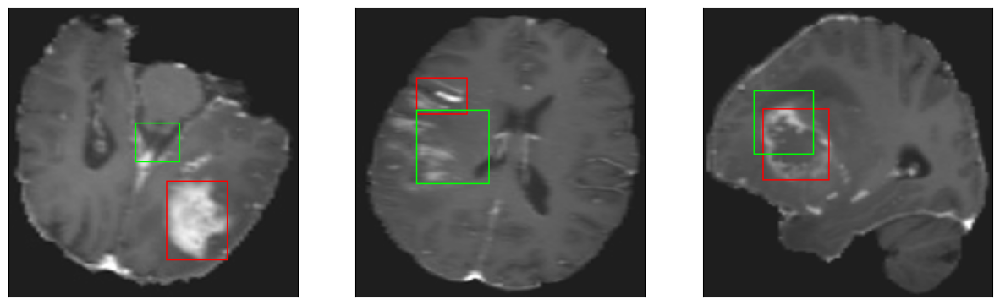

26/26 [==============================] - 3s 107ms/step - loss: 5.5649 - IoU: 0.5640 - val_loss: 13.6820 - val_IoU: 0.3301
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 5.3744 - IoU: 0.5847
Epoch 56: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


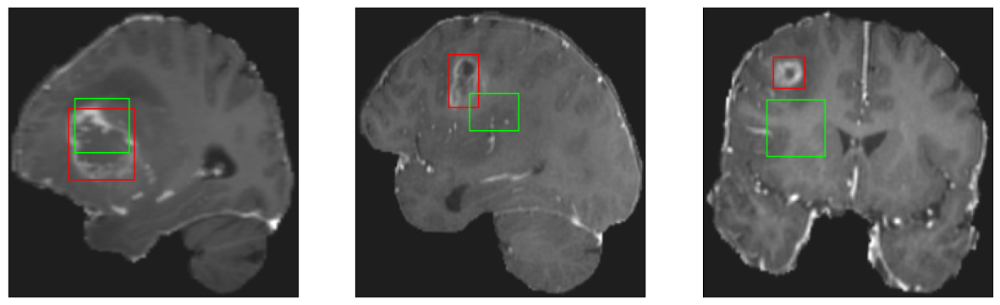

26/26 [==============================] - 2s 94ms/step - loss: 5.3744 - IoU: 0.5847 - val_loss: 12.6933 - val_IoU: 0.3529
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 5.1050 - IoU: 0.5944
Epoch 57: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


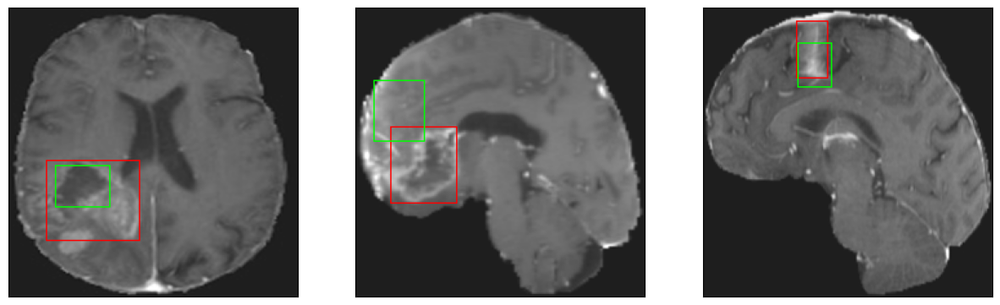

26/26 [==============================] - 2s 91ms/step - loss: 5.1050 - IoU: 0.5944 - val_loss: 16.4384 - val_IoU: 0.2127
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.3345 - IoU: 0.5851
Epoch 58: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


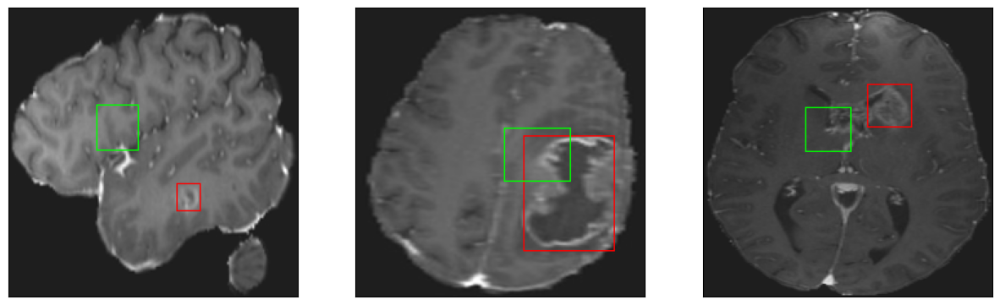

26/26 [==============================] - 3s 104ms/step - loss: 5.3345 - IoU: 0.5851 - val_loss: 14.0554 - val_IoU: 0.3043
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 5.3100 - IoU: 0.5833
Epoch 59: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


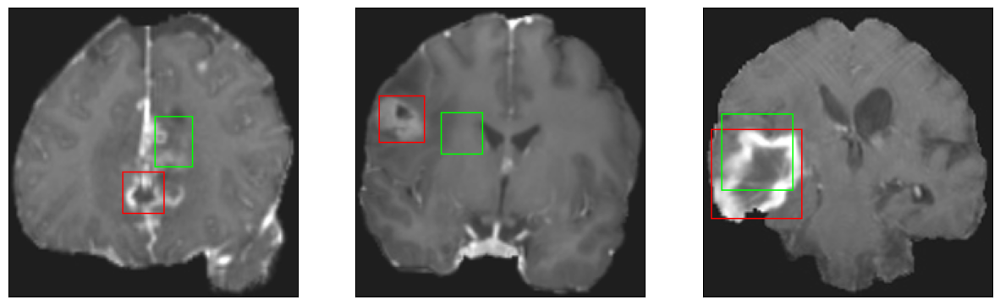

26/26 [==============================] - 3s 106ms/step - loss: 5.3100 - IoU: 0.5833 - val_loss: 14.4298 - val_IoU: 0.2924
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1519 - IoU: 0.5924
Epoch 60: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


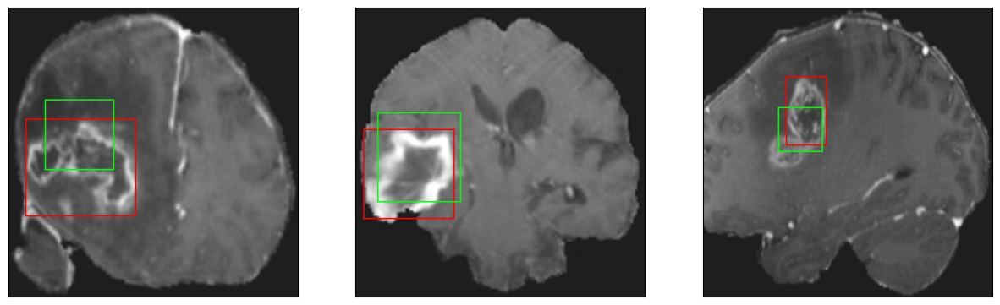

26/26 [==============================] - 2s 94ms/step - loss: 5.1527 - IoU: 0.5917 - val_loss: 14.8264 - val_IoU: 0.3068
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.0493 - IoU: 0.5939
Epoch 61: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


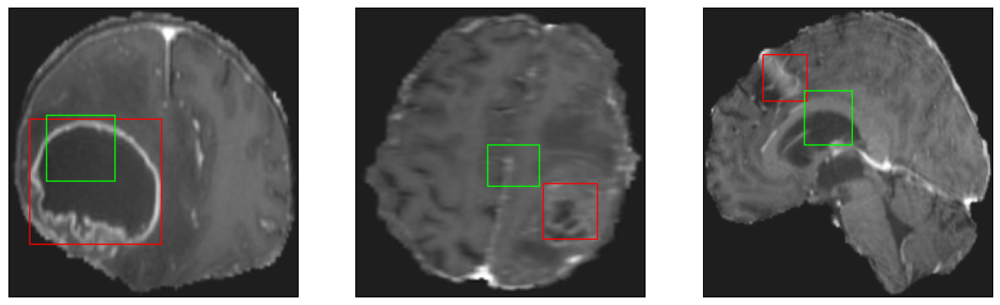

26/26 [==============================] - 3s 120ms/step - loss: 5.0493 - IoU: 0.5939 - val_loss: 13.1043 - val_IoU: 0.3403
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3883 - IoU: 0.5763
Epoch 62: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


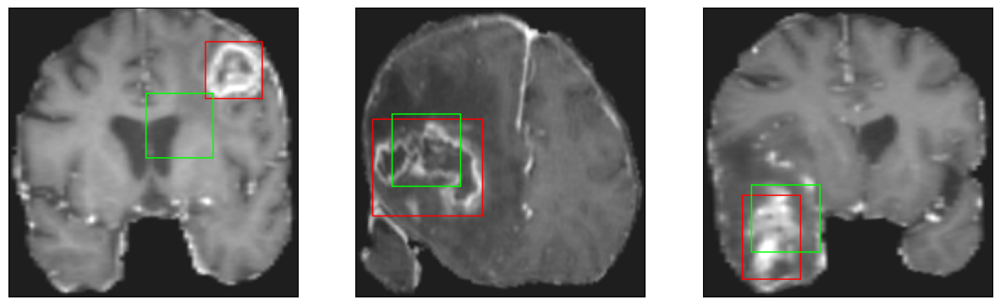

26/26 [==============================] - 3s 105ms/step - loss: 5.3613 - IoU: 0.5799 - val_loss: 13.0042 - val_IoU: 0.3341
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.4447 - IoU: 0.5761
Epoch 63: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


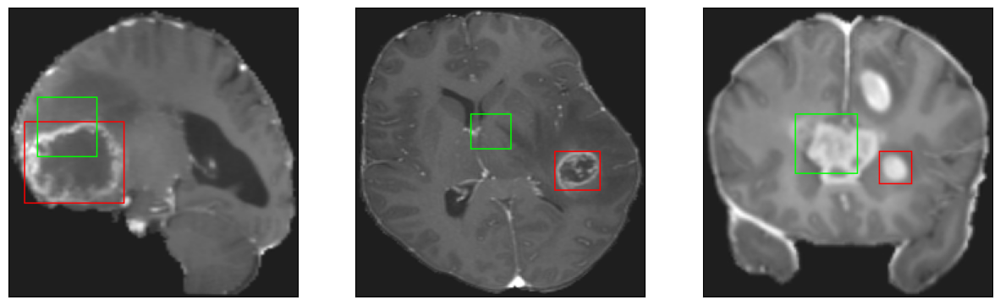

26/26 [==============================] - 3s 111ms/step - loss: 5.4447 - IoU: 0.5761 - val_loss: 14.6682 - val_IoU: 0.2823
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1502 - IoU: 0.5986
Epoch 64: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


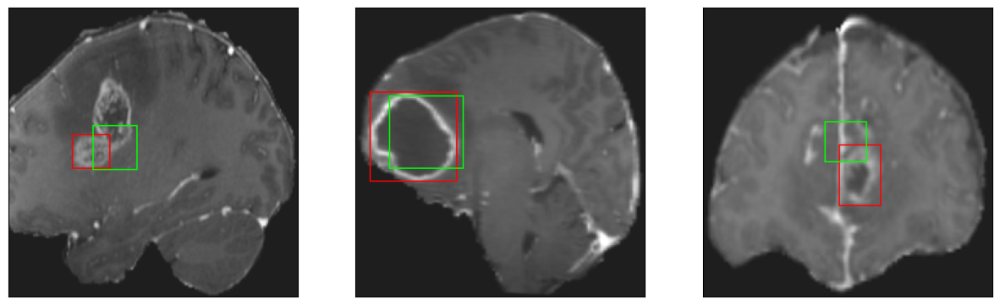

26/26 [==============================] - 3s 112ms/step - loss: 5.1504 - IoU: 0.5975 - val_loss: 13.1772 - val_IoU: 0.3465
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2944 - IoU: 0.5944
Epoch 65: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


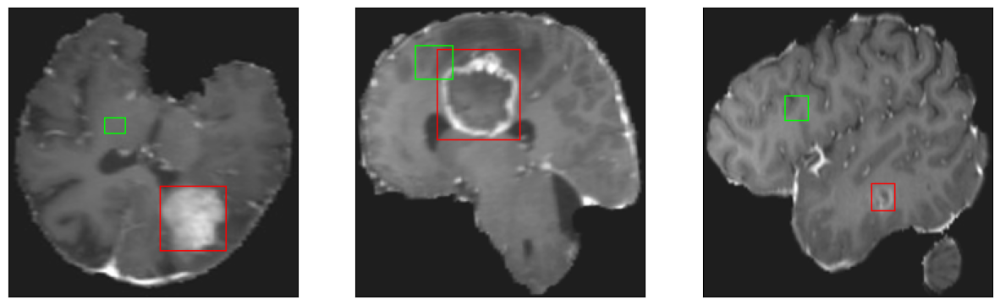

26/26 [==============================] - 2s 88ms/step - loss: 5.2403 - IoU: 0.5964 - val_loss: 24.2875 - val_IoU: 0.0814
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2032 - IoU: 0.5933
Epoch 66: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


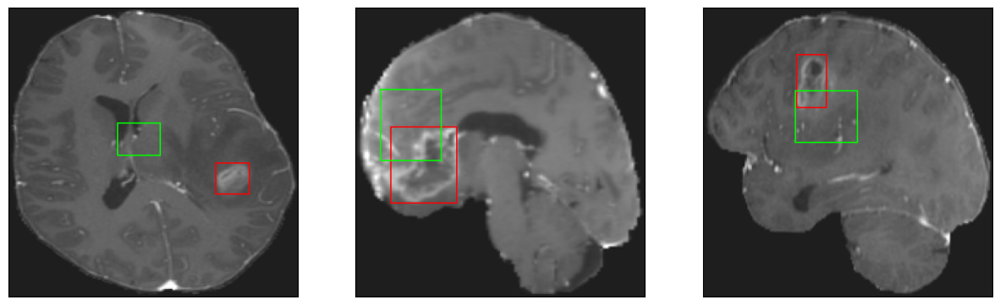

26/26 [==============================] - 2s 93ms/step - loss: 5.2451 - IoU: 0.5890 - val_loss: 13.7190 - val_IoU: 0.3314
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 5.3984 - IoU: 0.5827
Epoch 67: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


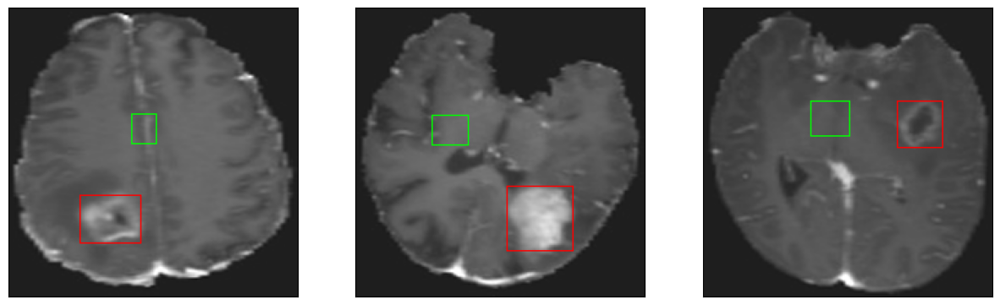

26/26 [==============================] - 3s 107ms/step - loss: 5.3984 - IoU: 0.5827 - val_loss: 17.7405 - val_IoU: 0.1772
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 5.1532 - IoU: 0.5939
Epoch 68: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


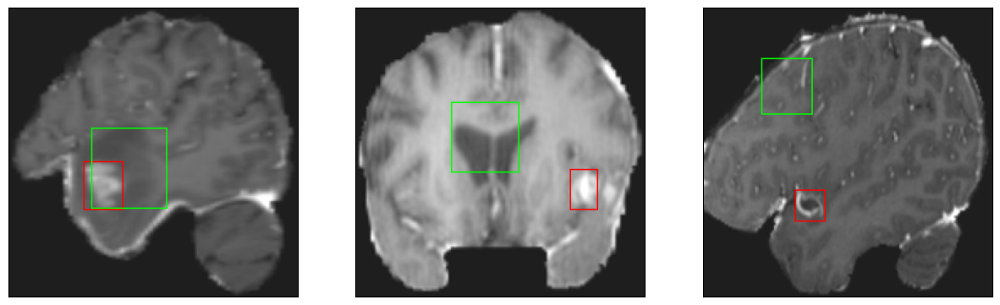

26/26 [==============================] - 4s 142ms/step - loss: 5.1532 - IoU: 0.5939 - val_loss: 14.8316 - val_IoU: 0.2876
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 4.8417 - IoU: 0.6179
Epoch 69: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


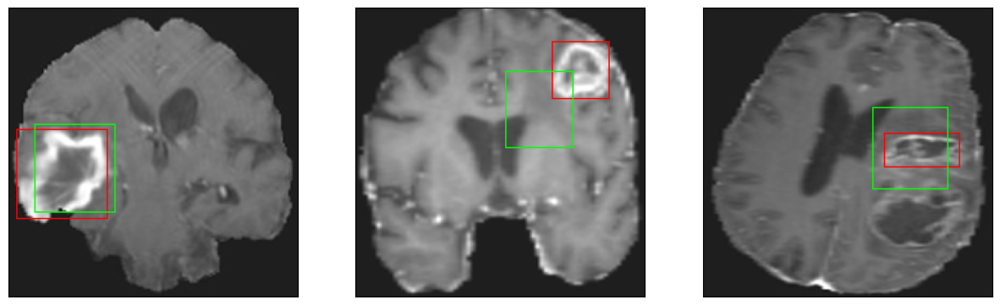

26/26 [==============================] - 2s 91ms/step - loss: 4.8417 - IoU: 0.6179 - val_loss: 13.6414 - val_IoU: 0.3392
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6967 - IoU: 0.6261
Epoch 70: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


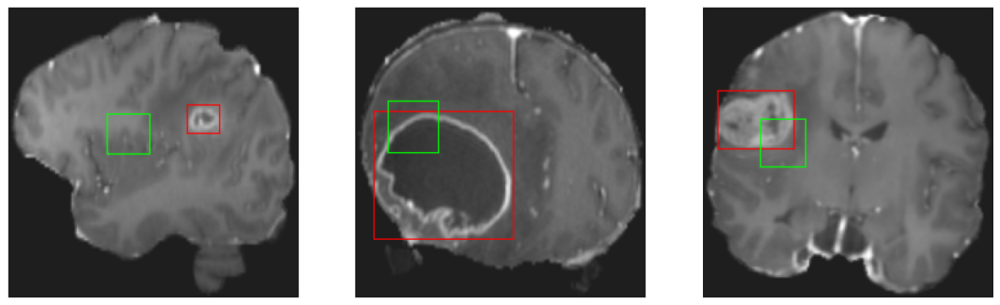

26/26 [==============================] - 3s 98ms/step - loss: 4.6672 - IoU: 0.6263 - val_loss: 15.7776 - val_IoU: 0.2381
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9251 - IoU: 0.6129
Epoch 71: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


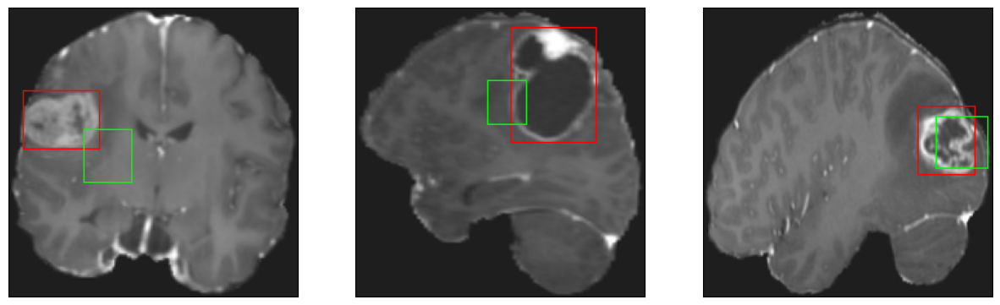

26/26 [==============================] - 2s 93ms/step - loss: 4.9364 - IoU: 0.6114 - val_loss: 13.1286 - val_IoU: 0.3346
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 4.9132 - IoU: 0.6012
Epoch 72: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


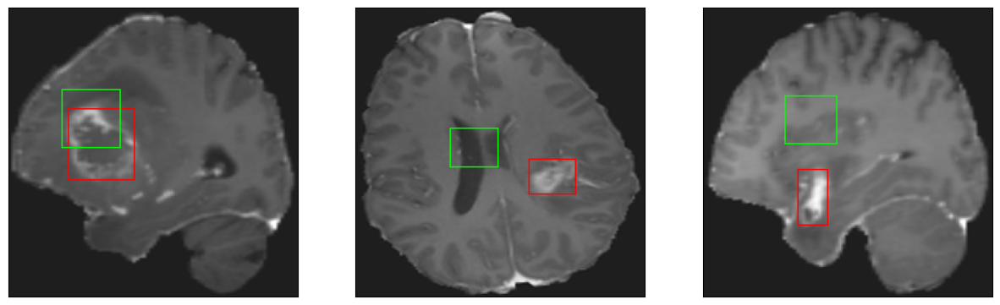

26/26 [==============================] - 3s 105ms/step - loss: 4.9132 - IoU: 0.6012 - val_loss: 14.3549 - val_IoU: 0.2917
Epoch 73/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8573 - IoU: 0.6126
Epoch 73: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


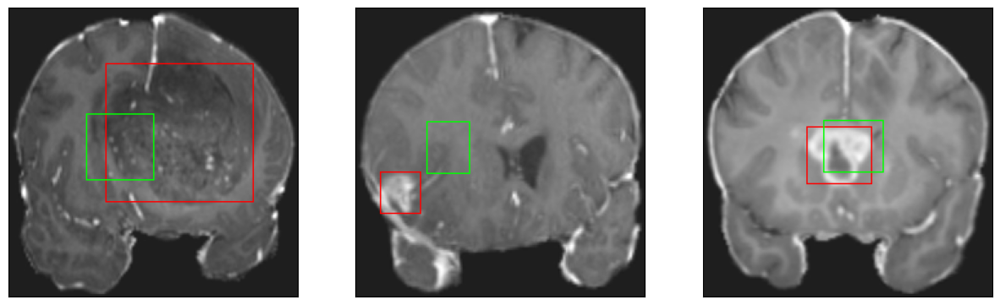

26/26 [==============================] - 2s 92ms/step - loss: 4.9037 - IoU: 0.6120 - val_loss: 14.1273 - val_IoU: 0.2943
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8081 - IoU: 0.6086
Epoch 74: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


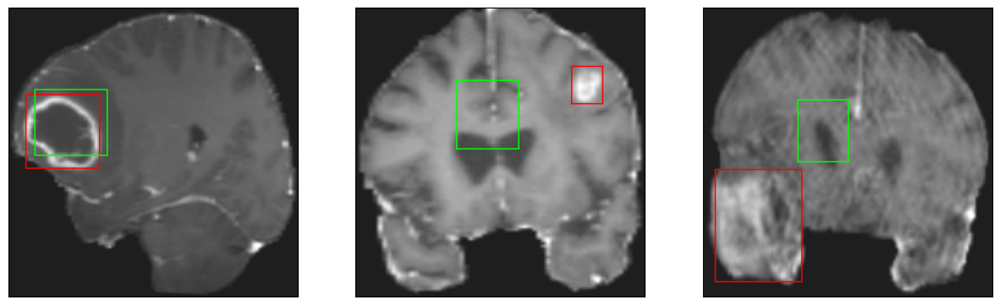

26/26 [==============================] - 3s 97ms/step - loss: 4.7764 - IoU: 0.6106 - val_loss: 15.8909 - val_IoU: 0.2442
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 4.9263 - IoU: 0.6066
Epoch 75: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


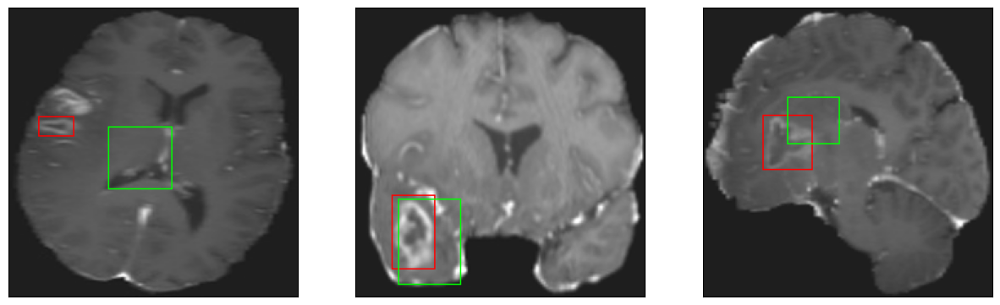

26/26 [==============================] - 3s 112ms/step - loss: 4.9263 - IoU: 0.6066 - val_loss: 13.0600 - val_IoU: 0.3599
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6835 - IoU: 0.6222
Epoch 76: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


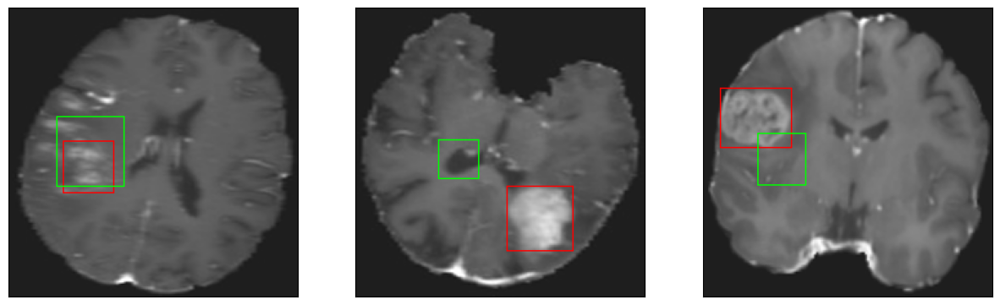

26/26 [==============================] - 2s 88ms/step - loss: 4.7092 - IoU: 0.6213 - val_loss: 12.7375 - val_IoU: 0.3556
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 4.8013 - IoU: 0.6168
Epoch 77: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


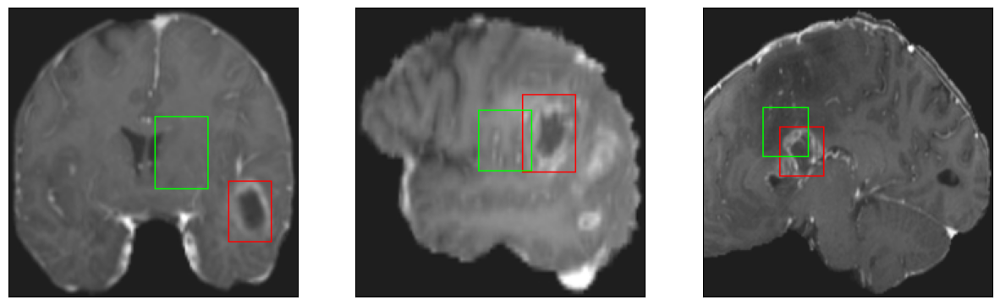

26/26 [==============================] - 3s 120ms/step - loss: 4.8013 - IoU: 0.6168 - val_loss: 13.2486 - val_IoU: 0.3347
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6532 - IoU: 0.6246
Epoch 78: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


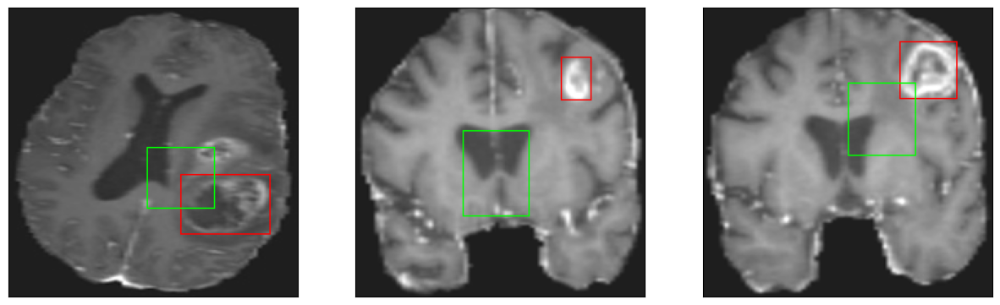

26/26 [==============================] - 3s 99ms/step - loss: 4.6814 - IoU: 0.6232 - val_loss: 13.5583 - val_IoU: 0.2982
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 4.7058 - IoU: 0.6307
Epoch 79: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


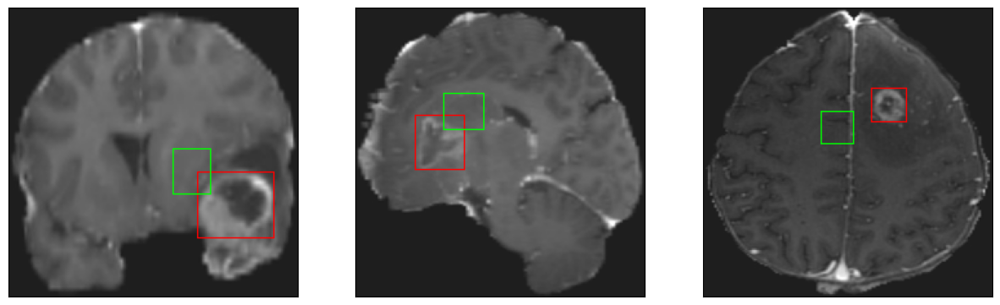

26/26 [==============================] - 3s 98ms/step - loss: 4.7058 - IoU: 0.6307 - val_loss: 14.7415 - val_IoU: 0.2813
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 4.5123 - IoU: 0.6382
Epoch 80: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


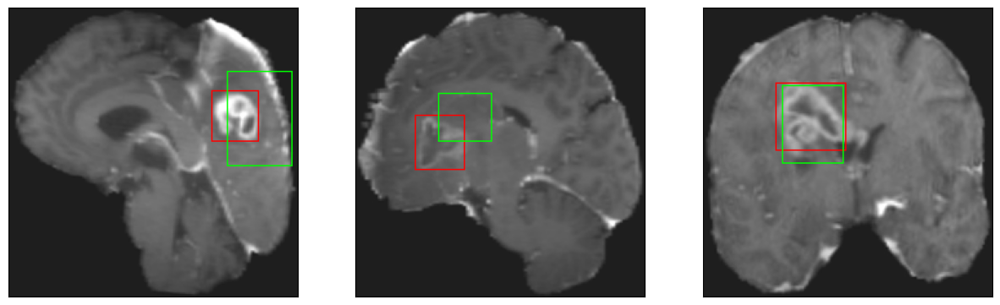

26/26 [==============================] - 2s 91ms/step - loss: 4.5123 - IoU: 0.6382 - val_loss: 13.6207 - val_IoU: 0.3394
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5836 - IoU: 0.6280
Epoch 81: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


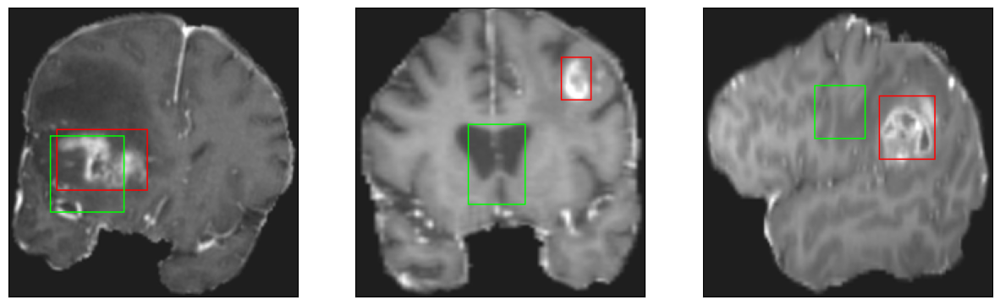

26/26 [==============================] - 3s 114ms/step - loss: 4.5760 - IoU: 0.6290 - val_loss: 12.6548 - val_IoU: 0.3526
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 4.7359 - IoU: 0.6219
Epoch 82: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


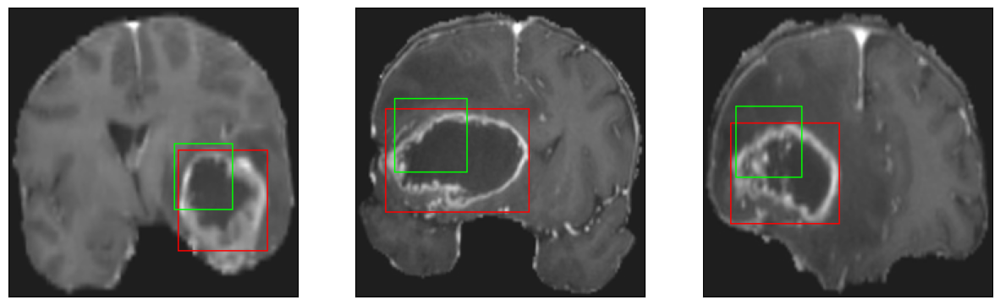

26/26 [==============================] - 3s 104ms/step - loss: 4.7359 - IoU: 0.6219 - val_loss: 13.5678 - val_IoU: 0.3356
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8198 - IoU: 0.6147
Epoch 83: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


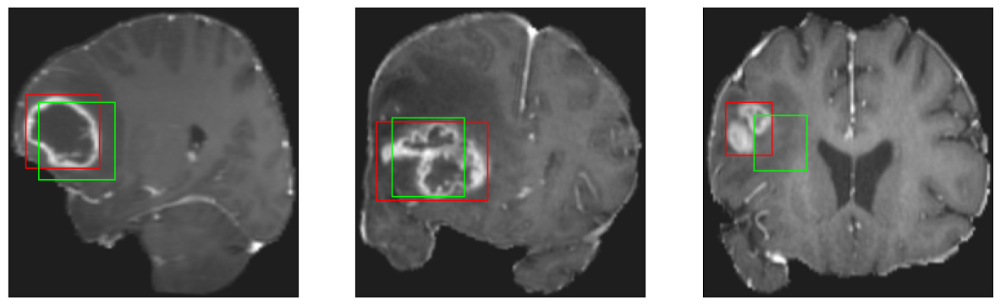

26/26 [==============================] - 3s 101ms/step - loss: 4.7901 - IoU: 0.6165 - val_loss: 13.4621 - val_IoU: 0.3207
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5506 - IoU: 0.6371
Epoch 84: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


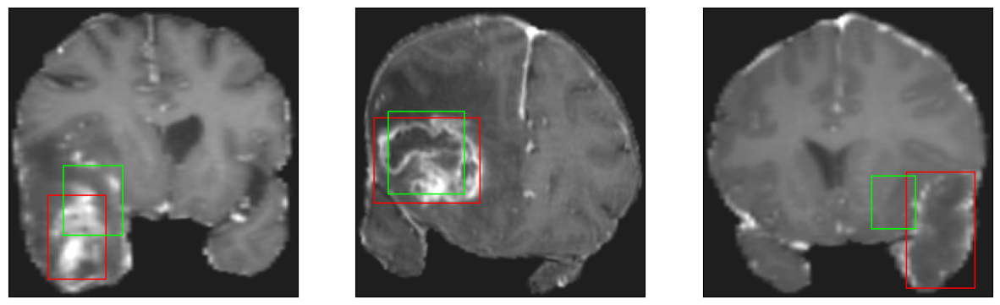

26/26 [==============================] - 3s 115ms/step - loss: 4.5980 - IoU: 0.6331 - val_loss: 13.2377 - val_IoU: 0.3294
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7427 - IoU: 0.6222
Epoch 85: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


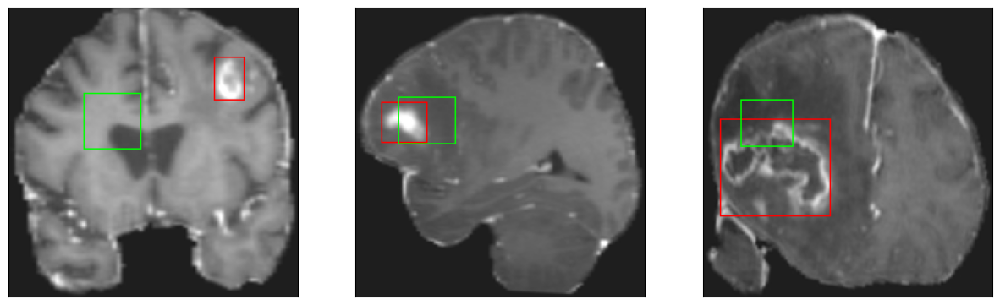

26/26 [==============================] - 3s 114ms/step - loss: 4.7166 - IoU: 0.6215 - val_loss: 17.3145 - val_IoU: 0.1961
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7603 - IoU: 0.6171
Epoch 86: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


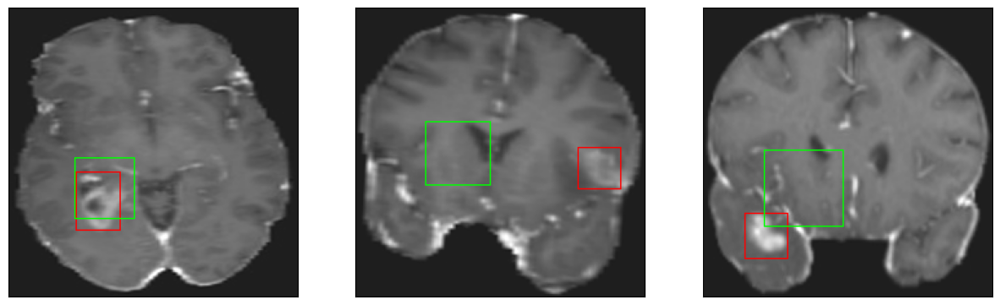

26/26 [==============================] - 3s 123ms/step - loss: 4.7545 - IoU: 0.6177 - val_loss: 14.2783 - val_IoU: 0.3043
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6396 - IoU: 0.6242
Epoch 87: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


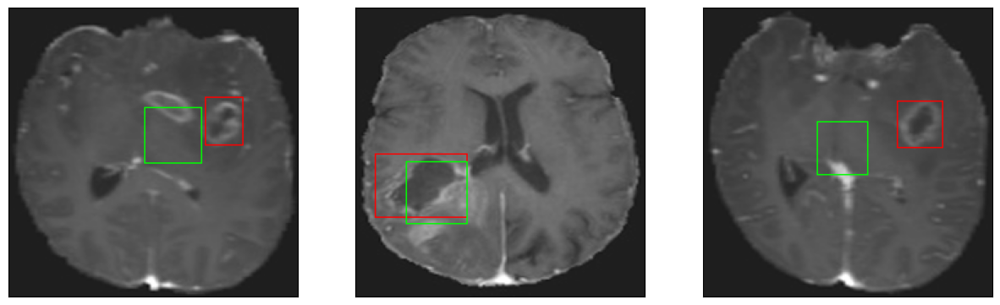

26/26 [==============================] - 2s 87ms/step - loss: 4.6184 - IoU: 0.6249 - val_loss: 13.6019 - val_IoU: 0.3456
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 4.6305 - IoU: 0.6295
Epoch 88: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


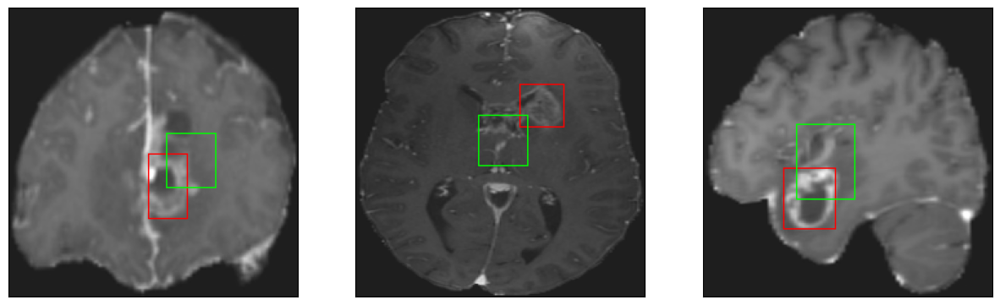

26/26 [==============================] - 2s 95ms/step - loss: 4.6305 - IoU: 0.6295 - val_loss: 12.9483 - val_IoU: 0.3400
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 4.6680 - IoU: 0.6263
Epoch 89: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


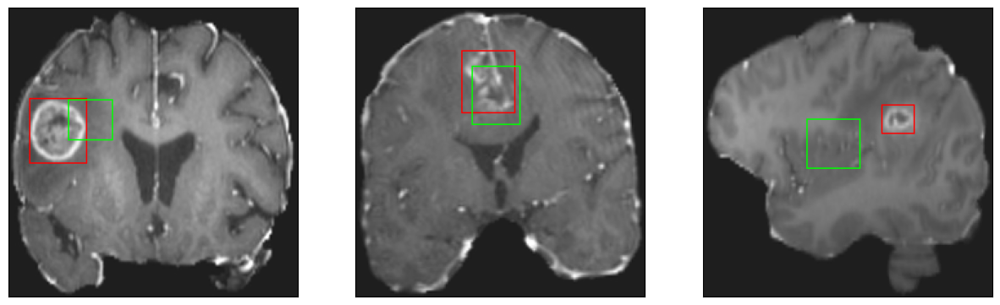

26/26 [==============================] - 3s 113ms/step - loss: 4.6680 - IoU: 0.6263 - val_loss: 13.7399 - val_IoU: 0.3357
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.5310 - IoU: 0.6356
Epoch 90: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


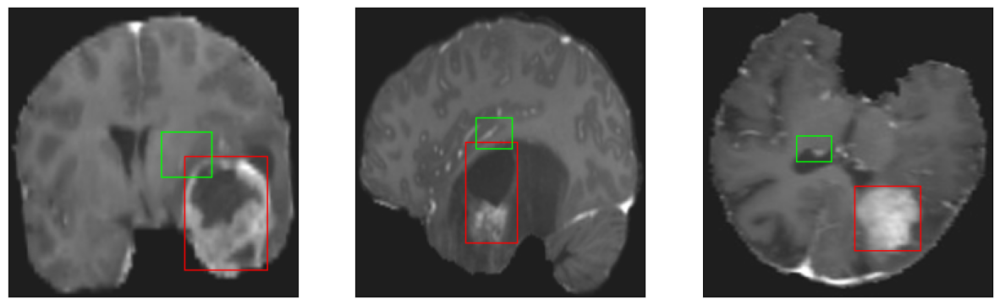

26/26 [==============================] - 3s 108ms/step - loss: 4.5310 - IoU: 0.6356 - val_loss: 17.2688 - val_IoU: 0.2025
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6637 - IoU: 0.6281
Epoch 91: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


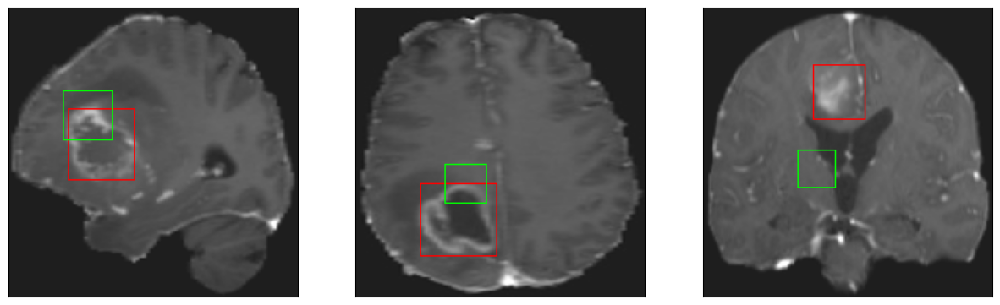

26/26 [==============================] - 3s 100ms/step - loss: 4.6433 - IoU: 0.6290 - val_loss: 16.3042 - val_IoU: 0.2388
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6613 - IoU: 0.6250
Epoch 92: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


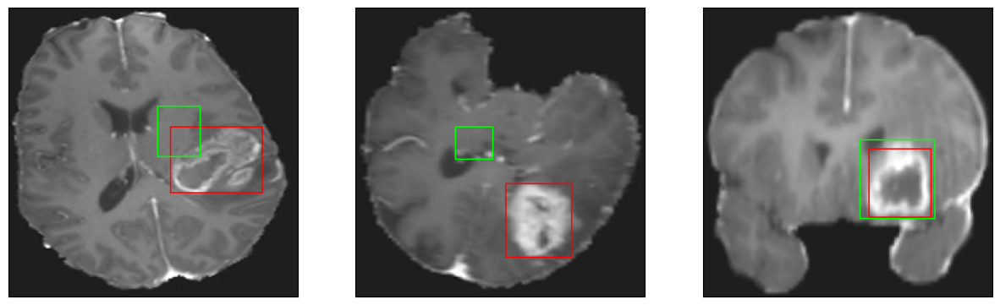

26/26 [==============================] - 3s 100ms/step - loss: 4.6576 - IoU: 0.6254 - val_loss: 15.9704 - val_IoU: 0.2419
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6542 - IoU: 0.6257
Epoch 93: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 6ms/step
4


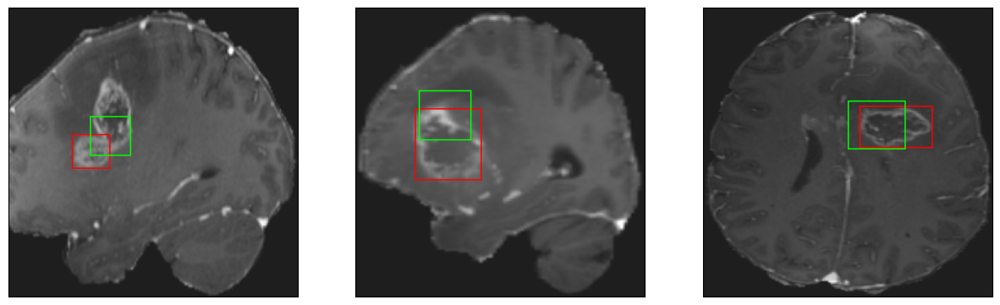

26/26 [==============================] - 3s 103ms/step - loss: 4.6246 - IoU: 0.6267 - val_loss: 14.5623 - val_IoU: 0.2861
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6006 - IoU: 0.6287
Epoch 94: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


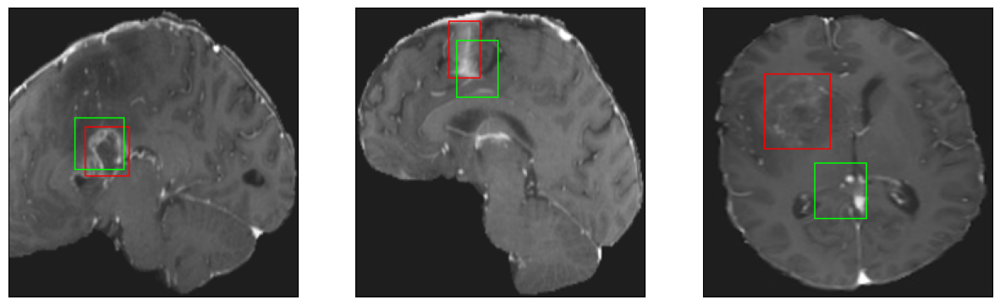

26/26 [==============================] - 3s 116ms/step - loss: 4.5965 - IoU: 0.6279 - val_loss: 13.2177 - val_IoU: 0.3559
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 4.6210 - IoU: 0.6280
Epoch 95: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


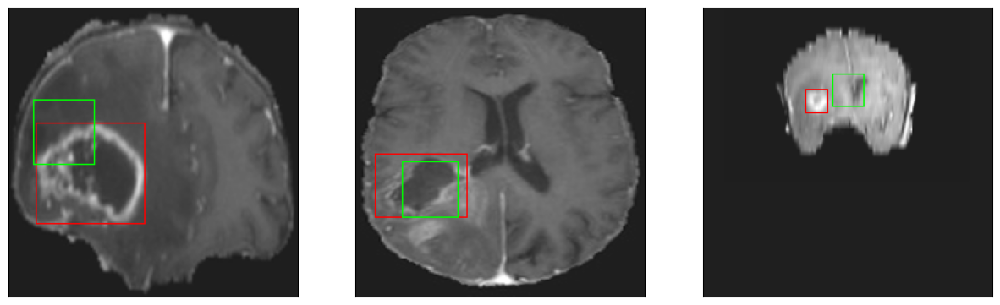

26/26 [==============================] - 3s 102ms/step - loss: 4.6210 - IoU: 0.6280 - val_loss: 13.5966 - val_IoU: 0.3209
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5417 - IoU: 0.6247
Epoch 96: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


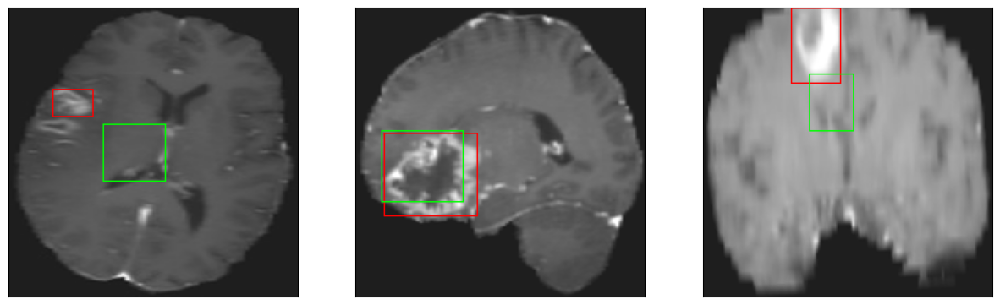

26/26 [==============================] - 3s 101ms/step - loss: 4.5861 - IoU: 0.6224 - val_loss: 14.0272 - val_IoU: 0.3179
Epoch 97/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5366 - IoU: 0.6311
Epoch 97: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


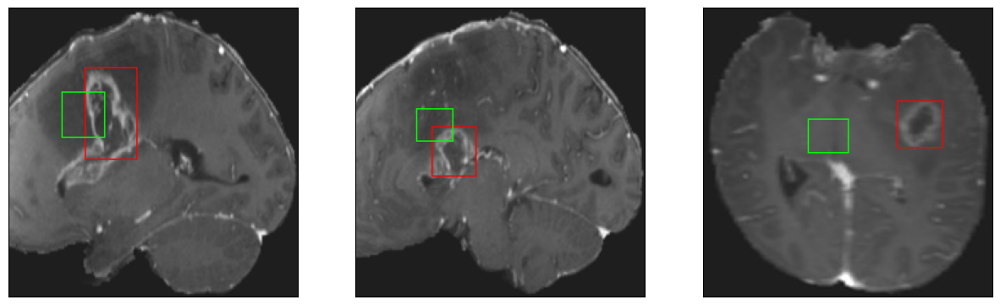

26/26 [==============================] - 2s 88ms/step - loss: 4.5654 - IoU: 0.6310 - val_loss: 17.1564 - val_IoU: 0.1963
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4266 - IoU: 0.6430
Epoch 98: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


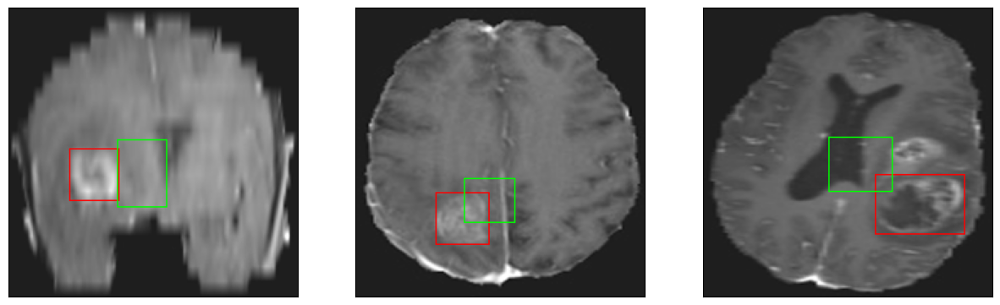

26/26 [==============================] - 2s 92ms/step - loss: 4.4286 - IoU: 0.6426 - val_loss: 12.9696 - val_IoU: 0.3540
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7240 - IoU: 0.6217
Epoch 99: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


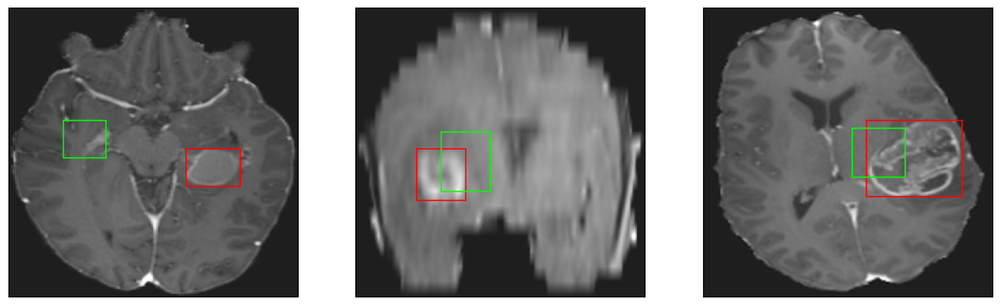

26/26 [==============================] - 3s 101ms/step - loss: 4.7814 - IoU: 0.6209 - val_loss: 15.9081 - val_IoU: 0.2338
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1633 - IoU: 0.6050
Epoch 100: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


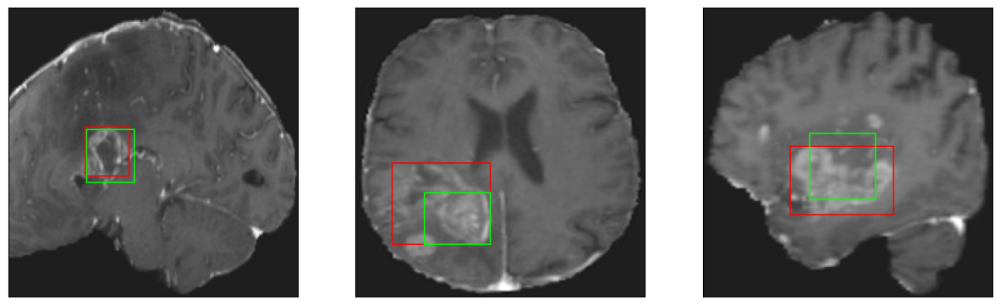

26/26 [==============================] - 3s 104ms/step - loss: 5.1074 - IoU: 0.6067 - val_loss: 13.2538 - val_IoU: 0.3482
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 4.5582 - IoU: 0.6346
Epoch 101: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


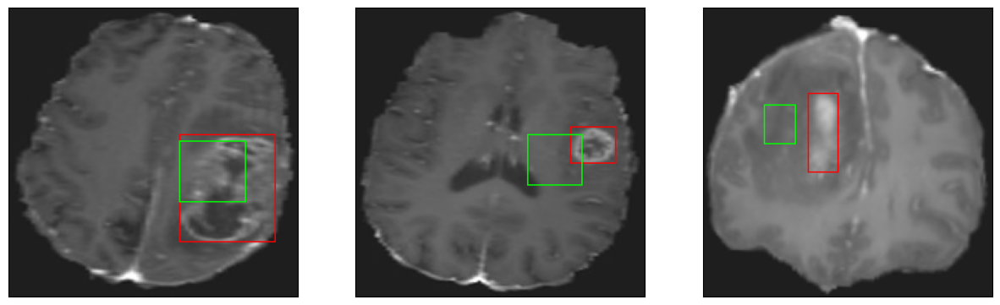

26/26 [==============================] - 3s 112ms/step - loss: 4.5582 - IoU: 0.6346 - val_loss: 13.0956 - val_IoU: 0.3349
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6177 - IoU: 0.6278
Epoch 102: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


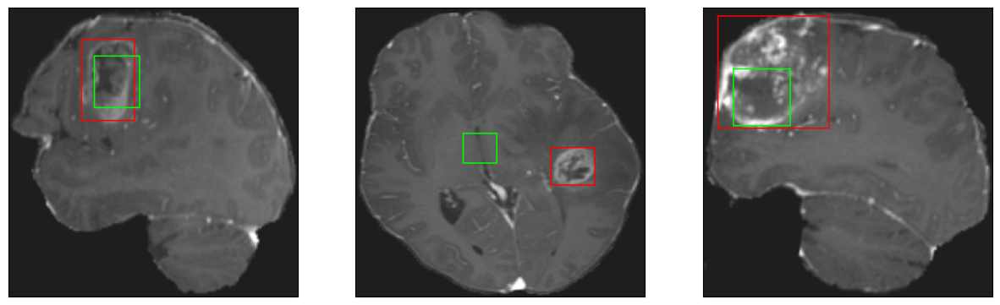

26/26 [==============================] - 2s 83ms/step - loss: 4.6218 - IoU: 0.6268 - val_loss: 14.0522 - val_IoU: 0.3039
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5606 - IoU: 0.6248
Epoch 103: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


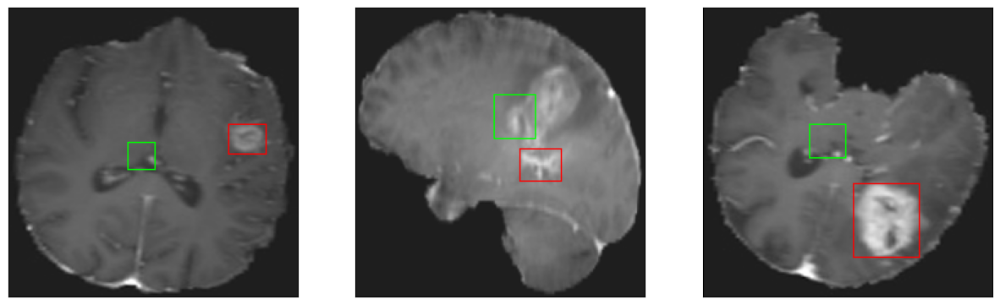

26/26 [==============================] - 3s 115ms/step - loss: 4.5552 - IoU: 0.6236 - val_loss: 13.6442 - val_IoU: 0.3170
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 4.8613 - IoU: 0.6054
Epoch 104: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


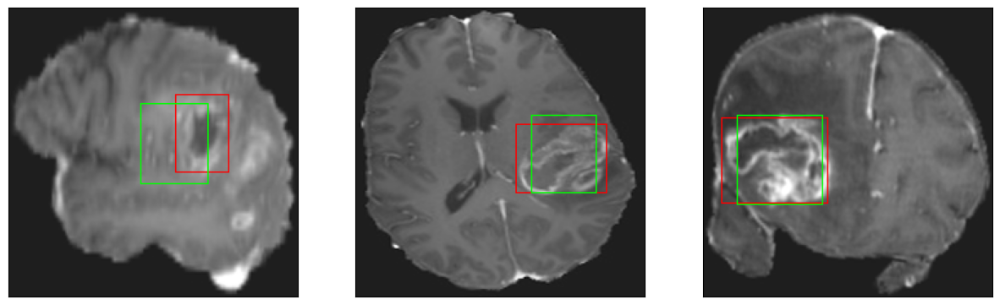

26/26 [==============================] - 3s 120ms/step - loss: 4.8613 - IoU: 0.6054 - val_loss: 14.4996 - val_IoU: 0.3277
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 4.5617 - IoU: 0.6370
Epoch 105: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


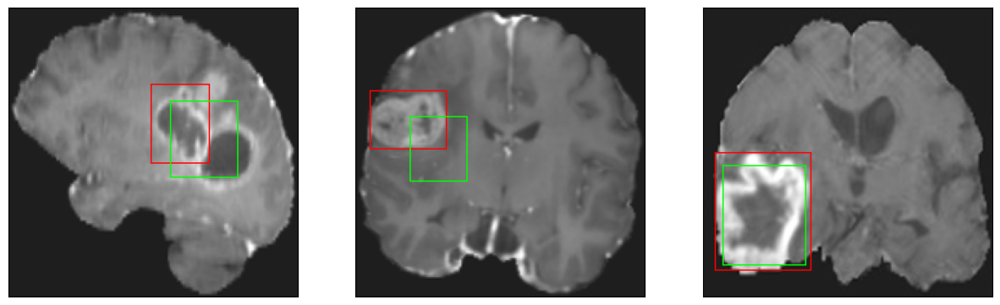

26/26 [==============================] - 3s 126ms/step - loss: 4.5617 - IoU: 0.6370 - val_loss: 13.3209 - val_IoU: 0.3442
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 4.3891 - IoU: 0.6472
Epoch 106: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


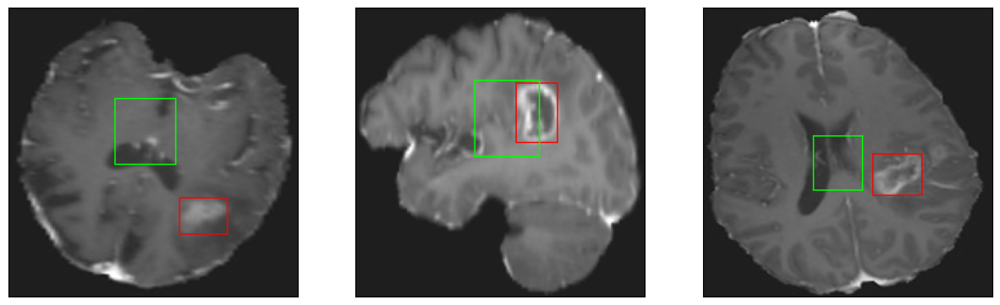

26/26 [==============================] - 3s 100ms/step - loss: 4.3891 - IoU: 0.6472 - val_loss: 13.2681 - val_IoU: 0.3525
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4824 - IoU: 0.6317
Epoch 107: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


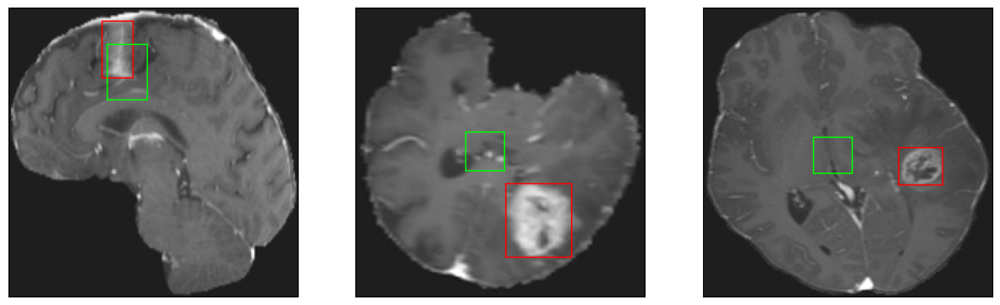

26/26 [==============================] - 3s 109ms/step - loss: 4.4539 - IoU: 0.6327 - val_loss: 13.0499 - val_IoU: 0.3516
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4504 - IoU: 0.6402
Epoch 108: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


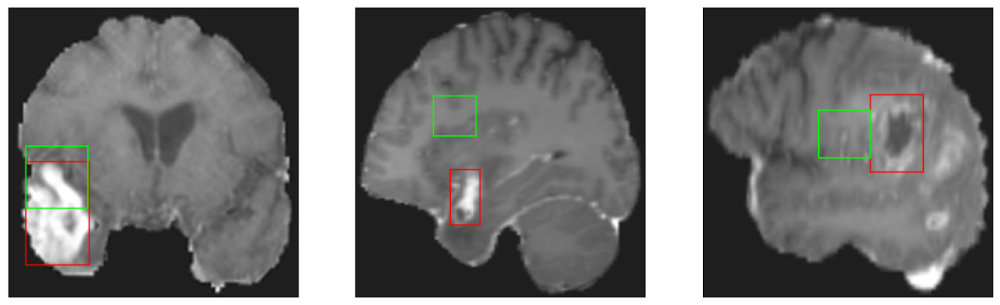

26/26 [==============================] - 3s 117ms/step - loss: 4.4342 - IoU: 0.6410 - val_loss: 17.0444 - val_IoU: 0.2054
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6778 - IoU: 0.6276
Epoch 109: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


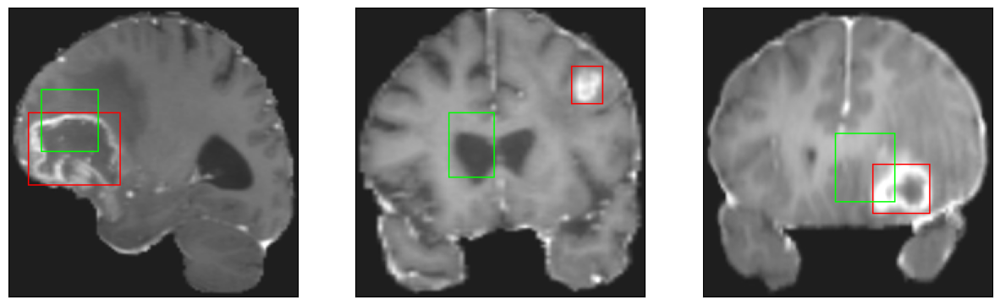

26/26 [==============================] - 3s 101ms/step - loss: 4.6553 - IoU: 0.6289 - val_loss: 15.0955 - val_IoU: 0.2548
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 4.3425 - IoU: 0.6508
Epoch 110: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


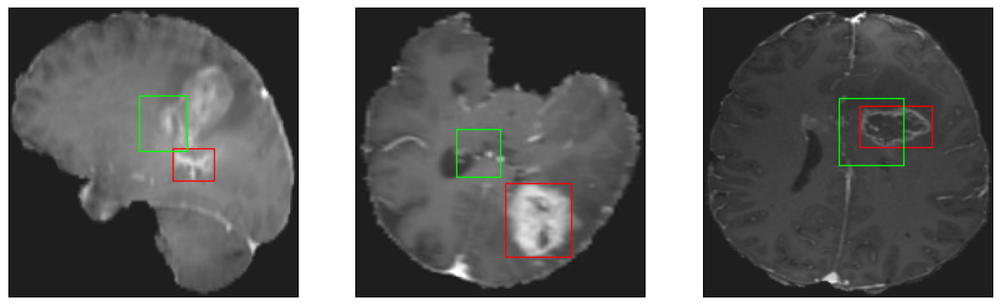

26/26 [==============================] - 2s 91ms/step - loss: 4.3425 - IoU: 0.6508 - val_loss: 13.7247 - val_IoU: 0.3355
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3408 - IoU: 0.6430
Epoch 111: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


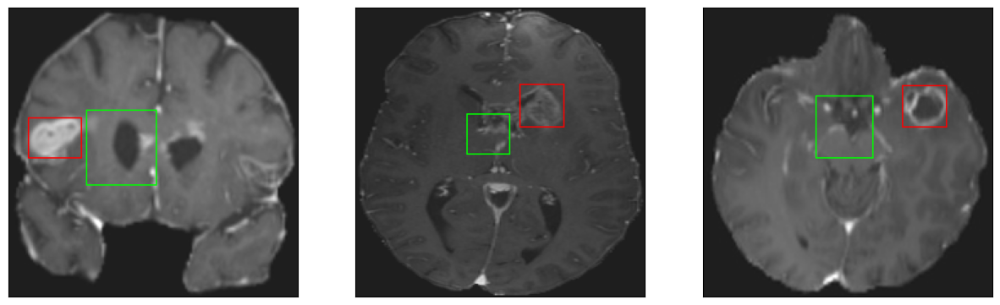

26/26 [==============================] - 2s 90ms/step - loss: 4.3418 - IoU: 0.6415 - val_loss: 13.0591 - val_IoU: 0.3615
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5330 - IoU: 0.6350
Epoch 112: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


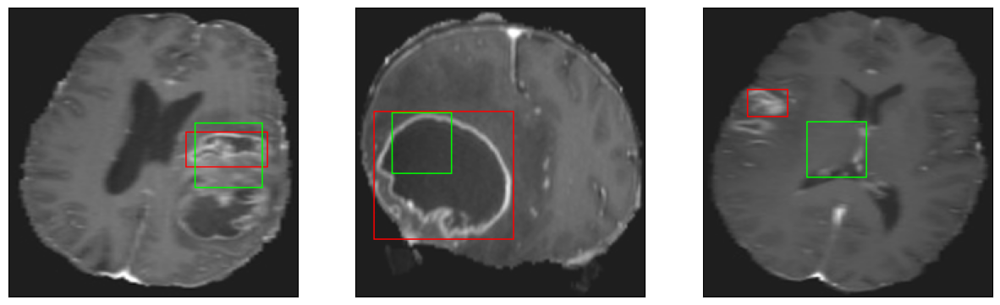

26/26 [==============================] - 2s 94ms/step - loss: 4.4781 - IoU: 0.6392 - val_loss: 12.9846 - val_IoU: 0.3622
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.5328 - IoU: 0.6332
Epoch 113: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


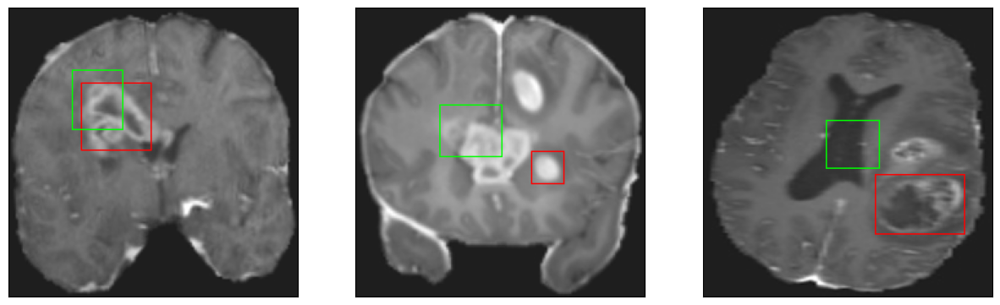

26/26 [==============================] - 3s 119ms/step - loss: 4.5328 - IoU: 0.6332 - val_loss: 16.2474 - val_IoU: 0.2211
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2475 - IoU: 0.6479
Epoch 114: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


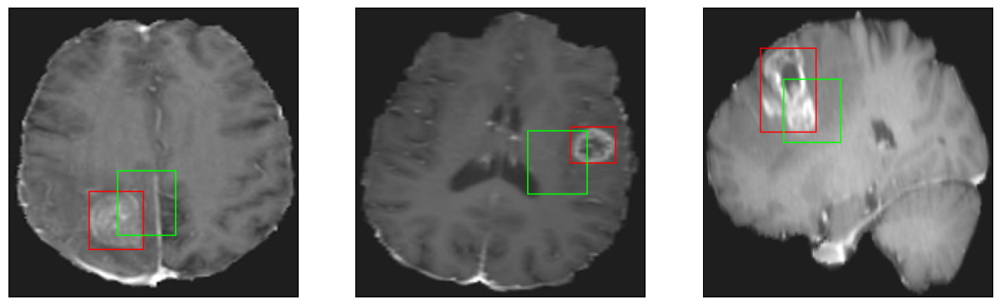

26/26 [==============================] - 3s 128ms/step - loss: 4.2867 - IoU: 0.6459 - val_loss: 13.8231 - val_IoU: 0.3317
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2862 - IoU: 0.6469
Epoch 115: val_IoU did not improve from 0.36238
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


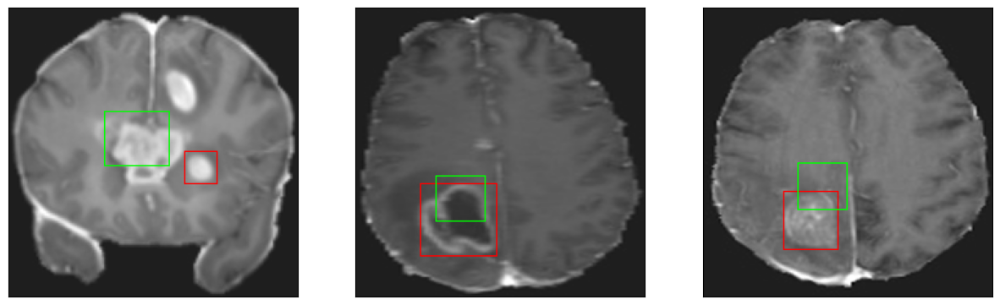

26/26 [==============================] - 3s 103ms/step - loss: 4.2498 - IoU: 0.6490 - val_loss: 14.2193 - val_IoU: 0.2904
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.2026 - IoU: 0.6555
Epoch 116: val_IoU improved from 0.36238 to 0.37457, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


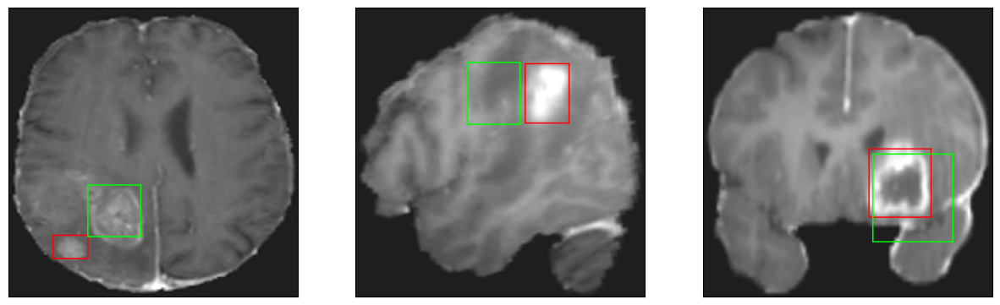

26/26 [==============================] - 3s 134ms/step - loss: 4.2026 - IoU: 0.6555 - val_loss: 12.5060 - val_IoU: 0.3746
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1751 - IoU: 0.6560
Epoch 117: val_IoU improved from 0.37457 to 0.37503, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


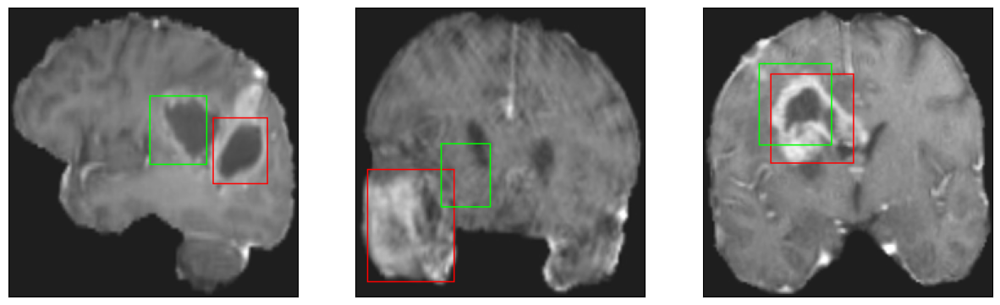

26/26 [==============================] - 3s 125ms/step - loss: 4.1437 - IoU: 0.6574 - val_loss: 12.6085 - val_IoU: 0.3750
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.2192 - IoU: 0.6522
Epoch 118: val_IoU did not improve from 0.37503
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


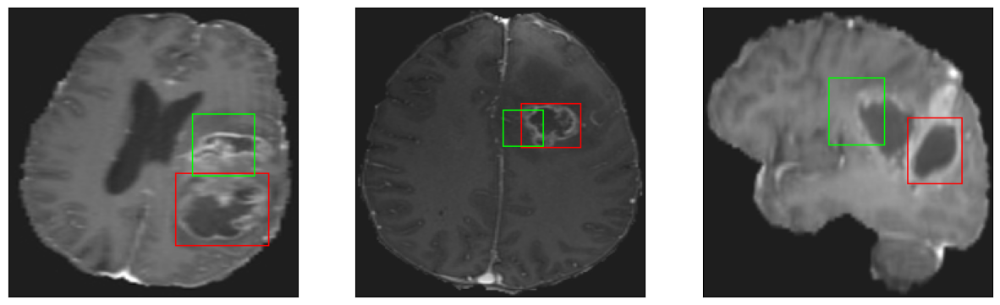

26/26 [==============================] - 2s 90ms/step - loss: 4.2192 - IoU: 0.6522 - val_loss: 15.3434 - val_IoU: 0.2455
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1925 - IoU: 0.6559
Epoch 119: val_IoU did not improve from 0.37503
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


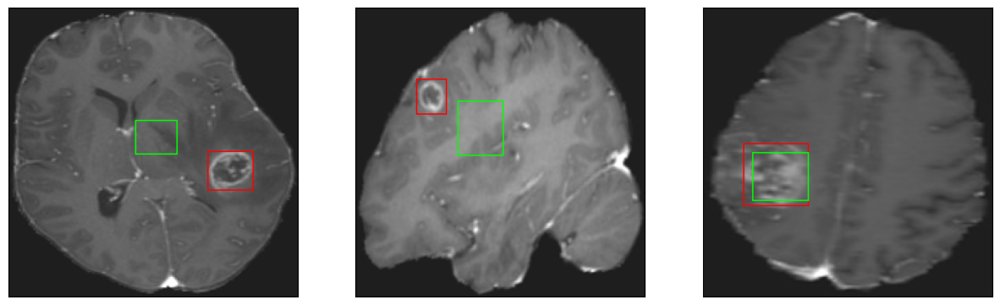

26/26 [==============================] - 2s 94ms/step - loss: 4.1755 - IoU: 0.6577 - val_loss: 13.3605 - val_IoU: 0.3381
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.2333 - IoU: 0.6509
Epoch 120: val_IoU did not improve from 0.37503
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


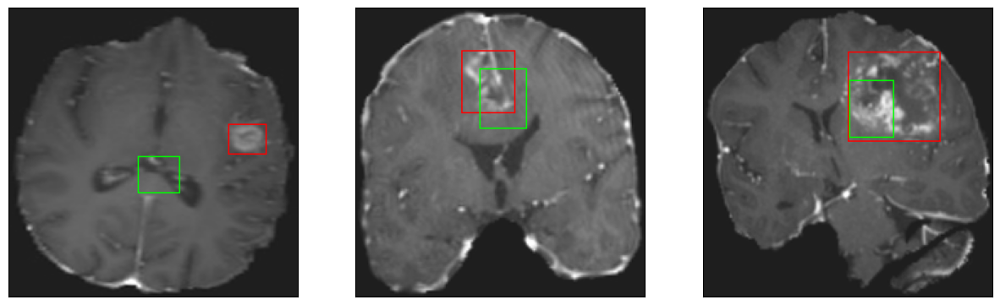

26/26 [==============================] - 3s 106ms/step - loss: 4.2333 - IoU: 0.6509 - val_loss: 12.6652 - val_IoU: 0.3618
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.1253 - IoU: 0.6651
Epoch 121: val_IoU did not improve from 0.37503
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


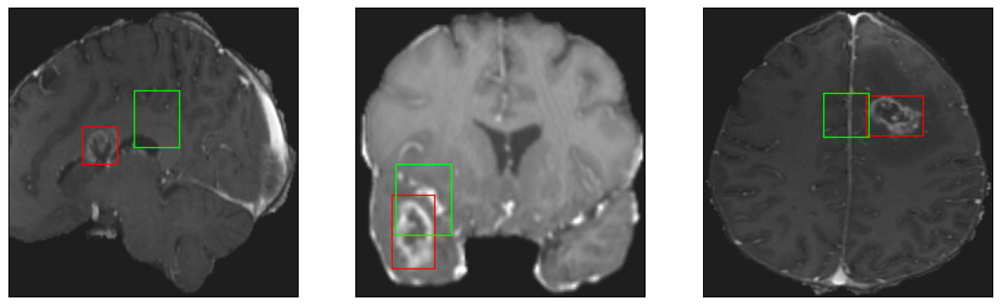

26/26 [==============================] - 3s 135ms/step - loss: 4.1253 - IoU: 0.6651 - val_loss: 13.0721 - val_IoU: 0.3383
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.3629 - IoU: 0.6466
Epoch 122: val_IoU did not improve from 0.37503
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


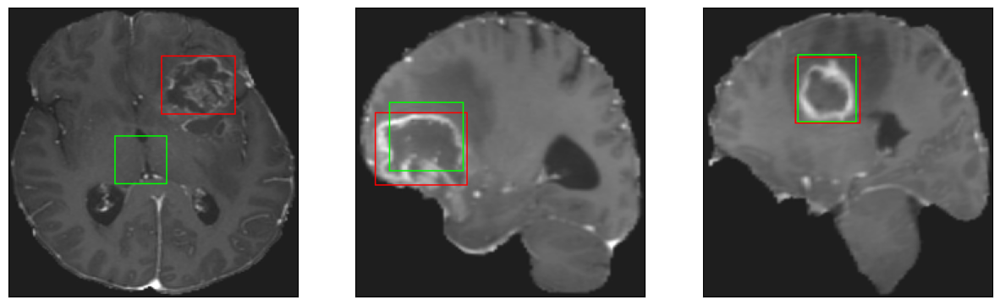

26/26 [==============================] - 3s 104ms/step - loss: 4.3629 - IoU: 0.6466 - val_loss: 12.9600 - val_IoU: 0.3399
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.3001 - IoU: 0.6477
Epoch 123: val_IoU did not improve from 0.37503
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


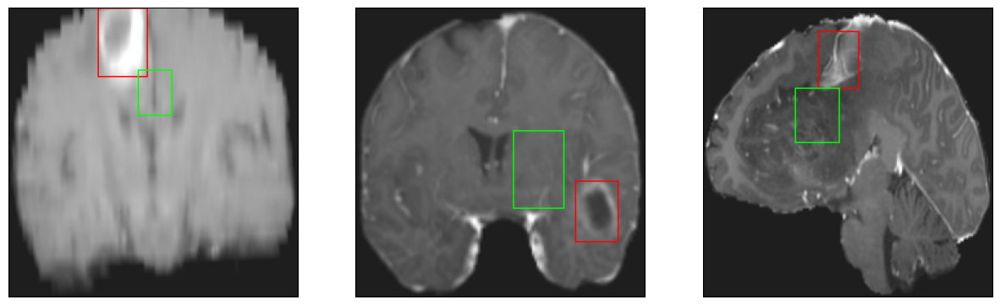

26/26 [==============================] - 2s 90ms/step - loss: 4.3001 - IoU: 0.6477 - val_loss: 12.5728 - val_IoU: 0.3618
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.1610 - IoU: 0.6577
Epoch 124: val_IoU improved from 0.37503 to 0.38164, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


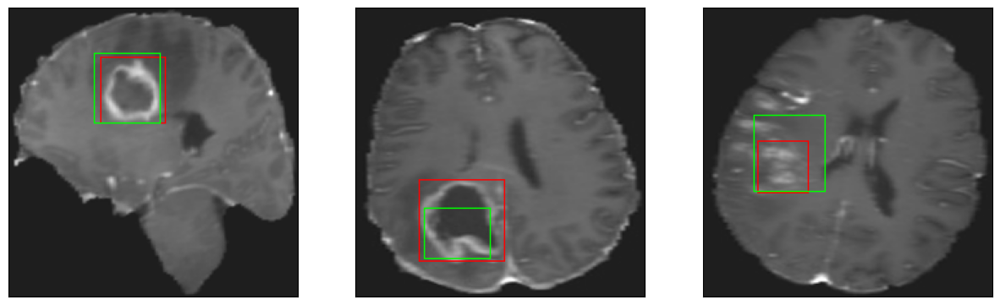

26/26 [==============================] - 4s 140ms/step - loss: 4.1610 - IoU: 0.6577 - val_loss: 12.3994 - val_IoU: 0.3816
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 4.1210 - IoU: 0.6595
Epoch 125: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


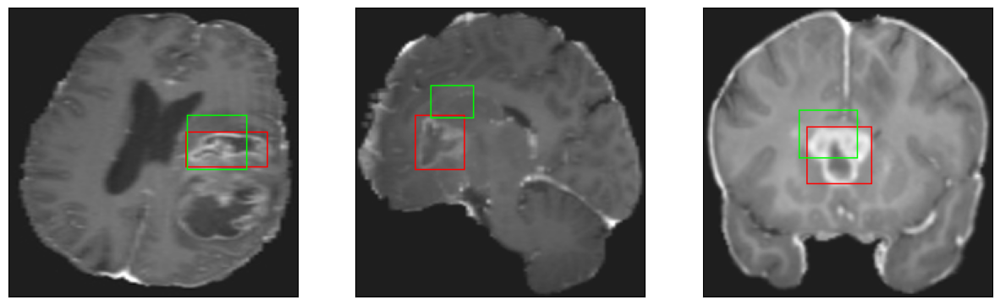

26/26 [==============================] - 3s 115ms/step - loss: 4.1210 - IoU: 0.6595 - val_loss: 16.8029 - val_IoU: 0.2001
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 4.1252 - IoU: 0.6606
Epoch 126: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


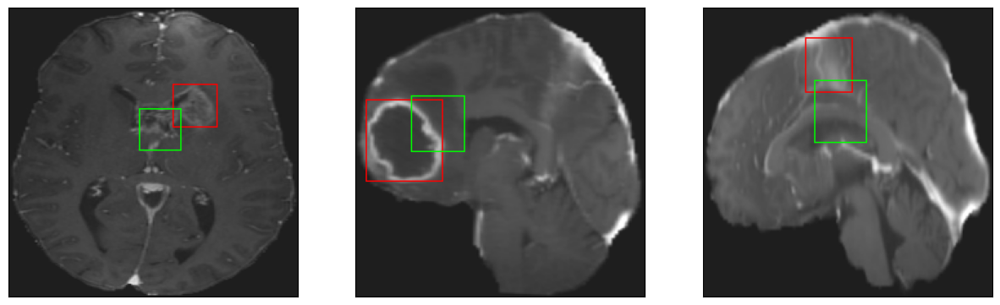

26/26 [==============================] - 3s 107ms/step - loss: 4.1252 - IoU: 0.6606 - val_loss: 12.7428 - val_IoU: 0.3637
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 4.4776 - IoU: 0.6375
Epoch 127: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


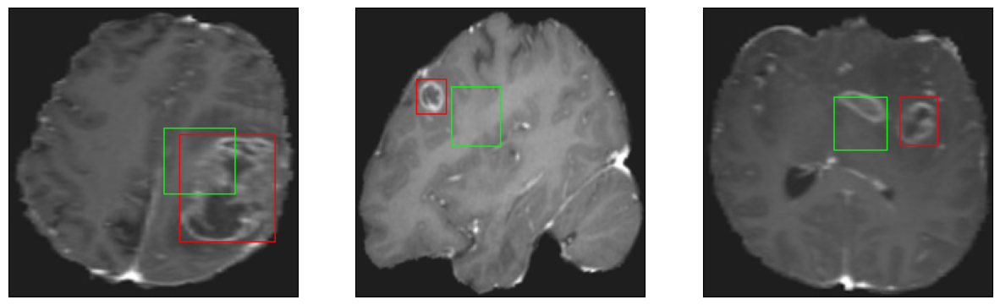

26/26 [==============================] - 2s 95ms/step - loss: 4.4776 - IoU: 0.6375 - val_loss: 13.4473 - val_IoU: 0.3432
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2749 - IoU: 0.6394
Epoch 128: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


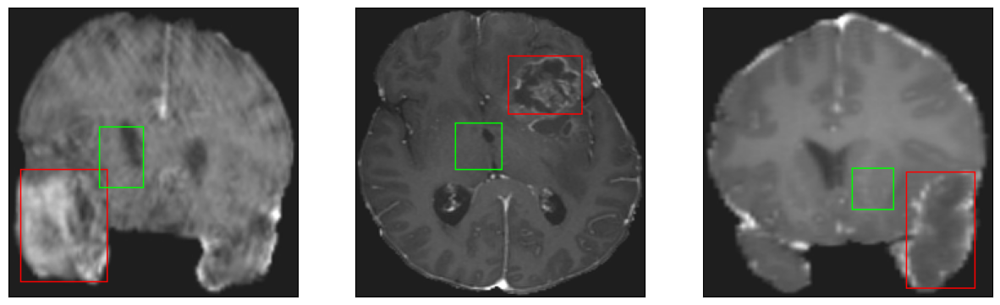

26/26 [==============================] - 3s 125ms/step - loss: 4.2489 - IoU: 0.6442 - val_loss: 13.4425 - val_IoU: 0.3343
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.2362 - IoU: 0.6571
Epoch 129: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


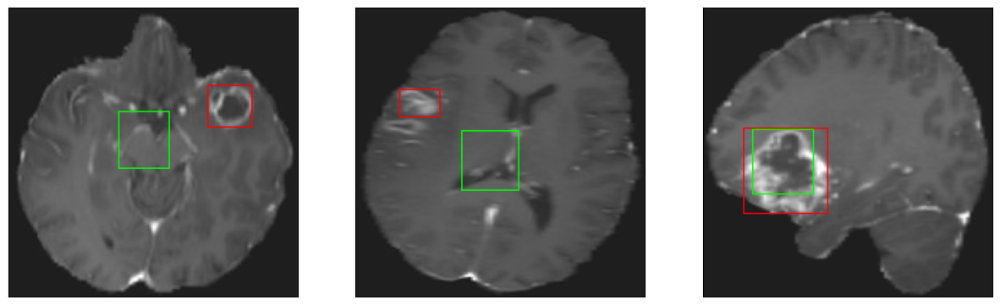

26/26 [==============================] - 3s 100ms/step - loss: 4.2362 - IoU: 0.6571 - val_loss: 12.9792 - val_IoU: 0.3536
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 4.4184 - IoU: 0.6402
Epoch 130: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


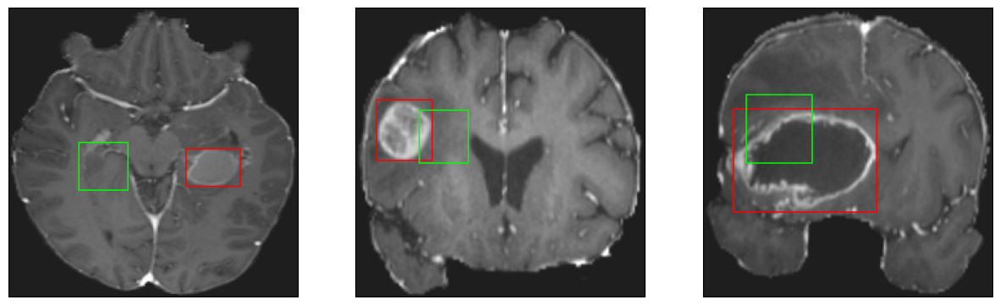

26/26 [==============================] - 3s 103ms/step - loss: 4.4184 - IoU: 0.6402 - val_loss: 13.3837 - val_IoU: 0.3208
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.2112 - IoU: 0.6543
Epoch 131: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


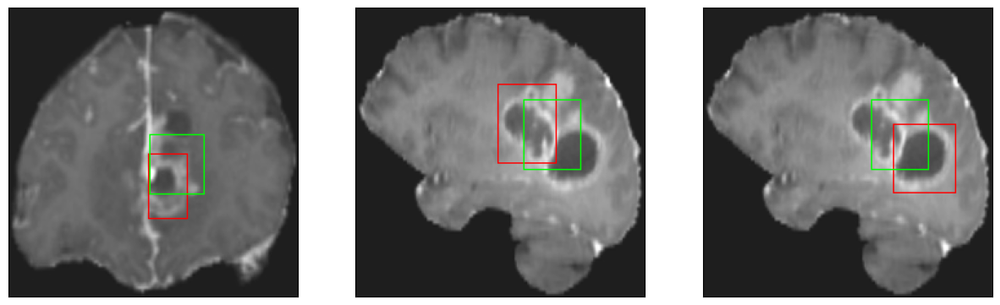

26/26 [==============================] - 2s 94ms/step - loss: 4.2112 - IoU: 0.6543 - val_loss: 12.9408 - val_IoU: 0.3684
Epoch 132/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1822 - IoU: 0.6561
Epoch 132: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


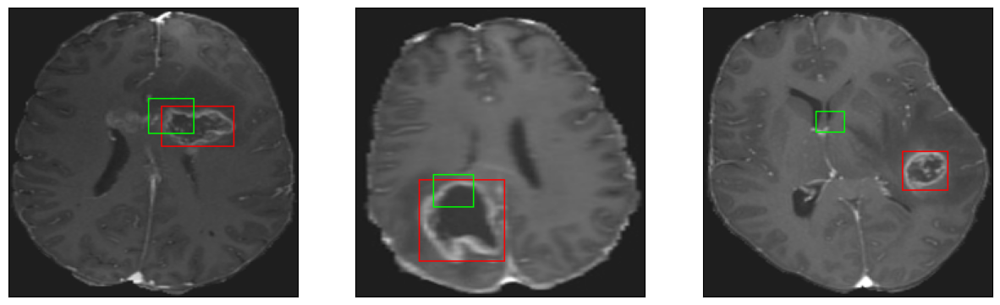

26/26 [==============================] - 3s 116ms/step - loss: 4.1845 - IoU: 0.6559 - val_loss: 21.0726 - val_IoU: 0.1061
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.2542 - IoU: 0.6489
Epoch 133: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


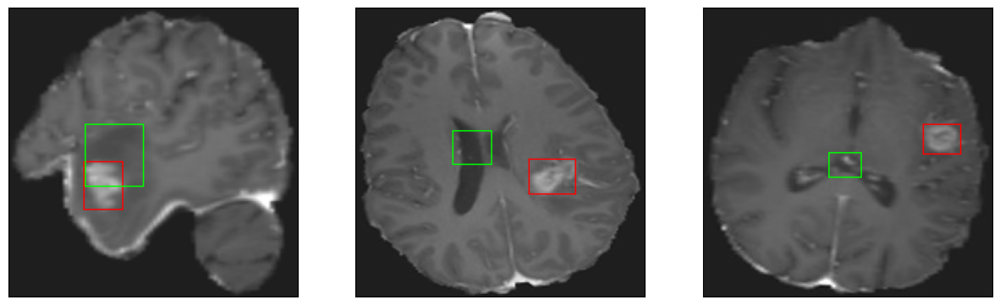

26/26 [==============================] - 2s 95ms/step - loss: 4.2542 - IoU: 0.6489 - val_loss: 16.2898 - val_IoU: 0.2162
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1423 - IoU: 0.6547
Epoch 134: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


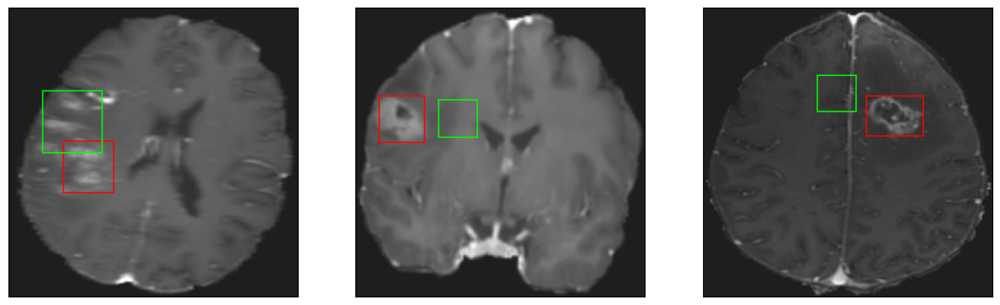

26/26 [==============================] - 3s 104ms/step - loss: 4.1400 - IoU: 0.6562 - val_loss: 17.6304 - val_IoU: 0.1856
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.2180 - IoU: 0.6550
Epoch 135: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


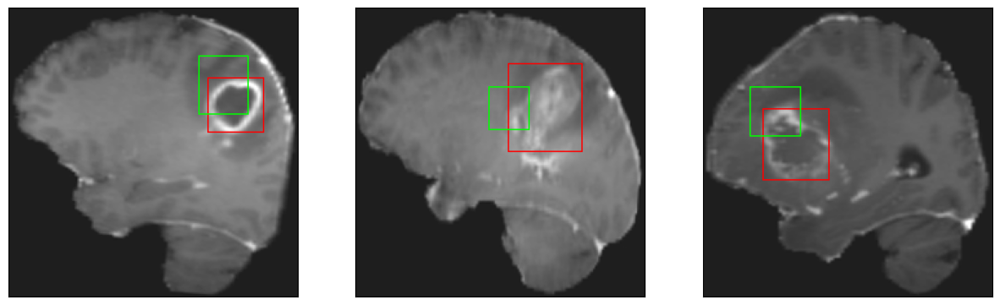

26/26 [==============================] - 3s 104ms/step - loss: 4.2180 - IoU: 0.6550 - val_loss: 16.7236 - val_IoU: 0.2103
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.2367 - IoU: 0.6517
Epoch 136: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


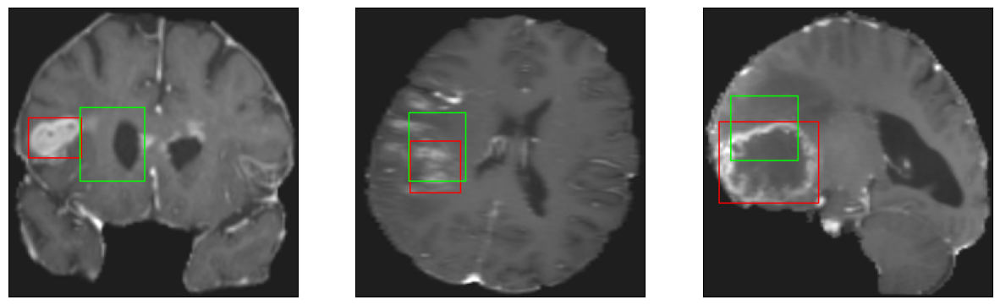

26/26 [==============================] - 3s 107ms/step - loss: 4.2367 - IoU: 0.6517 - val_loss: 12.6365 - val_IoU: 0.3683
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.2758 - IoU: 0.6540
Epoch 137: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


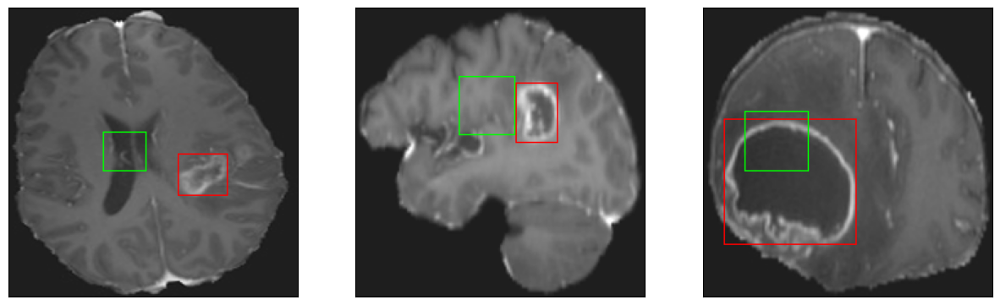

26/26 [==============================] - 3s 117ms/step - loss: 4.2758 - IoU: 0.6540 - val_loss: 12.9173 - val_IoU: 0.3531
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3045 - IoU: 0.6508
Epoch 138: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


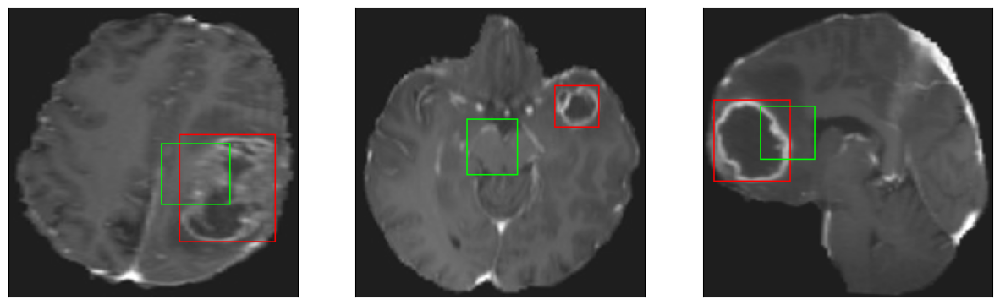

26/26 [==============================] - 2s 94ms/step - loss: 4.2634 - IoU: 0.6542 - val_loss: 12.9354 - val_IoU: 0.3498
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1574 - IoU: 0.6620
Epoch 139: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


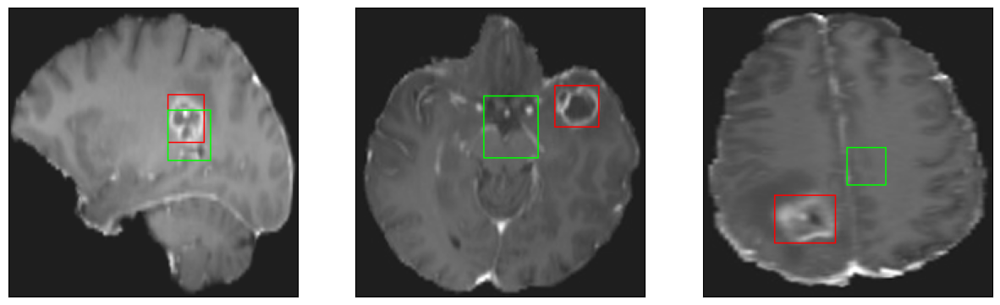

26/26 [==============================] - 2s 97ms/step - loss: 4.1403 - IoU: 0.6640 - val_loss: 12.3081 - val_IoU: 0.3801
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2037 - IoU: 0.6565
Epoch 140: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


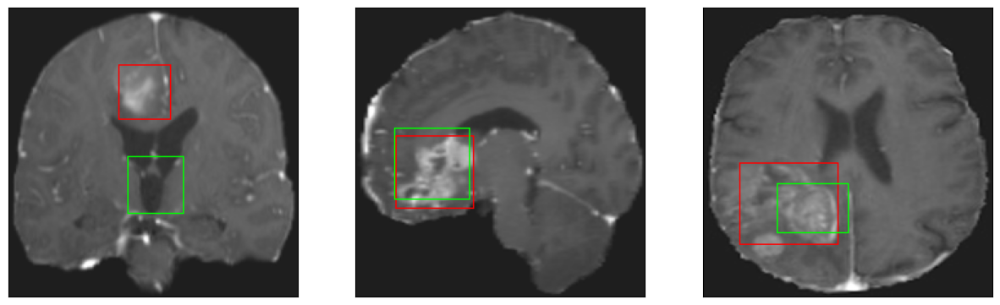

26/26 [==============================] - 3s 101ms/step - loss: 4.2108 - IoU: 0.6554 - val_loss: 13.6916 - val_IoU: 0.3390
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4071 - IoU: 0.6470
Epoch 141: val_IoU did not improve from 0.38164
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


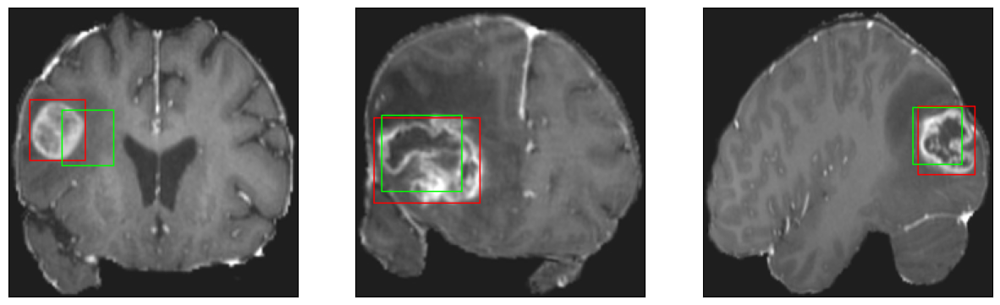

26/26 [==============================] - 3s 104ms/step - loss: 4.3610 - IoU: 0.6486 - val_loss: 12.8908 - val_IoU: 0.3603
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.1206 - IoU: 0.6670
Epoch 142: val_IoU improved from 0.38164 to 0.38252, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


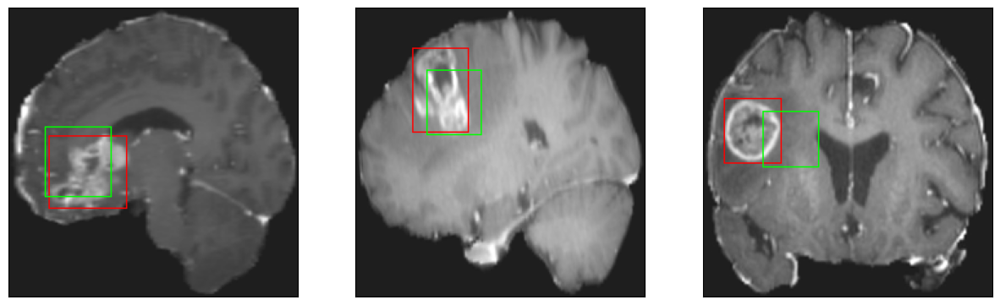

26/26 [==============================] - 4s 158ms/step - loss: 4.1206 - IoU: 0.6670 - val_loss: 12.5762 - val_IoU: 0.3825
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1847 - IoU: 0.6642
Epoch 143: val_IoU did not improve from 0.38252
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


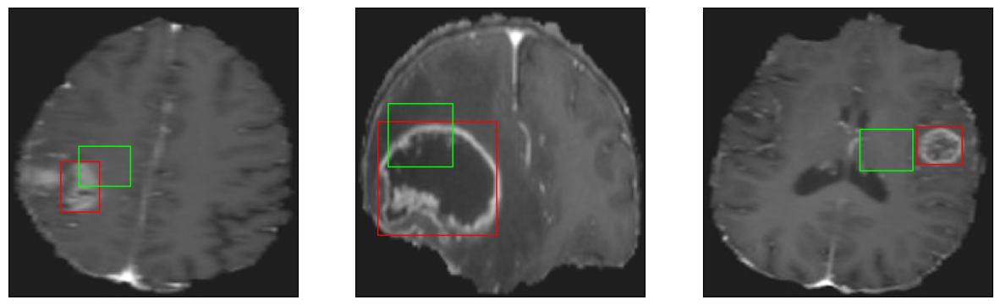

26/26 [==============================] - 3s 97ms/step - loss: 4.1846 - IoU: 0.6651 - val_loss: 12.7652 - val_IoU: 0.3574
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3573 - IoU: 0.6431
Epoch 144: val_IoU did not improve from 0.38252
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


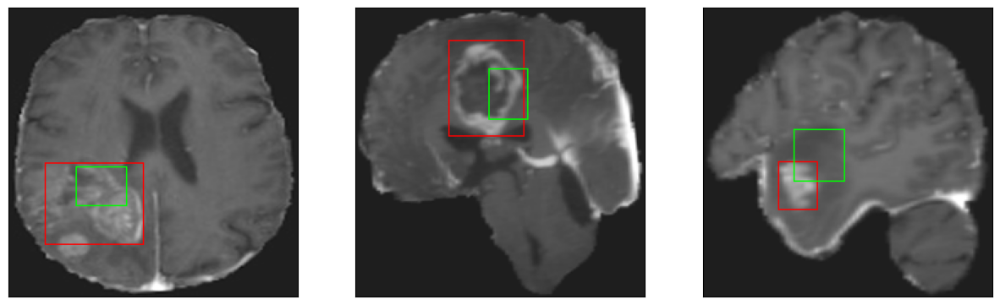

26/26 [==============================] - 2s 89ms/step - loss: 4.3632 - IoU: 0.6421 - val_loss: 18.7179 - val_IoU: 0.1514
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2933 - IoU: 0.6526
Epoch 145: val_IoU did not improve from 0.38252
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


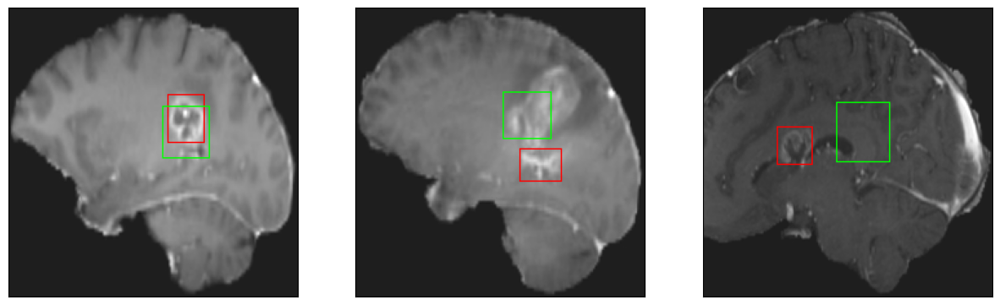

26/26 [==============================] - 2s 90ms/step - loss: 4.2732 - IoU: 0.6547 - val_loss: 12.7082 - val_IoU: 0.3551
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.1035 - IoU: 0.6662
Epoch 146: val_IoU improved from 0.38252 to 0.39642, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


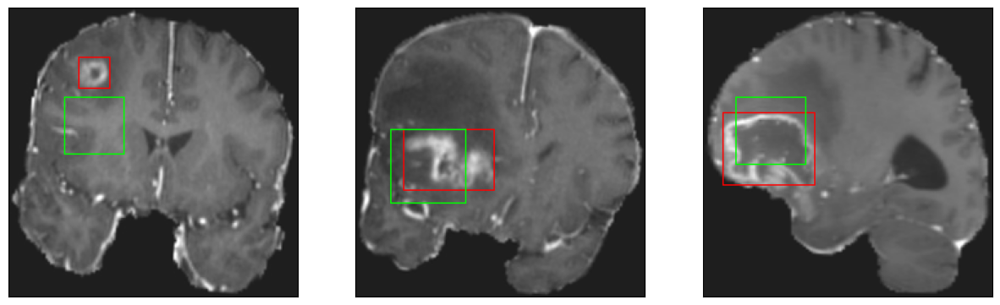

26/26 [==============================] - 4s 140ms/step - loss: 4.1035 - IoU: 0.6662 - val_loss: 12.1940 - val_IoU: 0.3964
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.0707 - IoU: 0.6642
Epoch 147: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


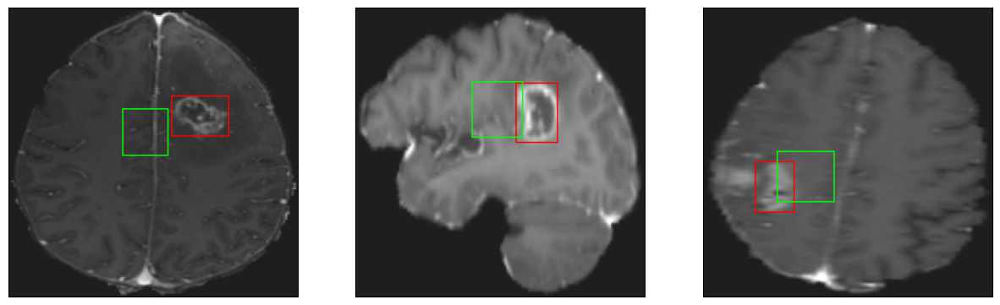

26/26 [==============================] - 3s 102ms/step - loss: 4.0707 - IoU: 0.6642 - val_loss: 14.0138 - val_IoU: 0.3044
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 4.1390 - IoU: 0.6534
Epoch 148: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4


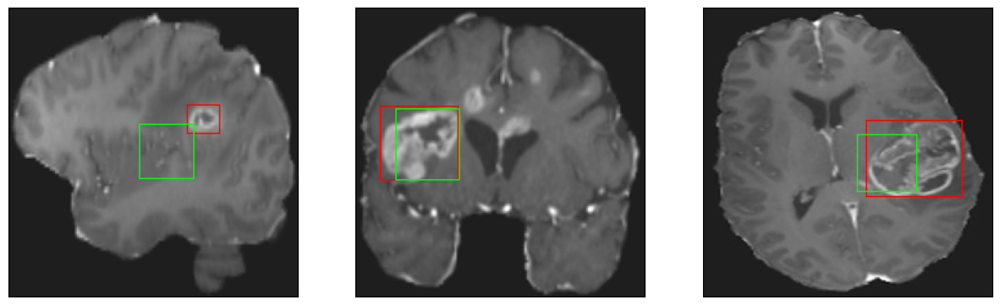

26/26 [==============================] - 2s 90ms/step - loss: 4.1390 - IoU: 0.6534 - val_loss: 12.5907 - val_IoU: 0.3836
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.2308 - IoU: 0.6562
Epoch 149: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


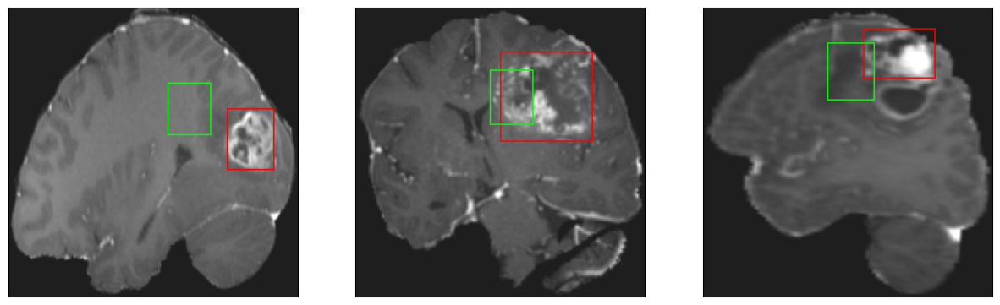

26/26 [==============================] - 3s 115ms/step - loss: 4.2308 - IoU: 0.6562 - val_loss: 14.7635 - val_IoU: 0.2762
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 3.9887 - IoU: 0.6740
Epoch 150: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


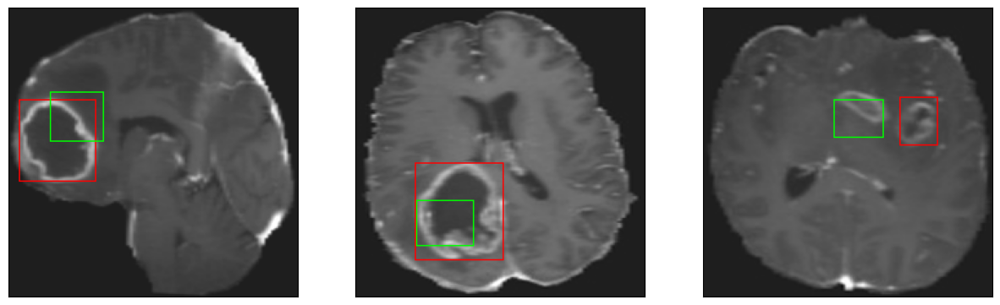

26/26 [==============================] - 3s 130ms/step - loss: 3.9887 - IoU: 0.6740 - val_loss: 14.9581 - val_IoU: 0.2547
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 3.9669 - IoU: 0.6757
Epoch 151: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


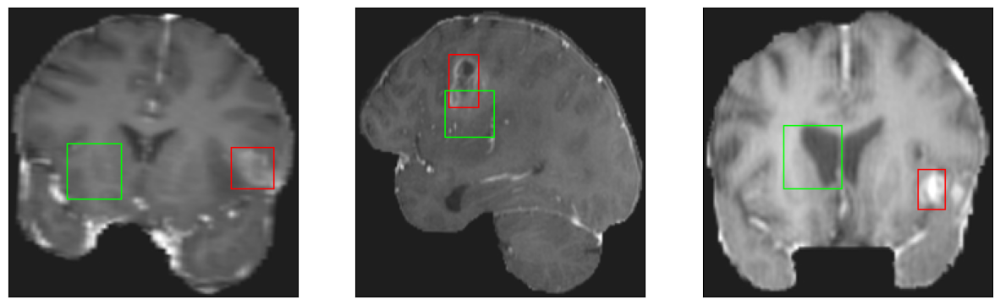

26/26 [==============================] - 3s 111ms/step - loss: 3.9669 - IoU: 0.6757 - val_loss: 13.0824 - val_IoU: 0.3485
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 4.2679 - IoU: 0.6507
Epoch 152: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


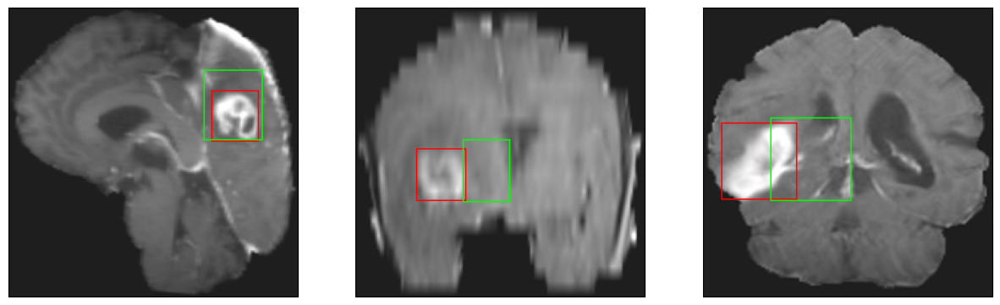

26/26 [==============================] - 2s 95ms/step - loss: 4.2679 - IoU: 0.6507 - val_loss: 12.5286 - val_IoU: 0.3650
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.0426 - IoU: 0.6660
Epoch 153: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


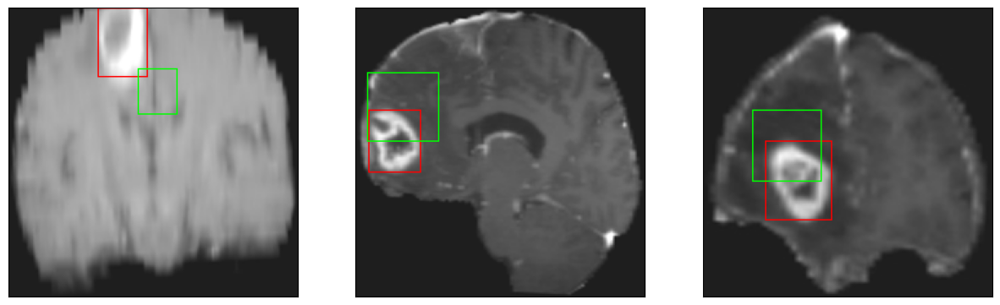

26/26 [==============================] - 2s 93ms/step - loss: 4.0426 - IoU: 0.6660 - val_loss: 12.5472 - val_IoU: 0.3687
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.0781 - IoU: 0.6624
Epoch 154: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


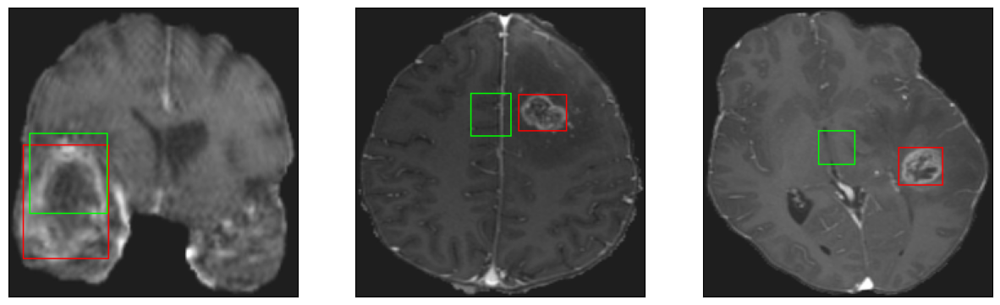

26/26 [==============================] - 2s 97ms/step - loss: 4.0781 - IoU: 0.6624 - val_loss: 13.4622 - val_IoU: 0.3230
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 3.8183 - IoU: 0.6807
Epoch 155: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


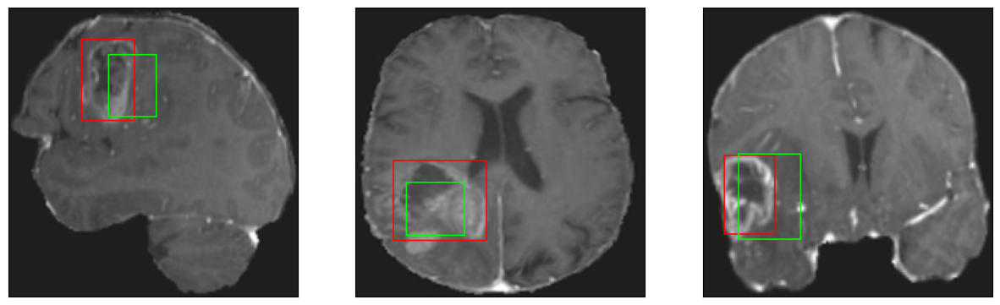

26/26 [==============================] - 3s 110ms/step - loss: 3.8183 - IoU: 0.6807 - val_loss: 12.2045 - val_IoU: 0.3817
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8906 - IoU: 0.6787
Epoch 156: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


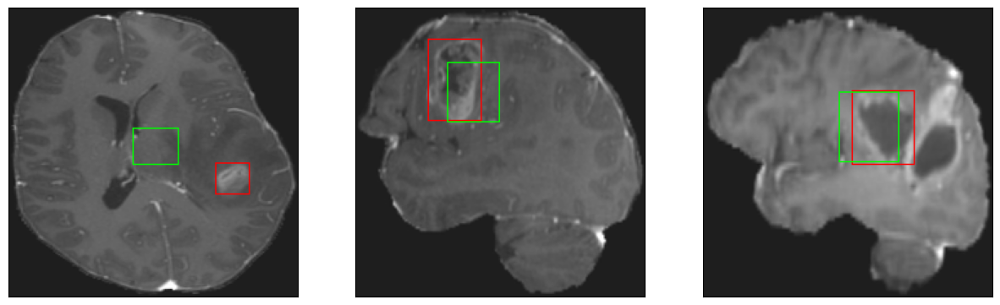

26/26 [==============================] - 3s 116ms/step - loss: 3.8973 - IoU: 0.6785 - val_loss: 12.4323 - val_IoU: 0.3752
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 3.9206 - IoU: 0.6758
Epoch 157: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


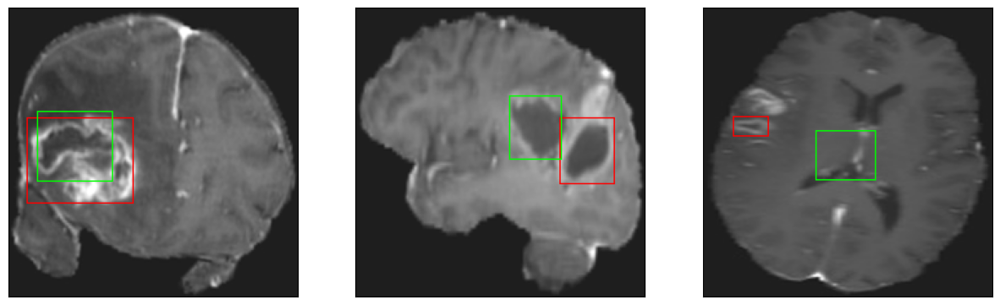

26/26 [==============================] - 3s 99ms/step - loss: 3.9206 - IoU: 0.6758 - val_loss: 12.3624 - val_IoU: 0.3741
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9548 - IoU: 0.6781
Epoch 158: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


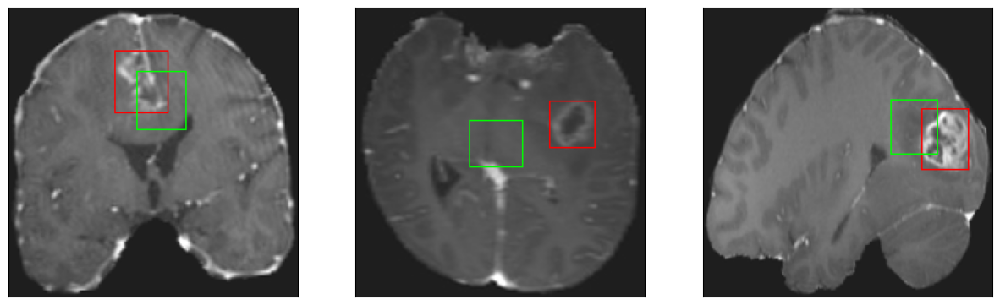

26/26 [==============================] - 3s 102ms/step - loss: 3.9213 - IoU: 0.6780 - val_loss: 12.6672 - val_IoU: 0.3699
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 4.1228 - IoU: 0.6562
Epoch 159: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


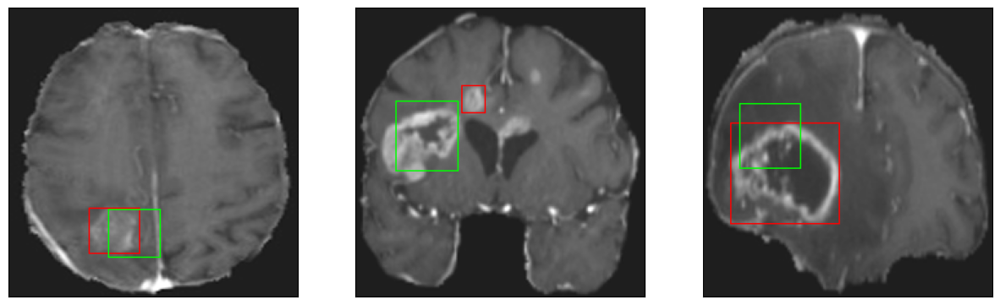

26/26 [==============================] - 2s 96ms/step - loss: 4.1228 - IoU: 0.6562 - val_loss: 12.5454 - val_IoU: 0.3760
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9096 - IoU: 0.6789
Epoch 160: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


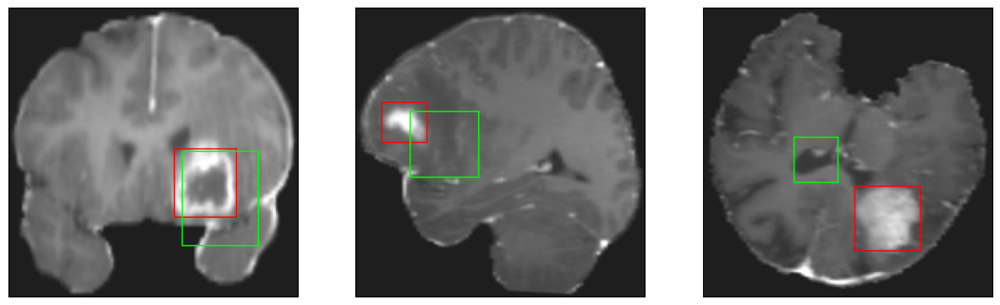

26/26 [==============================] - 3s 109ms/step - loss: 3.9478 - IoU: 0.6770 - val_loss: 12.7894 - val_IoU: 0.3616
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0202 - IoU: 0.6724
Epoch 161: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


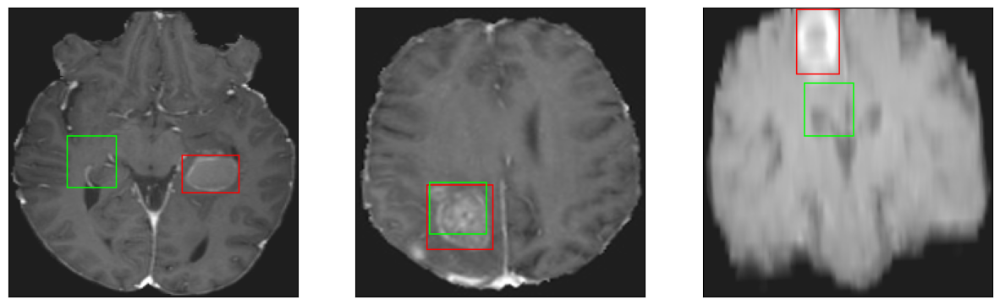

26/26 [==============================] - 3s 113ms/step - loss: 3.9856 - IoU: 0.6758 - val_loss: 12.3968 - val_IoU: 0.3883
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2325 - IoU: 0.6577
Epoch 162: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


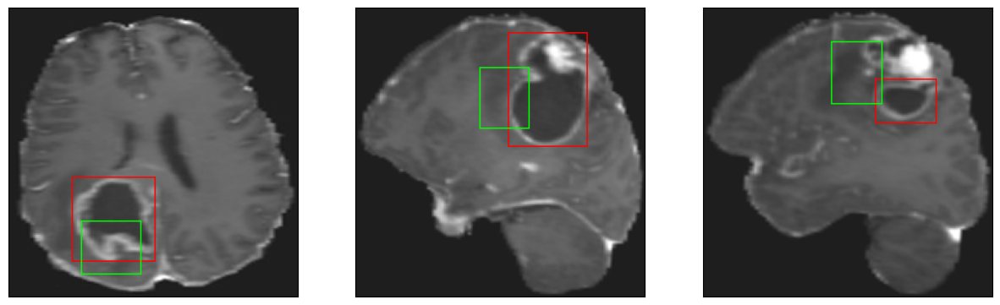

26/26 [==============================] - 3s 120ms/step - loss: 4.2321 - IoU: 0.6579 - val_loss: 13.3797 - val_IoU: 0.3374
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7400 - IoU: 0.6333
Epoch 163: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


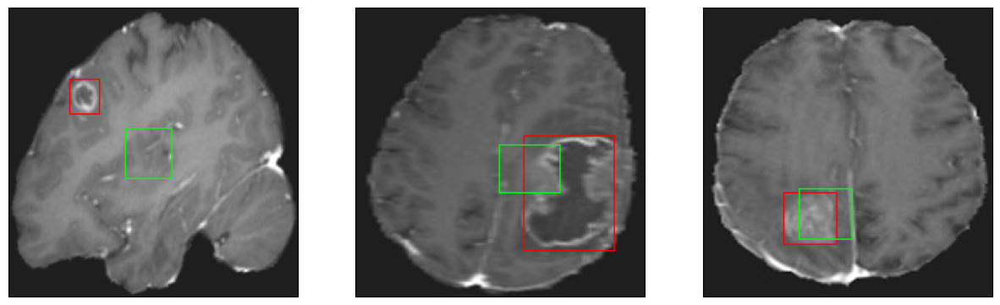

26/26 [==============================] - 2s 91ms/step - loss: 4.7017 - IoU: 0.6352 - val_loss: 13.2215 - val_IoU: 0.3338
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 3.9137 - IoU: 0.6776
Epoch 164: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


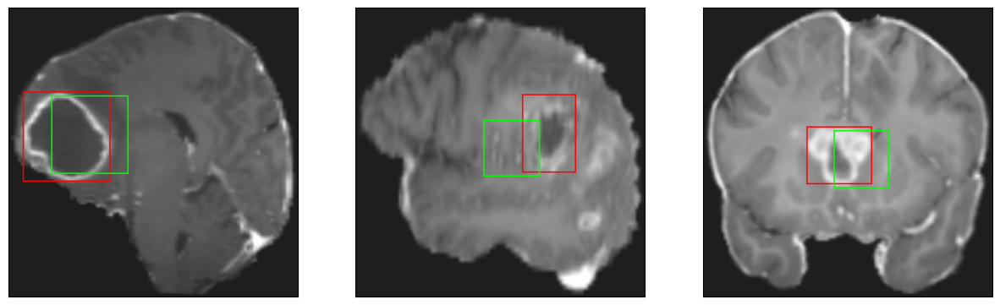

26/26 [==============================] - 2s 85ms/step - loss: 3.9137 - IoU: 0.6776 - val_loss: 12.8447 - val_IoU: 0.3451
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9666 - IoU: 0.6728
Epoch 165: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


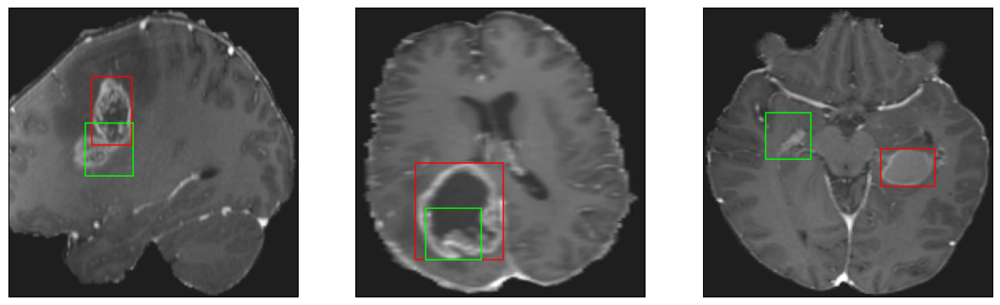

26/26 [==============================] - 3s 98ms/step - loss: 3.9609 - IoU: 0.6727 - val_loss: 12.7651 - val_IoU: 0.3645
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8475 - IoU: 0.6829
Epoch 166: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


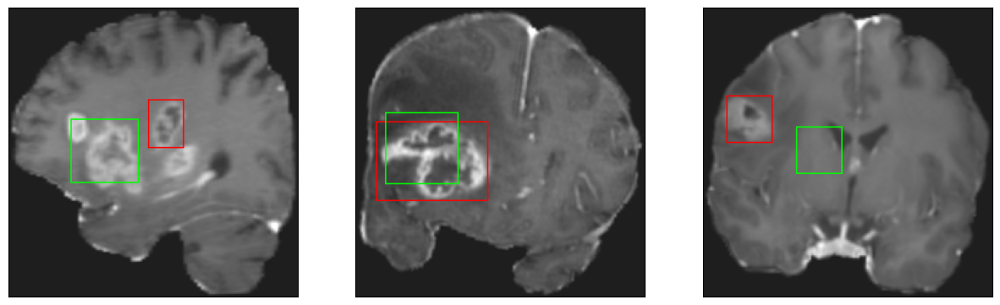

26/26 [==============================] - 2s 94ms/step - loss: 3.8550 - IoU: 0.6818 - val_loss: 12.7472 - val_IoU: 0.3700
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 3.9903 - IoU: 0.6703
Epoch 167: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


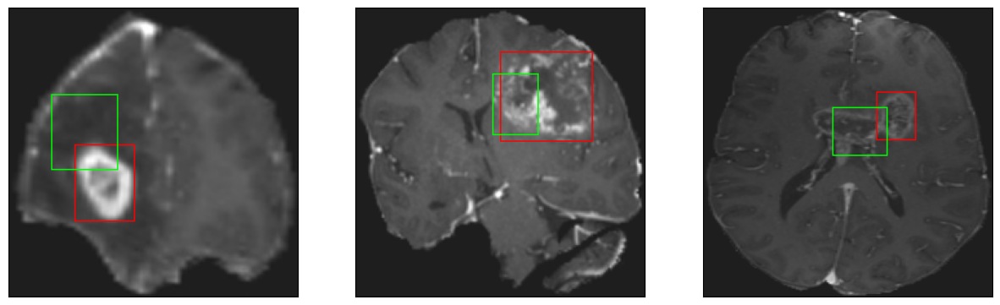

26/26 [==============================] - 3s 108ms/step - loss: 3.9903 - IoU: 0.6703 - val_loss: 12.8710 - val_IoU: 0.3556
Epoch 168/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0019 - IoU: 0.6701
Epoch 168: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


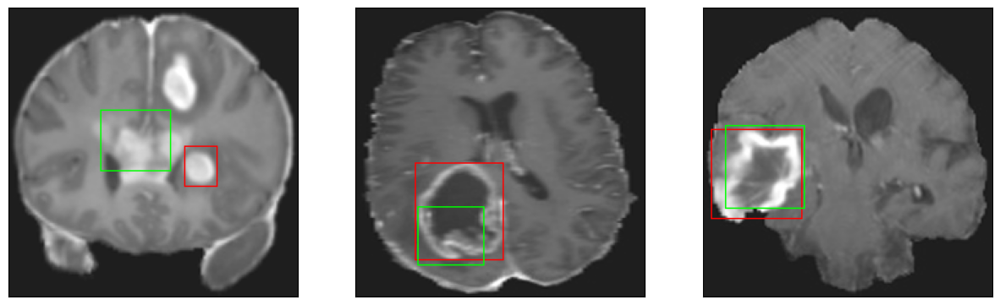

26/26 [==============================] - 2s 94ms/step - loss: 3.9546 - IoU: 0.6728 - val_loss: 12.5004 - val_IoU: 0.3815
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 3.9572 - IoU: 0.6695
Epoch 169: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


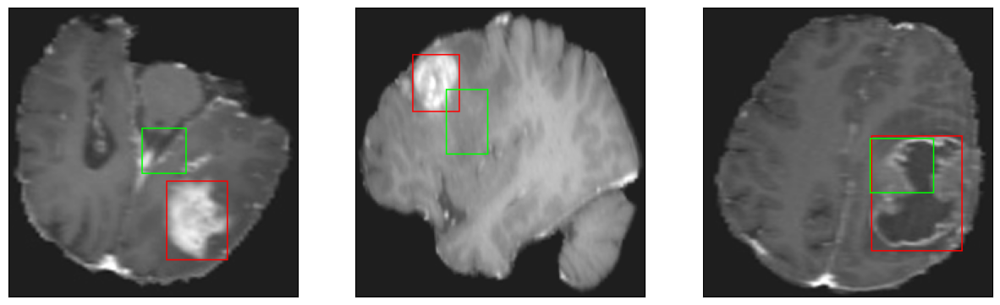

26/26 [==============================] - 3s 96ms/step - loss: 3.9572 - IoU: 0.6695 - val_loss: 12.3877 - val_IoU: 0.3857
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.1140 - IoU: 0.6687
Epoch 170: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


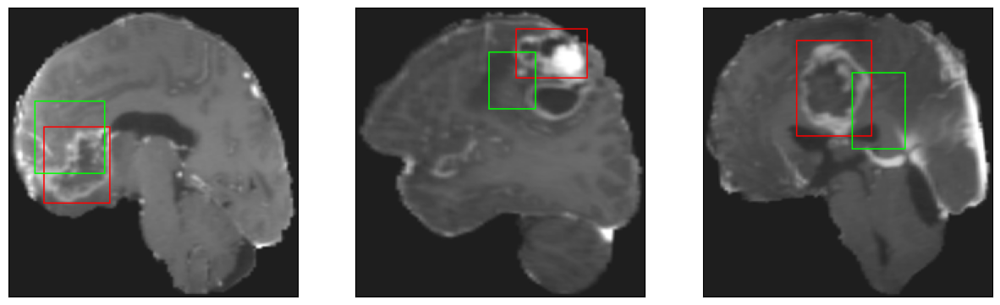

26/26 [==============================] - 2s 91ms/step - loss: 4.1140 - IoU: 0.6687 - val_loss: 12.2953 - val_IoU: 0.3812
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.2047 - IoU: 0.6601
Epoch 171: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


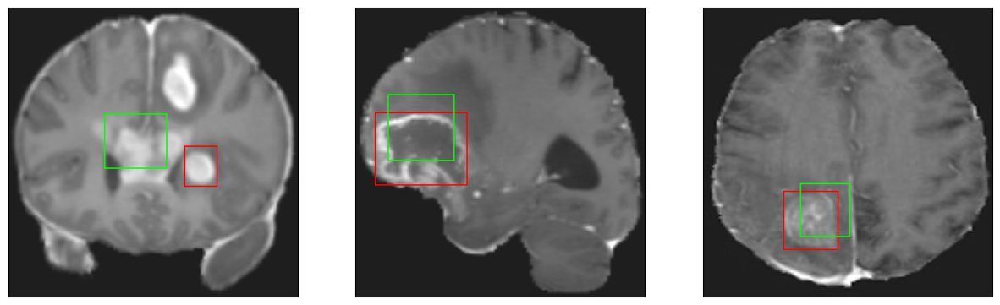

26/26 [==============================] - 2s 88ms/step - loss: 4.2047 - IoU: 0.6601 - val_loss: 12.6112 - val_IoU: 0.3698
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0762 - IoU: 0.6705
Epoch 172: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


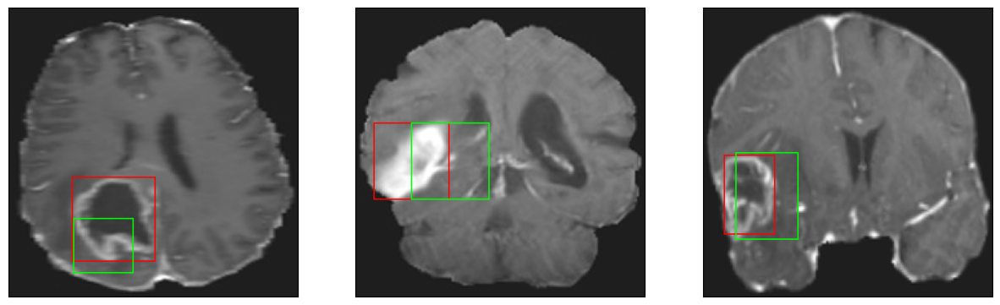

26/26 [==============================] - 3s 120ms/step - loss: 4.0802 - IoU: 0.6701 - val_loss: 13.3694 - val_IoU: 0.3371
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9027 - IoU: 0.6786
Epoch 173: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


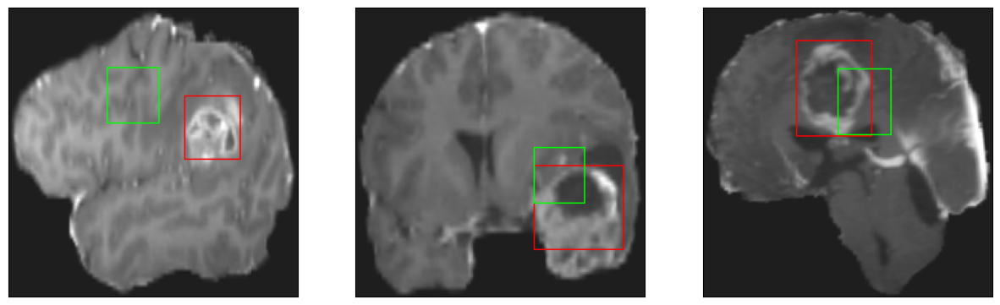

26/26 [==============================] - 3s 98ms/step - loss: 3.8994 - IoU: 0.6801 - val_loss: 13.8213 - val_IoU: 0.3220
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 3.8737 - IoU: 0.6870
Epoch 174: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


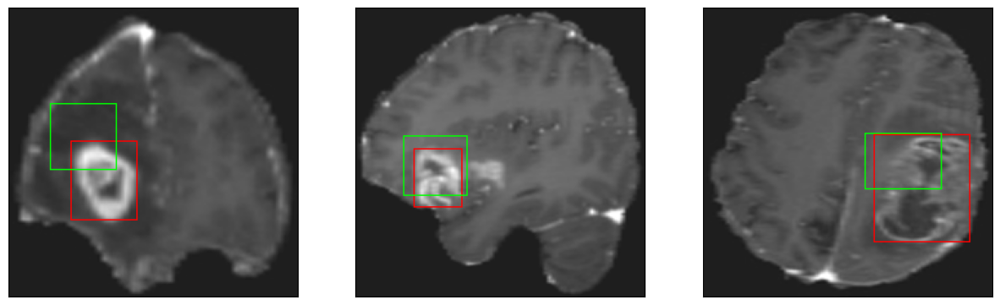

26/26 [==============================] - 3s 109ms/step - loss: 3.8737 - IoU: 0.6870 - val_loss: 14.2530 - val_IoU: 0.3064
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.0067 - IoU: 0.6729
Epoch 175: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


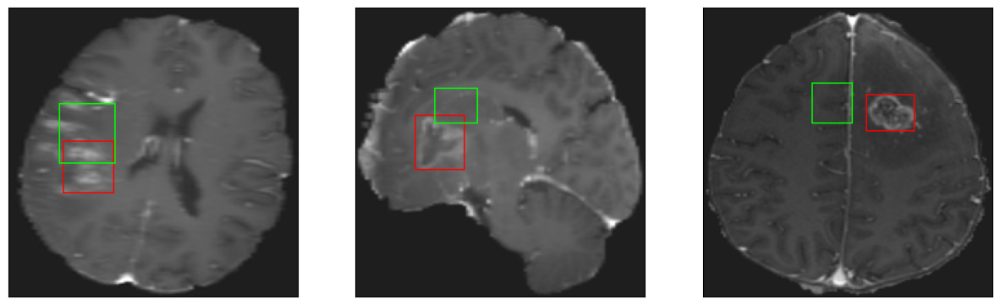

26/26 [==============================] - 2s 94ms/step - loss: 4.0067 - IoU: 0.6729 - val_loss: 15.9840 - val_IoU: 0.2267
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 3.8767 - IoU: 0.6795
Epoch 176: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


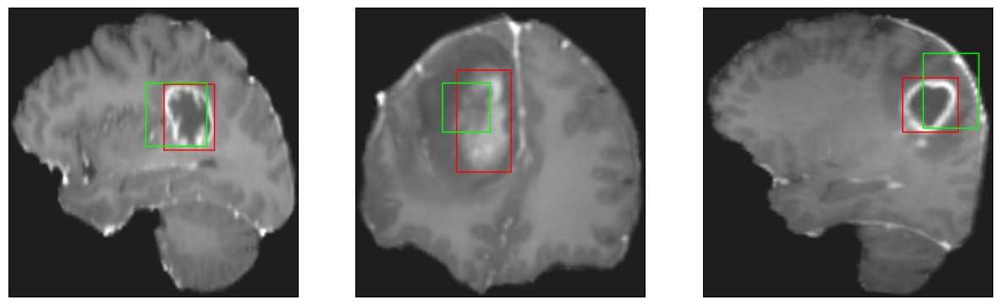

26/26 [==============================] - 3s 120ms/step - loss: 3.8767 - IoU: 0.6795 - val_loss: 13.4626 - val_IoU: 0.3402
Epoch 177/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8644 - IoU: 0.6808
Epoch 177: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


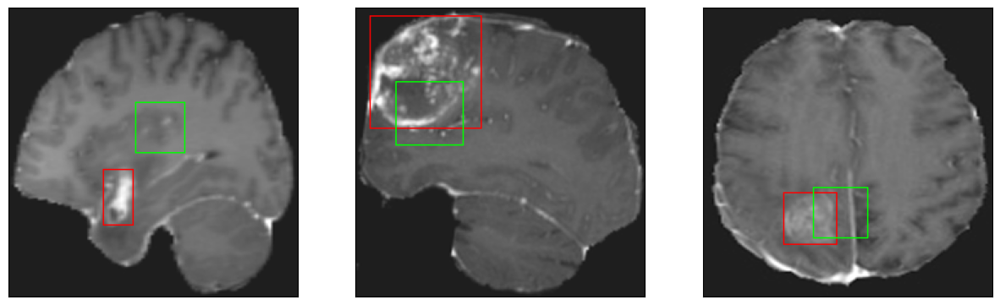

26/26 [==============================] - 2s 88ms/step - loss: 3.8780 - IoU: 0.6778 - val_loss: 12.7248 - val_IoU: 0.3640
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 3.9981 - IoU: 0.6688
Epoch 178: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


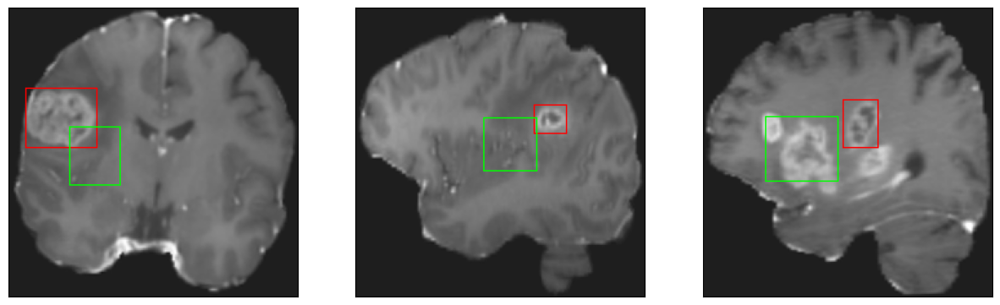

26/26 [==============================] - 2s 91ms/step - loss: 3.9981 - IoU: 0.6688 - val_loss: 12.3831 - val_IoU: 0.3868
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 3.9929 - IoU: 0.6720
Epoch 179: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


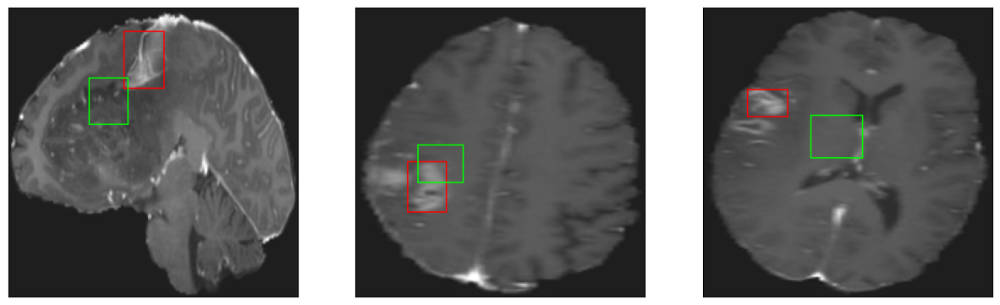

26/26 [==============================] - 2s 95ms/step - loss: 3.9929 - IoU: 0.6720 - val_loss: 14.7892 - val_IoU: 0.2690
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8696 - IoU: 0.6773
Epoch 180: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


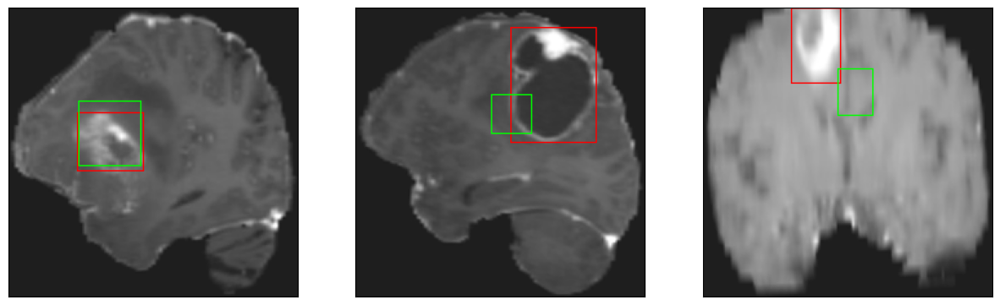

26/26 [==============================] - 3s 102ms/step - loss: 3.9282 - IoU: 0.6739 - val_loss: 12.4346 - val_IoU: 0.3792
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 3.8892 - IoU: 0.6795
Epoch 181: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


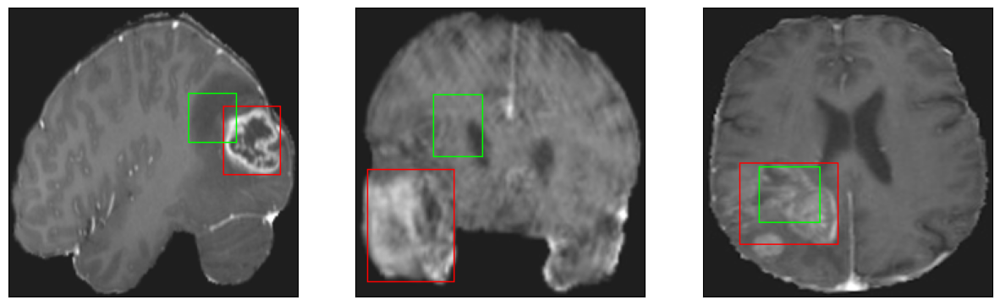

26/26 [==============================] - 3s 110ms/step - loss: 3.8892 - IoU: 0.6795 - val_loss: 14.3257 - val_IoU: 0.2903
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 4.2505 - IoU: 0.6493
Epoch 182: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


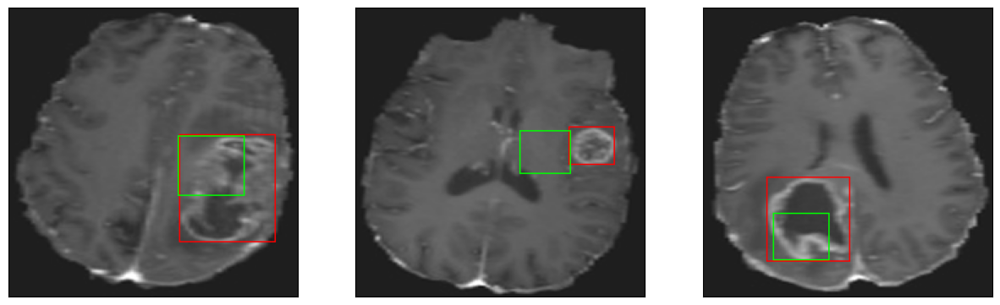

26/26 [==============================] - 2s 93ms/step - loss: 4.2505 - IoU: 0.6493 - val_loss: 13.1407 - val_IoU: 0.3466
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 4.2933 - IoU: 0.6488
Epoch 183: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


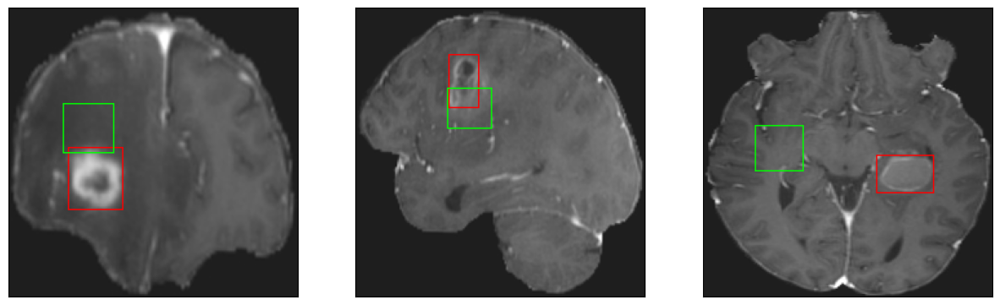

26/26 [==============================] - 3s 118ms/step - loss: 4.2933 - IoU: 0.6488 - val_loss: 15.2603 - val_IoU: 0.2600
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 3.8846 - IoU: 0.6791
Epoch 184: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


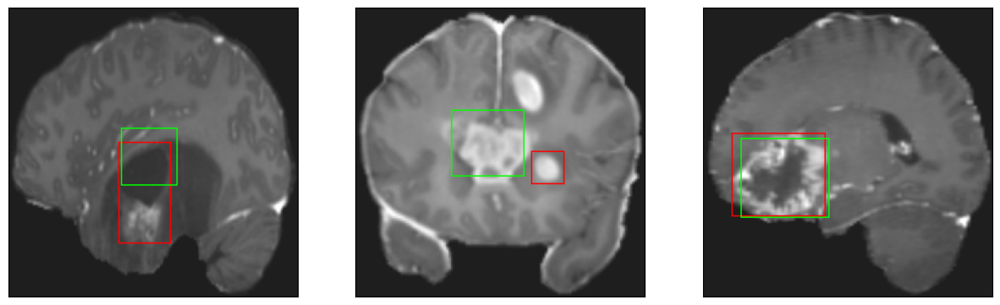

26/26 [==============================] - 3s 106ms/step - loss: 3.8846 - IoU: 0.6791 - val_loss: 12.7172 - val_IoU: 0.3855
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 3.8851 - IoU: 0.6776
Epoch 185: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


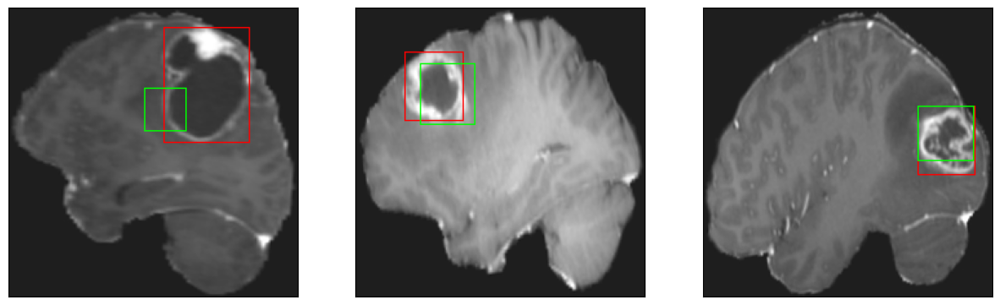

26/26 [==============================] - 3s 120ms/step - loss: 3.8851 - IoU: 0.6776 - val_loss: 12.7702 - val_IoU: 0.3583
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.0395 - IoU: 0.6664
Epoch 186: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


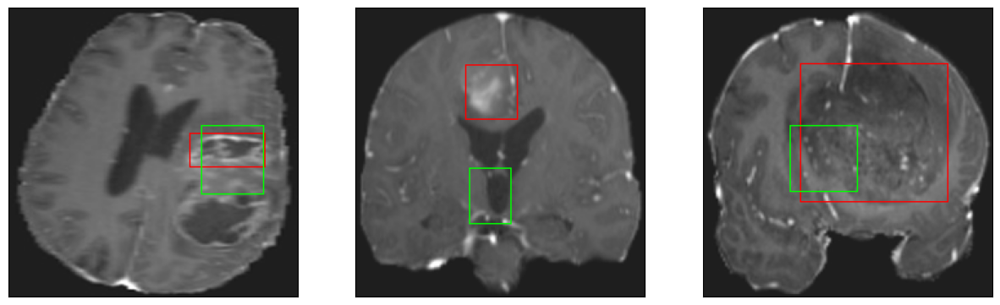

26/26 [==============================] - 3s 98ms/step - loss: 4.0395 - IoU: 0.6664 - val_loss: 12.6895 - val_IoU: 0.3691
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 3.8321 - IoU: 0.6781
Epoch 187: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


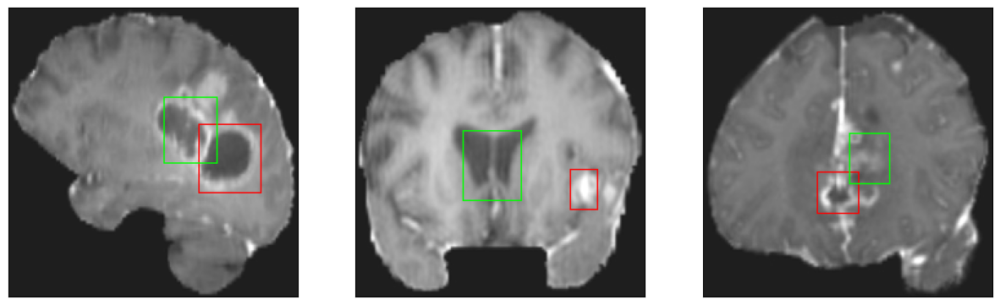

26/26 [==============================] - 2s 88ms/step - loss: 3.8321 - IoU: 0.6781 - val_loss: 12.2228 - val_IoU: 0.3886
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 4.1118 - IoU: 0.6687
Epoch 188: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


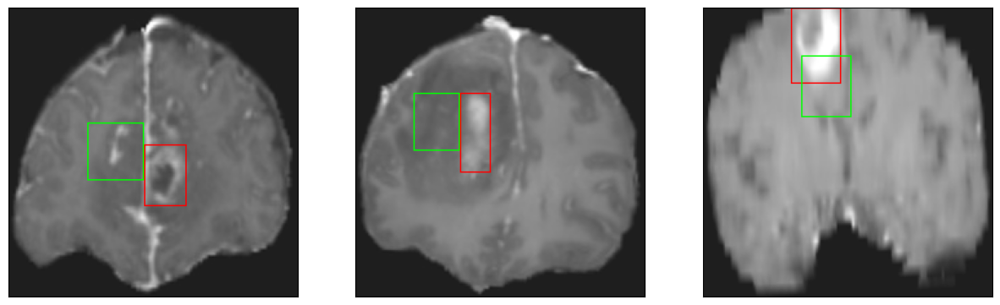

26/26 [==============================] - 2s 95ms/step - loss: 4.1118 - IoU: 0.6687 - val_loss: 13.5915 - val_IoU: 0.3543
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0978 - IoU: 0.6688
Epoch 189: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


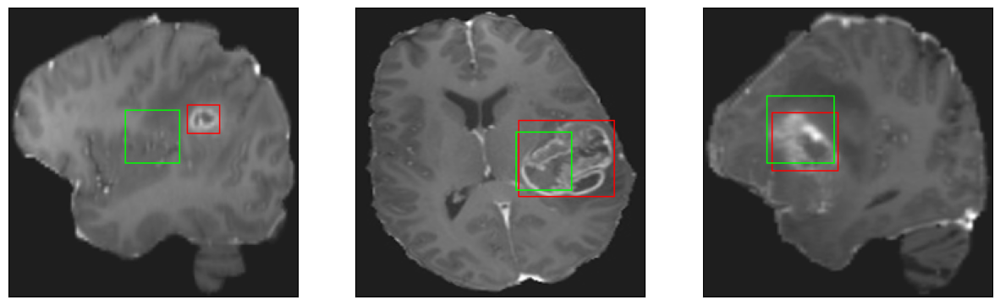

26/26 [==============================] - 3s 116ms/step - loss: 4.1134 - IoU: 0.6686 - val_loss: 12.6470 - val_IoU: 0.3762
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 4.0046 - IoU: 0.6796
Epoch 190: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


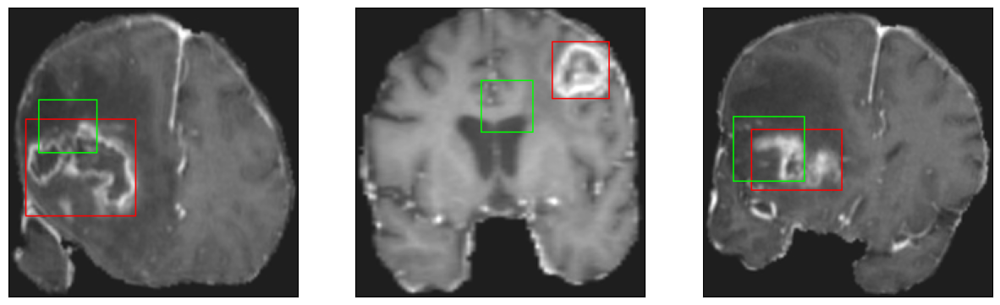

26/26 [==============================] - 3s 134ms/step - loss: 4.0046 - IoU: 0.6796 - val_loss: 15.2412 - val_IoU: 0.2543
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 3.8470 - IoU: 0.6837
Epoch 191: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


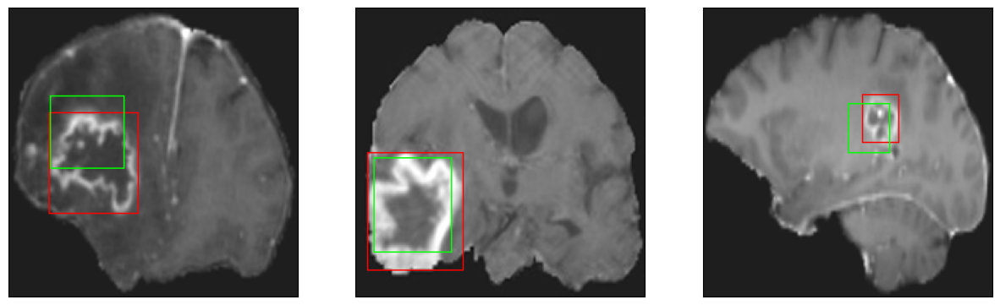

26/26 [==============================] - 3s 100ms/step - loss: 3.8470 - IoU: 0.6837 - val_loss: 12.4735 - val_IoU: 0.3757
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 3.7705 - IoU: 0.6819
Epoch 192: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


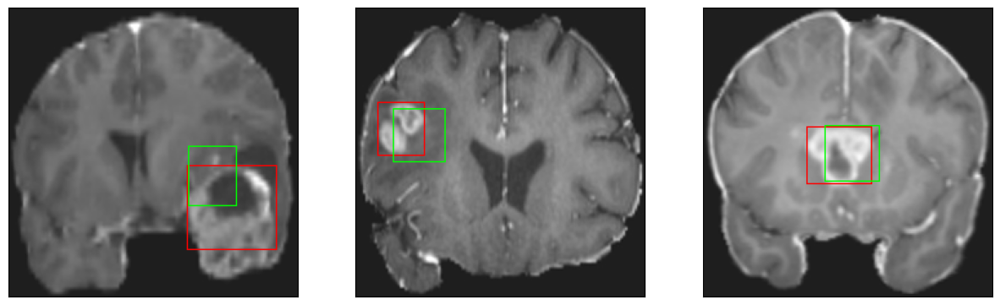

26/26 [==============================] - 3s 107ms/step - loss: 3.7705 - IoU: 0.6819 - val_loss: 12.5841 - val_IoU: 0.3729
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7778 - IoU: 0.6859
Epoch 193: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


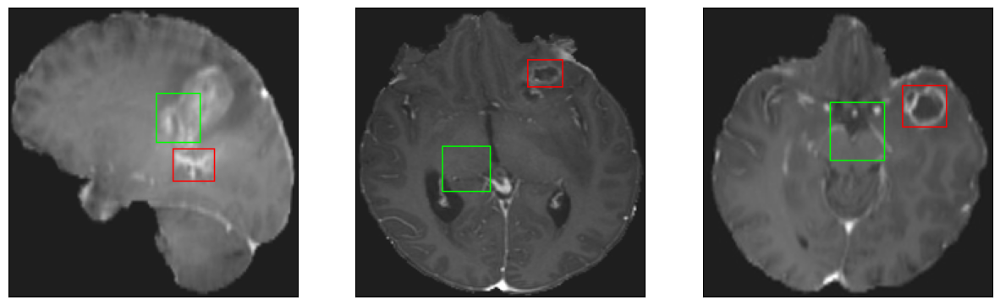

26/26 [==============================] - 3s 108ms/step - loss: 3.7719 - IoU: 0.6850 - val_loss: 12.4375 - val_IoU: 0.3729
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 3.7634 - IoU: 0.6904
Epoch 194: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


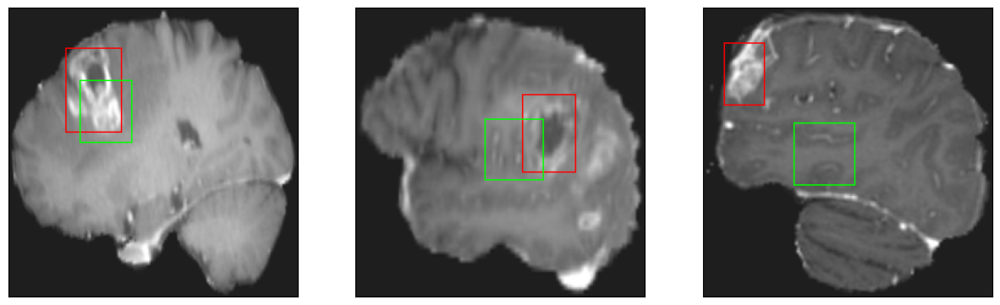

26/26 [==============================] - 3s 99ms/step - loss: 3.7634 - IoU: 0.6904 - val_loss: 13.3643 - val_IoU: 0.3363
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8645 - IoU: 0.6706
Epoch 195: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


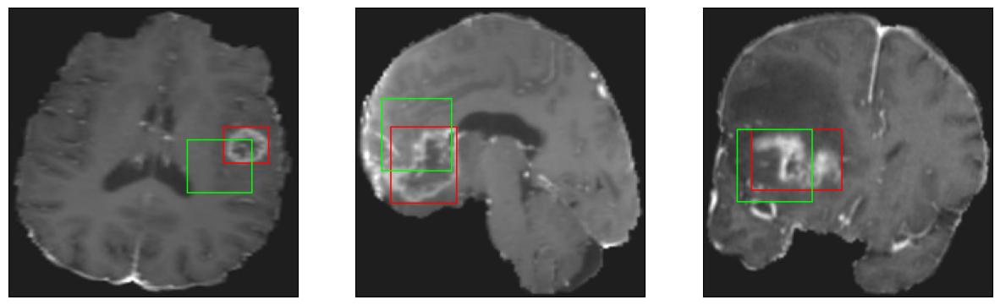

26/26 [==============================] - 2s 91ms/step - loss: 3.9623 - IoU: 0.6666 - val_loss: 12.5543 - val_IoU: 0.3793
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 3.7642 - IoU: 0.6826
Epoch 196: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


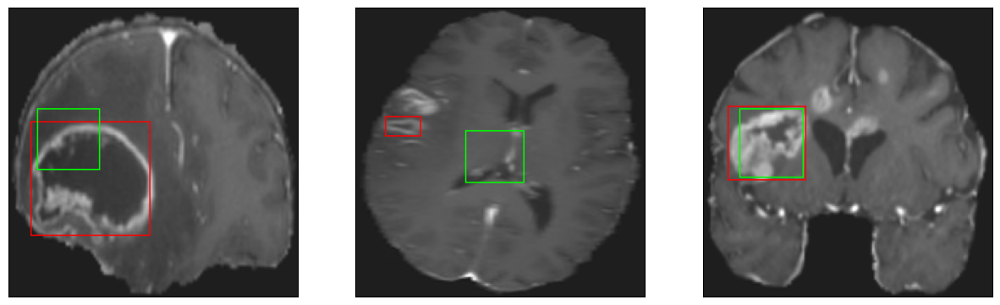

26/26 [==============================] - 2s 94ms/step - loss: 3.7642 - IoU: 0.6826 - val_loss: 12.8611 - val_IoU: 0.3539
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7603 - IoU: 0.6792
Epoch 197: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


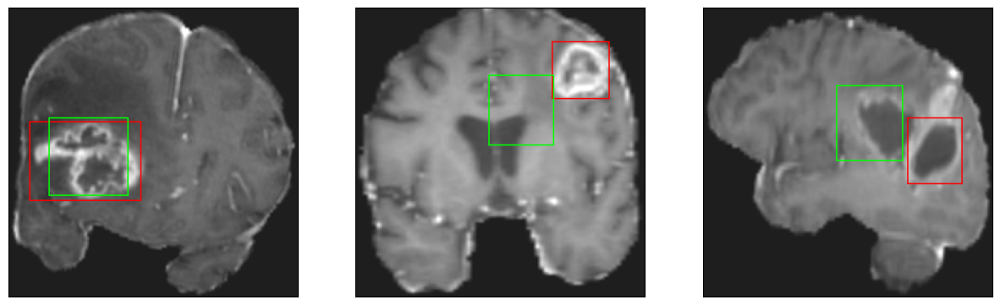

26/26 [==============================] - 2s 94ms/step - loss: 3.8166 - IoU: 0.6791 - val_loss: 13.9744 - val_IoU: 0.3280
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 3.8082 - IoU: 0.6836
Epoch 198: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 11ms/step
4


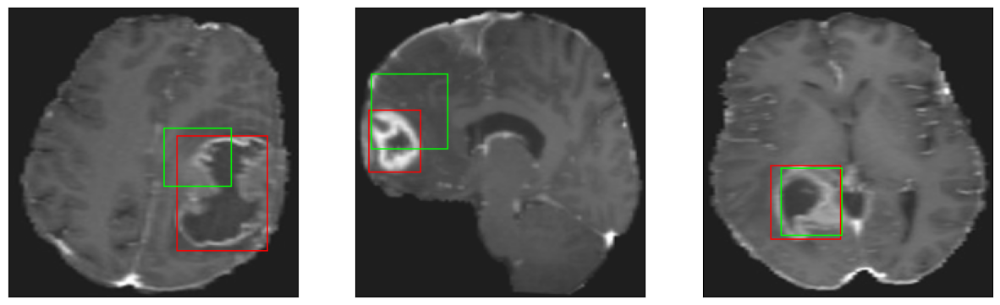

26/26 [==============================] - 3s 114ms/step - loss: 3.8082 - IoU: 0.6836 - val_loss: 13.8900 - val_IoU: 0.3462
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8130 - IoU: 0.6823
Epoch 199: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


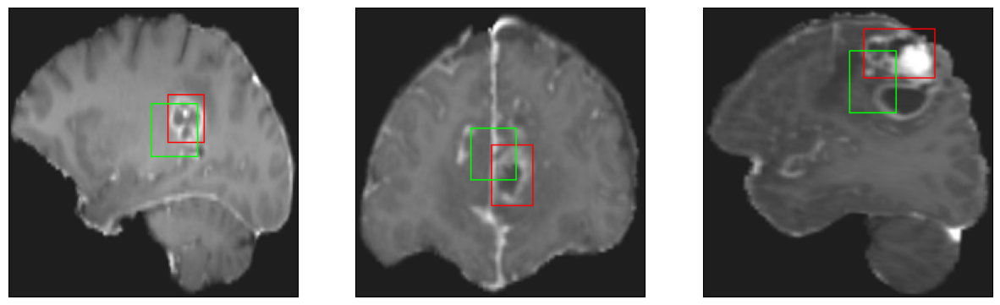

26/26 [==============================] - 3s 128ms/step - loss: 3.8140 - IoU: 0.6825 - val_loss: 12.5398 - val_IoU: 0.3814
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 3.6198 - IoU: 0.6943
Epoch 200: val_IoU did not improve from 0.39642
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


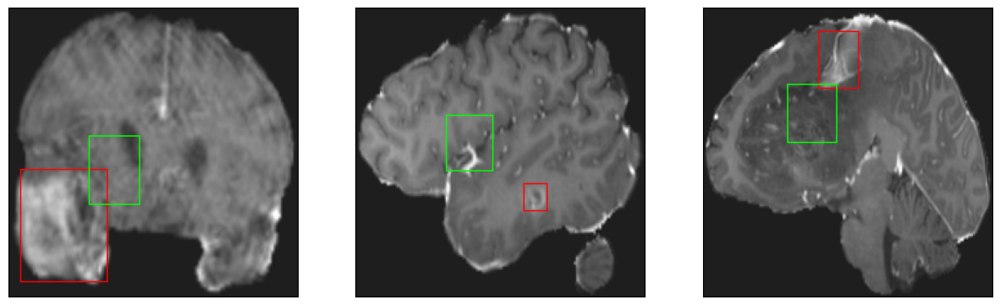

26/26 [==============================] - 3s 102ms/step - loss: 3.6198 - IoU: 0.6943 - val_loss: 12.5445 - val_IoU: 0.3746


In [ ]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

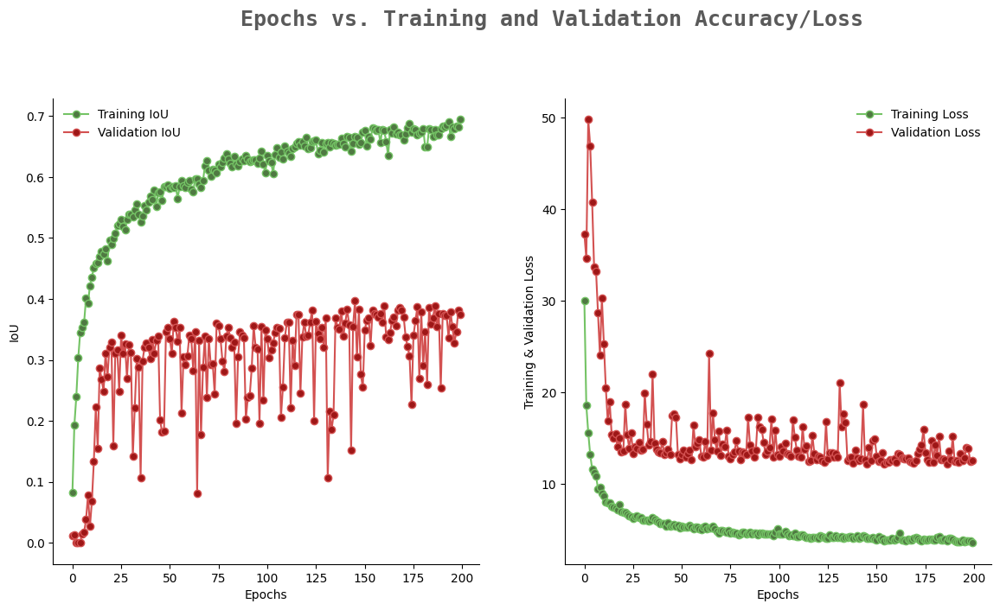

In [ ]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [ ]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [ ]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [ ]:
model.evaluate(test_dataset)

8/8 [==============================] - 0s 25ms/step - loss: 17.6077 - IoU: 0.2357


[17.6076602935791, 0.2357262521982193]